# Face Generation
In this project, you'll use generative adversarial networks to generate new images of faces.
### Get the Data
You'll be using two datasets in this project:
- MNIST
- CelebA

Since the celebA dataset is complex and you're doing GANs in a project for the first time, we want you to test your neural network on MNIST before CelebA.  Running the GANs on MNIST will allow you to see how well your model trains sooner.

If you're using [FloydHub](https://www.floydhub.com/), set `data_dir` to "/input" and use the [FloydHub data ID](http://docs.floydhub.com/home/using_datasets/) "R5KrjnANiKVhLWAkpXhNBe".

In [1]:
data_dir = './data'

# FloydHub - Use with data ID "R5KrjnANiKVhLWAkpXhNBe"
#data_dir = '/input'


"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
import helper

helper.download_extract('mnist', data_dir)
helper.download_extract('celeba', data_dir)

Found mnist Data
Found celeba Data


## Explore the Data
### MNIST
As you're aware, the [MNIST](http://yann.lecun.com/exdb/mnist/) dataset contains images of handwritten digits. You can view the first number of examples by changing `show_n_images`. 

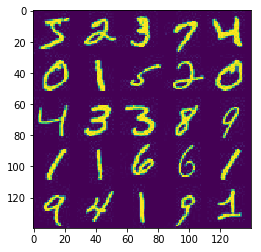

In [2]:
show_n_images = 25
data_dir = './data'

"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
%matplotlib inline
import helper
import os
from glob import glob
from matplotlib import pyplot
import numpy as np

mnist_images = helper.get_batch(glob(os.path.join(data_dir, 'mnist/*.jpg'))[:show_n_images], 28, 28, 'L')
pyplot.imshow(np.array(helper.images_square_grid(mnist_images, 'L')))

### CelebA
The [CelebFaces Attributes Dataset (CelebA)](http://mmlab.ie.cuhk.edu.hk/projects/CelebA.html) dataset contains over 200,000 celebrity images with annotations.  Since you're going to be generating faces, you won't need the annotations.  You can view the first number of examples by changing `show_n_images`.

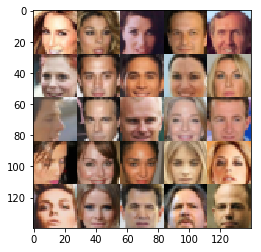

In [3]:
show_n_images = 25

"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
mnist_images = helper.get_batch(glob(os.path.join(data_dir, 'img_align_celeba/*.jpg'))[:show_n_images], 28, 28, 'RGB')
helper.images_square_grid(mnist_images, 'RGB')
pyplot.imshow(helper.images_square_grid(mnist_images, 'RGB'))

## Preprocess the Data
Since the project's main focus is on building the GANs, we'll preprocess the data for you.  The values of the MNIST and CelebA dataset will be in the range of -0.5 to 0.5 of 28x28 dimensional images.  The CelebA images will be cropped to remove parts of the image that don't include a face, then resized down to 28x28.

The MNIST images are black and white images with a single [color channel](https://en.wikipedia.org/wiki/Channel_(digital_image%29) while the CelebA images have [3 color channels (RGB color channel)](https://en.wikipedia.org/wiki/Channel_(digital_image%29#RGB_Images).
## Build the Neural Network
You'll build the components necessary to build a GANs by implementing the following functions below:
- `model_inputs`
- `discriminator`
- `generator`
- `model_loss`
- `model_opt`
- `train`

### Check the Version of TensorFlow and Access to GPU
This will check to make sure you have the correct version of TensorFlow and access to a GPU

In [4]:
"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
from distutils.version import LooseVersion
import warnings
import tensorflow as tf

# Check TensorFlow Version
assert LooseVersion(tf.__version__) >= LooseVersion('1.0'), 'Please use TensorFlow version 1.0 or newer.  You are using {}'.format(tf.__version__)
print('TensorFlow Version: {}'.format(tf.__version__))

# Check for a GPU
if not tf.test.gpu_device_name():
    warnings.warn('No GPU found. Please use a GPU to train your neural network.')
else:
    print('Default GPU Device: {}'.format(tf.test.gpu_device_name()))

/usr/local/lib/python3.6/importlib/_bootstrap.py:219: RuntimeWarning: compiletime version 3.5 of module 'tensorflow.python.framework.fast_tensor_util' does not match runtime version 3.6
  return f(*args, **kwds)
/usr/local/lib/python3.6/site-packages/h5py/__init__.py:36: FutureWarning: Conversion of the second argument of issubdtype from `float` to `np.floating` is deprecated. In future, it will be treated as `np.float64 == np.dtype(float).type`.
  from ._conv import register_converters as _register_converters


TensorFlow Version: 1.4.1
Default GPU Device: /device:GPU:0


### Input
Implement the `model_inputs` function to create TF Placeholders for the Neural Network. It should create the following placeholders:
- Real input images placeholder with rank 4 using `image_width`, `image_height`, and `image_channels`.
- Z input placeholder with rank 2 using `z_dim`.
- Learning rate placeholder with rank 0.

Return the placeholders in the following the tuple (tensor of real input images, tensor of z data)

In [5]:
import problem_unittests as tests

def model_inputs(image_width, image_height, image_channels, z_dim):
    """
    Create the model inputs
    :param image_width: The input image width
    :param image_height: The input image height
    :param image_channels: The number of image channels
    :param z_dim: The dimension of Z
    :return: Tuple of (tensor of real input images, tensor of z data, learning rate)
    """
    # TODO: Implement Function
    real_inputs = tf.placeholder(dtype=tf.float32, shape=(None, image_width, image_height, image_channels), name='real_input')
    z_inputs = tf.placeholder(dtype=tf.float32, shape=(None, z_dim), name='z_inputs')
    learning_rate = tf.placeholder(dtype=tf.float32, name='learning_rate')

    return real_inputs, z_inputs, learning_rate


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_model_inputs(model_inputs)

Tests Passed


### Discriminator
Implement `discriminator` to create a discriminator neural network that discriminates on `images`.  This function should be able to reuse the variables in the neural network.  Use [`tf.variable_scope`](https://www.tensorflow.org/api_docs/python/tf/variable_scope) with a scope name of "discriminator" to allow the variables to be reused.  The function should return a tuple of (tensor output of the discriminator, tensor logits of the discriminator).

In [6]:
def discriminator(images, reuse=False, alpha=0.2):
    """
    Create the discriminator network
    :param images: Tensor of input image(s)
    :param reuse: Boolean if the weights should be reused
    :return: Tuple of (tensor output of the discriminator, tensor logits of the discriminator)
    """
    # print("==discriminator structrue==")
    with tf.variable_scope('discriminator', reuse=reuse):        
        conv1 = tf.layers.conv2d(images, 32, 3, 2, 'SAME')
        lrelu1 = tf.maximum(alpha * conv1, conv1)
        # print(lrelu1.shape)
        
        conv2 = tf.layers.conv2d(lrelu1, 64, 3, 2, 'SAME')
        batch_norm2 = tf.layers.batch_normalization(conv2, training=True)
        lrelu2 = tf.maximum(alpha * batch_norm2, batch_norm2)
        # print(lrelu2.shape)
        
        conv3 = tf.layers.conv2d(lrelu2, 128, 3, 1, 'SAME')
        batch_norm3 = tf.layers.batch_normalization(conv3, training=True)
        lrelu3 = tf.maximum(alpha * batch_norm3, batch_norm3)
        # print(lrelu3.shape)
        
        features = tf.reduce_mean(lrelu3, (1, 2)) 
        # print(features.shape)
        # print()
        logits = tf.layers.dense(features, 1)
        
        out = tf.sigmoid(logits)
        
        return out, logits
        

"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_discriminator(discriminator, tf)

Tests Passed


### Generator
Implement `generator` to generate an image using `z`. This function should be able to reuse the variables in the neural network.  Use [`tf.variable_scope`](https://www.tensorflow.org/api_docs/python/tf/variable_scope) with a scope name of "generator" to allow the variables to be reused. The function should return the generated 28 x 28 x `out_channel_dim` images.

In [7]:
def generator(z, out_channel_dim, is_train=True, alpha=0.2):
    """
    Create the generator network
    :param z: Input z
    :param out_channel_dim: The number of channels in the output image
    :param is_train: Boolean if generator is being used for training
    :return: The tensor output of the generator
    """
    # print("==generator structrue==")
    with tf.variable_scope('generator', reuse=not is_train):
        x1 = tf.layers.dense(z, 7 * 7 * 512)
        
        x1 = tf.reshape(x1, (-1, 7, 7, 512))
        x1 = tf.layers.batch_normalization(x1, training=is_train)
        x1 = tf.maximum(alpha * x1, x1)
        # print(x1.shape)
        
        x2 = tf.layers.conv2d_transpose(x1, 256, 3, strides=1, padding='same', kernel_initializer=tf.contrib.layers.xavier_initializer())
        x2 = tf.layers.batch_normalization(x2, training=is_train)
        x2 = tf.maximum(alpha * x2, x2)
        # print(x2.shape)
        
        x3 = tf.layers.conv2d_transpose(x2, 128, 3, strides=1, padding='same', kernel_initializer=tf.contrib.layers.xavier_initializer())
        x3 = tf.layers.batch_normalization(x3, training=is_train)
        x3 = tf.maximum(alpha * x3, x3)
        # print(x3.shape)
        
        x4 = tf.layers.conv2d_transpose(x3, 64, 3, strides=2, padding='same', kernel_initializer=tf.contrib.layers.xavier_initializer())
        x4 = tf.layers.batch_normalization(x4, training=is_train)
        x4 = tf.maximum(alpha * x4, x4)
        # print(x4.shape)
        
        # Output layer
        logits = tf.layers.conv2d_transpose(x4, out_channel_dim, 3, strides=2, padding='same')
        # print(logits.shape)
        # print()
        
        out = tf.tanh(logits)
        
        return out


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_generator(generator, tf)

Tests Passed


### Loss
Implement `model_loss` to build the GANs for training and calculate the loss.  The function should return a tuple of (discriminator loss, generator loss).  Use the following functions you implemented:
- `discriminator(images, reuse=False)`
- `generator(z, out_channel_dim, is_train=True)`

In [8]:
def model_loss(input_real, input_z, out_channel_dim):
    """
    Get the loss for the discriminator and generator
    :param input_real: Images from the real dataset
    :param input_z: Z input
    :param out_channel_dim: The number of channels in the output image
    :return: A tuple of (discriminator loss, generator loss)
    """
    g_model = generator(input_z, out_channel_dim)
    d_model_real, d_logits_real = discriminator(input_real)
    d_model_fake, d_logits_fake = discriminator(g_model, reuse=True)
    
    d_loss_real = tf.reduce_mean(
                      tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_real, 
                                                              labels=tf.ones_like(d_logits_real) * 0.9))
    d_loss_fake = tf.reduce_mean(
                      tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, 
                                                              labels=tf.zeros_like(d_logits_real)))
    d_loss = d_loss_real + d_loss_fake

    g_loss = tf.reduce_mean(
                 tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake,
                                                         labels=tf.ones_like(d_logits_fake)))
    
    return d_loss, g_loss


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_model_loss(model_loss)

Tests Passed


### Optimization
Implement `model_opt` to create the optimization operations for the GANs. Use [`tf.trainable_variables`](https://www.tensorflow.org/api_docs/python/tf/trainable_variables) to get all the trainable variables.  Filter the variables with names that are in the discriminator and generator scope names.  The function should return a tuple of (discriminator training operation, generator training operation).

In [9]:
def model_opt(d_loss, g_loss, learning_rate, beta1):
    """
    Get optimization operations
    :param d_loss: Discriminator loss Tensor
    :param g_loss: Generator loss Tensor
    :param learning_rate: Learning Rate Placeholder
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :return: A tuple of (discriminator training operation, generator training operation)
    """
    t_vars = tf.trainable_variables()
    d_vars = [var for var in t_vars if var.name.startswith('discriminator')]
    g_vars = [var for var in t_vars if var.name.startswith('generator')]
    
    d_train_opt = tf.train.AdamOptimizer(
        learning_rate, beta1=beta1).minimize(d_loss, var_list=d_vars)
    
    ops = tf.get_collection(tf.GraphKeys.UPDATE_OPS)
    g_updates = [opt for opt in ops if opt.name.startswith('generator')]
    with tf.control_dependencies(g_updates):
        g_train_opt = tf.train.AdamOptimizer(
            learning_rate, beta1).minimize(g_loss, var_list=g_vars)
        
    return d_train_opt, g_train_opt


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_model_opt(model_opt, tf)

Tests Passed


## Neural Network Training
### Show Output
Use this function to show the current output of the generator during training. It will help you determine how well the GANs is training.

In [10]:
"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
import numpy as np

def show_generator_output(sess, n_images, input_z, out_channel_dim, image_mode):
    """
    Show example output for the generator
    :param sess: TensorFlow session
    :param n_images: Number of Images to display
    :param input_z: Input Z Tensor
    :param out_channel_dim: The number of channels in the output image
    :param image_mode: The mode to use for images ("RGB" or "L")
    """
    cmap = None if image_mode == 'RGB' else 'gray'
    z_dim = input_z.get_shape().as_list()[-1]
    example_z = np.random.uniform(-1, 1, size=[n_images, z_dim])

    samples = sess.run(
        generator(input_z, out_channel_dim, False),
        feed_dict={input_z: example_z})

    if cmap == 'gray':
        pyplot.imshow(np.array(helper.images_square_grid(samples, image_mode)))
        pyplot.show()
    else:
        images_grid = helper.images_square_grid(samples, image_mode)
        pyplot.imshow(images_grid, cmap=cmap)
        pyplot.show()

### Train
Implement `train` to build and train the GANs.  Use the following functions you implemented:
- `model_inputs(image_width, image_height, image_channels, z_dim)`
- `model_loss(input_real, input_z, out_channel_dim)`
- `model_opt(d_loss, g_loss, learning_rate, beta1)`

Use the `show_generator_output` to show `generator` output while you train. Running `show_generator_output` for every batch will drastically increase training time and increase the size of the notebook.  It's recommended to print the `generator` output every 100 batches.

In [11]:
def train(epoch_count, batch_size, z_dim, learning_rate, beta1, get_batches, data_shape, data_image_mode):
    """
    Train the GAN
    :param epoch_count: Number of epochs
    :param batch_size: Batch Size
    :param z_dim: Z dimension
    :param learning_rate: Learning Rate
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :param get_batches: Function to get batches
    :param data_shape: Shape of the data
    :param data_image_mode: The image mode to use for images ("RGB" or "L")
    """
    # build model
    input_real, input_z, _ = model_inputs(data_shape[1], data_shape[2], data_shape[3], z_dim)
    d_loss, g_loss = model_loss(input_real, input_z, data_shape[3])
    d_opt, g_opt = model_opt(d_loss, g_loss, learning_rate, beta1)
    
    steps = 0
    losses = []
    with tf.Session() as sess:
        sess.run(tf.global_variables_initializer())
        for epoch_i in range(epoch_count):
            for batch_images in get_batches(batch_size):
                # TODO: Train Model
                batch_images *= 2
                steps += 1
                batch_z = np.random.uniform(-1, 1, size=(batch_size, z_dim))
                
                _ = sess.run(d_opt, feed_dict={input_real: batch_images, input_z: batch_z})
                _ = sess.run(g_opt, feed_dict={input_z: batch_z})
                
                if steps % 10 == 0:
                    # At the end of every 10 epochs, get the losses and print them out
                    train_loss_d = d_loss.eval({input_z: batch_z, input_real: batch_images})
                    train_loss_g = g_loss.eval({input_z: batch_z})

                    print("Epoch {}/{}...".format(epoch_i+1, epochs),
                          "Discriminator Loss: {:.4f}...".format(train_loss_d),
                          "Generator Loss: {:.4f}".format(train_loss_g))
                    losses.append((train_loss_d, train_loss_g))
                
                if steps % 100 == 0:
                    show_generator_output(sess, 25, input_z, data_shape[3], data_image_mode)
        return losses

### MNIST
Test your GANs architecture on MNIST.  After 2 epochs, the GANs should be able to generate images that look like handwritten digits.  Make sure the loss of the generator is lower than the loss of the discriminator or close to 0.

Epoch 1/2... Discriminator Loss: 1.2982... Generator Loss: 0.6907
Epoch 1/2... Discriminator Loss: 1.3219... Generator Loss: 0.8063
Epoch 1/2... Discriminator Loss: 1.3368... Generator Loss: 0.8252
Epoch 1/2... Discriminator Loss: 1.3449... Generator Loss: 0.8178
Epoch 1/2... Discriminator Loss: 1.3491... Generator Loss: 0.8076
Epoch 1/2... Discriminator Loss: 1.3522... Generator Loss: 0.7830
Epoch 1/2... Discriminator Loss: 1.3571... Generator Loss: 0.7813
Epoch 1/2... Discriminator Loss: 1.3564... Generator Loss: 0.7837
Epoch 1/2... Discriminator Loss: 1.3450... Generator Loss: 0.7864
Epoch 1/2... Discriminator Loss: 1.3386... Generator Loss: 0.8198


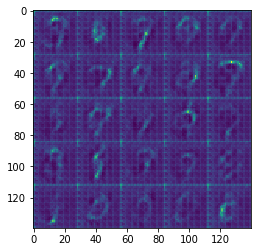

Epoch 1/2... Discriminator Loss: 1.3397... Generator Loss: 0.8069
Epoch 1/2... Discriminator Loss: 1.3467... Generator Loss: 0.7949
Epoch 1/2... Discriminator Loss: 1.3477... Generator Loss: 0.7947
Epoch 1/2... Discriminator Loss: 1.3542... Generator Loss: 0.7675
Epoch 1/2... Discriminator Loss: 1.3389... Generator Loss: 0.8057
Epoch 1/2... Discriminator Loss: 1.3401... Generator Loss: 0.7847
Epoch 1/2... Discriminator Loss: 1.3409... Generator Loss: 0.7763
Epoch 1/2... Discriminator Loss: 1.3423... Generator Loss: 0.7930
Epoch 1/2... Discriminator Loss: 1.3435... Generator Loss: 0.7691
Epoch 1/2... Discriminator Loss: 1.3512... Generator Loss: 0.7950


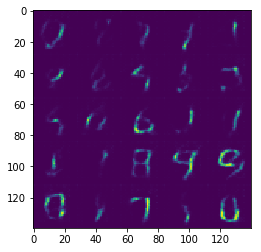

Epoch 1/2... Discriminator Loss: 1.3450... Generator Loss: 0.8017
Epoch 1/2... Discriminator Loss: 1.3584... Generator Loss: 0.7863
Epoch 1/2... Discriminator Loss: 1.3505... Generator Loss: 0.7747
Epoch 1/2... Discriminator Loss: 1.3314... Generator Loss: 0.8296
Epoch 1/2... Discriminator Loss: 1.3495... Generator Loss: 0.7626
Epoch 1/2... Discriminator Loss: 1.3377... Generator Loss: 0.8015
Epoch 1/2... Discriminator Loss: 1.3499... Generator Loss: 0.8207
Epoch 1/2... Discriminator Loss: 1.3513... Generator Loss: 0.7950
Epoch 1/2... Discriminator Loss: 1.3429... Generator Loss: 0.8058
Epoch 1/2... Discriminator Loss: 1.3332... Generator Loss: 0.8074


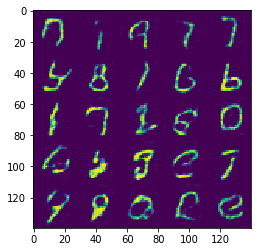

Epoch 1/2... Discriminator Loss: 1.3386... Generator Loss: 0.7856
Epoch 1/2... Discriminator Loss: 1.3339... Generator Loss: 0.8027
Epoch 1/2... Discriminator Loss: 1.3187... Generator Loss: 0.7937
Epoch 1/2... Discriminator Loss: 1.3304... Generator Loss: 0.8209
Epoch 1/2... Discriminator Loss: 1.3227... Generator Loss: 0.7902
Epoch 1/2... Discriminator Loss: 1.3327... Generator Loss: 0.8145
Epoch 1/2... Discriminator Loss: 1.3247... Generator Loss: 0.8132
Epoch 1/2... Discriminator Loss: 1.3252... Generator Loss: 0.7961
Epoch 1/2... Discriminator Loss: 1.3189... Generator Loss: 0.7886
Epoch 1/2... Discriminator Loss: 1.3364... Generator Loss: 0.8878


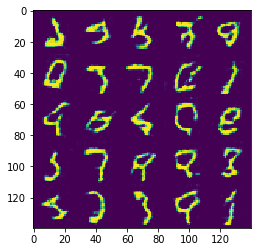

Epoch 1/2... Discriminator Loss: 1.3103... Generator Loss: 0.8339
Epoch 1/2... Discriminator Loss: 1.2941... Generator Loss: 0.8507
Epoch 1/2... Discriminator Loss: 1.2956... Generator Loss: 0.8513
Epoch 1/2... Discriminator Loss: 1.3234... Generator Loss: 0.8296
Epoch 1/2... Discriminator Loss: 1.3107... Generator Loss: 0.8291
Epoch 1/2... Discriminator Loss: 1.2871... Generator Loss: 0.8723
Epoch 2/2... Discriminator Loss: 1.3156... Generator Loss: 0.8084
Epoch 2/2... Discriminator Loss: 1.3224... Generator Loss: 0.7881
Epoch 2/2... Discriminator Loss: 1.2865... Generator Loss: 0.7982
Epoch 2/2... Discriminator Loss: 1.2778... Generator Loss: 0.8410


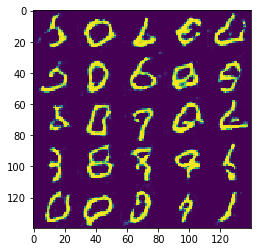

Epoch 2/2... Discriminator Loss: 1.2724... Generator Loss: 0.8573
Epoch 2/2... Discriminator Loss: 1.2673... Generator Loss: 0.8540
Epoch 2/2... Discriminator Loss: 1.2924... Generator Loss: 0.8949
Epoch 2/2... Discriminator Loss: 1.2435... Generator Loss: 0.8957
Epoch 2/2... Discriminator Loss: 1.2939... Generator Loss: 0.7934
Epoch 2/2... Discriminator Loss: 1.2884... Generator Loss: 0.7933
Epoch 2/2... Discriminator Loss: 1.2448... Generator Loss: 0.8560
Epoch 2/2... Discriminator Loss: 1.2662... Generator Loss: 0.8161
Epoch 2/2... Discriminator Loss: 1.2405... Generator Loss: 0.9080
Epoch 2/2... Discriminator Loss: 1.2298... Generator Loss: 0.9040


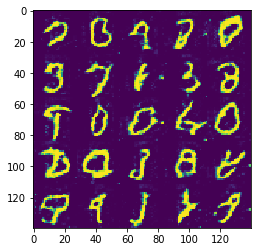

Epoch 2/2... Discriminator Loss: 1.2432... Generator Loss: 0.9029
Epoch 2/2... Discriminator Loss: 1.2457... Generator Loss: 0.9056
Epoch 2/2... Discriminator Loss: 1.2458... Generator Loss: 0.8450
Epoch 2/2... Discriminator Loss: 1.2370... Generator Loss: 0.8878
Epoch 2/2... Discriminator Loss: 1.2339... Generator Loss: 0.7866
Epoch 2/2... Discriminator Loss: 1.2002... Generator Loss: 0.9493
Epoch 2/2... Discriminator Loss: 1.2327... Generator Loss: 0.8615
Epoch 2/2... Discriminator Loss: 1.2370... Generator Loss: 0.9053
Epoch 2/2... Discriminator Loss: 1.2069... Generator Loss: 0.8275
Epoch 2/2... Discriminator Loss: 1.1975... Generator Loss: 0.8665


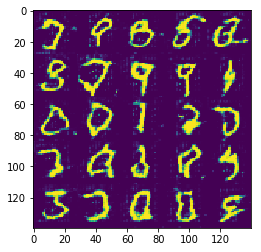

Epoch 2/2... Discriminator Loss: 1.2084... Generator Loss: 0.8695
Epoch 2/2... Discriminator Loss: 1.2274... Generator Loss: 0.8328
Epoch 2/2... Discriminator Loss: 1.2861... Generator Loss: 0.8626
Epoch 2/2... Discriminator Loss: 1.1867... Generator Loss: 0.9138
Epoch 2/2... Discriminator Loss: 1.1624... Generator Loss: 0.9345
Epoch 2/2... Discriminator Loss: 1.2120... Generator Loss: 0.8234
Epoch 2/2... Discriminator Loss: 1.2000... Generator Loss: 0.9380
Epoch 2/2... Discriminator Loss: 1.1684... Generator Loss: 0.8673
Epoch 2/2... Discriminator Loss: 1.2067... Generator Loss: 0.8011
Epoch 2/2... Discriminator Loss: 1.1910... Generator Loss: 0.9255


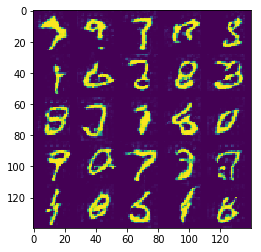

Epoch 2/2... Discriminator Loss: 1.2131... Generator Loss: 0.7726
Epoch 2/2... Discriminator Loss: 1.2638... Generator Loss: 0.7931
Epoch 2/2... Discriminator Loss: 1.1763... Generator Loss: 0.8145
Epoch 2/2... Discriminator Loss: 1.2196... Generator Loss: 0.9508
Epoch 2/2... Discriminator Loss: 1.2480... Generator Loss: 0.9262
Epoch 2/2... Discriminator Loss: 1.1641... Generator Loss: 0.8571
Epoch 2/2... Discriminator Loss: 1.1679... Generator Loss: 0.8989
Epoch 2/2... Discriminator Loss: 1.1507... Generator Loss: 1.0425
Epoch 2/2... Discriminator Loss: 1.2142... Generator Loss: 0.8419
Epoch 2/2... Discriminator Loss: 1.1532... Generator Loss: 0.9188


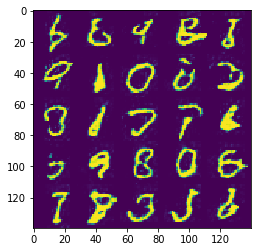

Epoch 2/2... Discriminator Loss: 1.2351... Generator Loss: 0.9089
Epoch 2/2... Discriminator Loss: 1.1948... Generator Loss: 0.8859
Epoch 2/2... Discriminator Loss: 1.0539... Generator Loss: 1.0271


In [13]:
batch_size = 128
z_dim = 128
learning_rate = 0.001
beta1 = 0.5


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
epochs = 2

mnist_dataset = helper.Dataset('mnist', glob(os.path.join(data_dir, 'mnist/*.jpg')))
with tf.Graph().as_default():
    losses = train(epochs, batch_size, z_dim, learning_rate, beta1, mnist_dataset.get_batches,
          mnist_dataset.shape, mnist_dataset.image_mode)

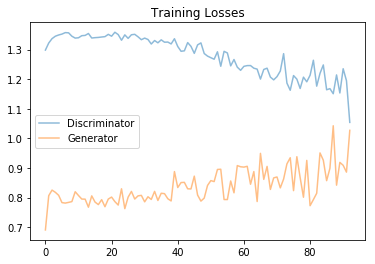

In [14]:
from matplotlib import pyplot as plt
fig, ax = plt.subplots()
losses = np.array(losses)
plt.plot(losses.T[0], label='Discriminator', alpha=0.5)
plt.plot(losses.T[1], label='Generator', alpha=0.5)
plt.title("Training Losses")
plt.legend()

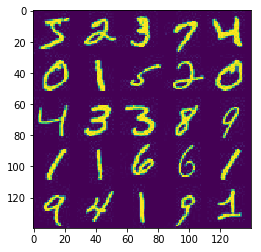

In [15]:
mnist_images = helper.get_batch(glob(os.path.join(data_dir, 'mnist/*.jpg'))[:show_n_images], 28, 28, 'L')
pyplot.imshow(np.array(helper.images_square_grid(mnist_images, 'L')))

### CelebA
Run your GANs on CelebA.  It will take around 20 minutes on the average GPU to run one epoch.  You can run the whole epoch or stop when it starts to generate realistic faces.

Epoch 1/10... Discriminator Loss: 1.3181... Generator Loss: 0.7756
Epoch 1/10... Discriminator Loss: 1.2662... Generator Loss: 0.8238
Epoch 1/10... Discriminator Loss: 1.3612... Generator Loss: 0.7925
Epoch 1/10... Discriminator Loss: 1.3688... Generator Loss: 0.8120
Epoch 1/10... Discriminator Loss: 1.3978... Generator Loss: 0.7938
Epoch 1/10... Discriminator Loss: 1.3824... Generator Loss: 0.7857
Epoch 1/10... Discriminator Loss: 1.3900... Generator Loss: 0.7699
Epoch 1/10... Discriminator Loss: 1.3851... Generator Loss: 0.7877
Epoch 1/10... Discriminator Loss: 1.3667... Generator Loss: 0.7999
Epoch 1/10... Discriminator Loss: 1.3696... Generator Loss: 0.7737


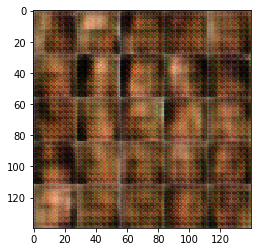

Epoch 1/10... Discriminator Loss: 1.3679... Generator Loss: 0.7994
Epoch 1/10... Discriminator Loss: 1.3865... Generator Loss: 0.7775
Epoch 1/10... Discriminator Loss: 1.3601... Generator Loss: 0.7991
Epoch 1/10... Discriminator Loss: 1.3620... Generator Loss: 0.7916
Epoch 1/10... Discriminator Loss: 1.3717... Generator Loss: 0.7843
Epoch 1/10... Discriminator Loss: 1.3822... Generator Loss: 0.7796
Epoch 1/10... Discriminator Loss: 1.3773... Generator Loss: 0.7962
Epoch 1/10... Discriminator Loss: 1.3628... Generator Loss: 0.7736
Epoch 1/10... Discriminator Loss: 1.3736... Generator Loss: 0.8042
Epoch 1/10... Discriminator Loss: 1.3706... Generator Loss: 0.7826


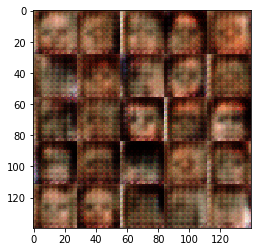

Epoch 1/10... Discriminator Loss: 1.4032... Generator Loss: 0.7581
Epoch 1/10... Discriminator Loss: 1.3911... Generator Loss: 0.7711
Epoch 1/10... Discriminator Loss: 1.3859... Generator Loss: 0.8022
Epoch 1/10... Discriminator Loss: 1.3759... Generator Loss: 0.7742
Epoch 1/10... Discriminator Loss: 1.3461... Generator Loss: 0.8059
Epoch 1/10... Discriminator Loss: 1.3890... Generator Loss: 0.7730
Epoch 1/10... Discriminator Loss: 1.3376... Generator Loss: 0.7976
Epoch 1/10... Discriminator Loss: 1.3686... Generator Loss: 0.7686
Epoch 1/10... Discriminator Loss: 1.4175... Generator Loss: 0.7454
Epoch 1/10... Discriminator Loss: 1.3748... Generator Loss: 0.7649


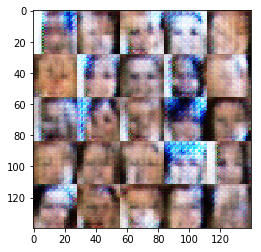

Epoch 1/10... Discriminator Loss: 1.3292... Generator Loss: 0.7783
Epoch 1/10... Discriminator Loss: 1.3837... Generator Loss: 0.7649
Epoch 1/10... Discriminator Loss: 1.3556... Generator Loss: 0.7932
Epoch 1/10... Discriminator Loss: 1.3735... Generator Loss: 0.7836
Epoch 1/10... Discriminator Loss: 1.3598... Generator Loss: 0.8221
Epoch 1/10... Discriminator Loss: 1.3366... Generator Loss: 0.8038
Epoch 1/10... Discriminator Loss: 1.3554... Generator Loss: 0.7916
Epoch 1/10... Discriminator Loss: 1.3605... Generator Loss: 0.8116
Epoch 1/10... Discriminator Loss: 1.3668... Generator Loss: 0.8058
Epoch 1/10... Discriminator Loss: 1.3948... Generator Loss: 0.7755


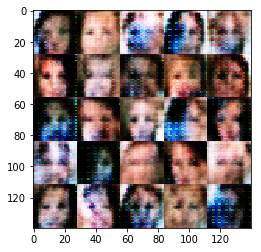

Epoch 1/10... Discriminator Loss: 1.3450... Generator Loss: 0.7930
Epoch 1/10... Discriminator Loss: 1.3657... Generator Loss: 0.7838
Epoch 1/10... Discriminator Loss: 1.3942... Generator Loss: 0.7661
Epoch 1/10... Discriminator Loss: 1.3458... Generator Loss: 0.7821
Epoch 1/10... Discriminator Loss: 1.3885... Generator Loss: 0.7847
Epoch 1/10... Discriminator Loss: 1.3980... Generator Loss: 0.7859
Epoch 1/10... Discriminator Loss: 1.3745... Generator Loss: 0.7705
Epoch 1/10... Discriminator Loss: 1.3482... Generator Loss: 0.8087
Epoch 1/10... Discriminator Loss: 1.3756... Generator Loss: 0.7694
Epoch 1/10... Discriminator Loss: 1.3474... Generator Loss: 0.7672


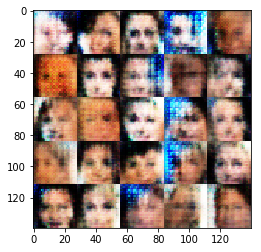

Epoch 1/10... Discriminator Loss: 1.3770... Generator Loss: 0.7846
Epoch 1/10... Discriminator Loss: 1.3678... Generator Loss: 0.7754
Epoch 1/10... Discriminator Loss: 1.3814... Generator Loss: 0.7920
Epoch 1/10... Discriminator Loss: 1.3924... Generator Loss: 0.7710
Epoch 1/10... Discriminator Loss: 1.3800... Generator Loss: 0.7881
Epoch 1/10... Discriminator Loss: 1.3749... Generator Loss: 0.7787
Epoch 1/10... Discriminator Loss: 1.3881... Generator Loss: 0.7916
Epoch 1/10... Discriminator Loss: 1.3833... Generator Loss: 0.7648
Epoch 1/10... Discriminator Loss: 1.3936... Generator Loss: 0.7729
Epoch 1/10... Discriminator Loss: 1.3625... Generator Loss: 0.7868


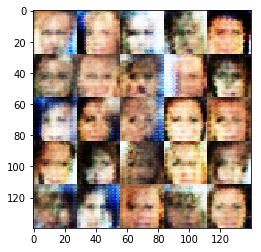

Epoch 1/10... Discriminator Loss: 1.3680... Generator Loss: 0.7730
Epoch 1/10... Discriminator Loss: 1.3387... Generator Loss: 0.8079
Epoch 1/10... Discriminator Loss: 1.3505... Generator Loss: 0.8178
Epoch 1/10... Discriminator Loss: 1.3637... Generator Loss: 0.7513
Epoch 1/10... Discriminator Loss: 1.3309... Generator Loss: 0.8098
Epoch 1/10... Discriminator Loss: 1.3738... Generator Loss: 0.7745
Epoch 1/10... Discriminator Loss: 1.4134... Generator Loss: 0.7299
Epoch 1/10... Discriminator Loss: 1.3757... Generator Loss: 0.7739
Epoch 1/10... Discriminator Loss: 1.3891... Generator Loss: 0.7610
Epoch 1/10... Discriminator Loss: 1.4395... Generator Loss: 0.7445


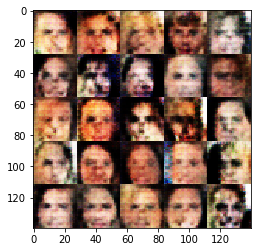

Epoch 1/10... Discriminator Loss: 1.3445... Generator Loss: 0.7848
Epoch 1/10... Discriminator Loss: 1.3647... Generator Loss: 0.7542
Epoch 1/10... Discriminator Loss: 1.4178... Generator Loss: 0.7633
Epoch 1/10... Discriminator Loss: 1.3747... Generator Loss: 0.7520
Epoch 1/10... Discriminator Loss: 1.3842... Generator Loss: 0.7828
Epoch 1/10... Discriminator Loss: 1.3845... Generator Loss: 0.7803
Epoch 1/10... Discriminator Loss: 1.3665... Generator Loss: 0.7931
Epoch 1/10... Discriminator Loss: 1.4039... Generator Loss: 0.7647
Epoch 1/10... Discriminator Loss: 1.3887... Generator Loss: 0.7751
Epoch 1/10... Discriminator Loss: 1.3897... Generator Loss: 0.7636


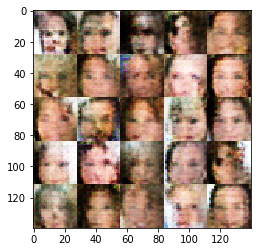

Epoch 1/10... Discriminator Loss: 1.3617... Generator Loss: 0.7896
Epoch 1/10... Discriminator Loss: 1.4217... Generator Loss: 0.7441
Epoch 1/10... Discriminator Loss: 1.3795... Generator Loss: 0.7775
Epoch 1/10... Discriminator Loss: 1.3865... Generator Loss: 0.7718
Epoch 1/10... Discriminator Loss: 1.3788... Generator Loss: 0.7754
Epoch 1/10... Discriminator Loss: 1.3808... Generator Loss: 0.7848
Epoch 1/10... Discriminator Loss: 1.3909... Generator Loss: 0.7850
Epoch 1/10... Discriminator Loss: 1.3792... Generator Loss: 0.7699
Epoch 1/10... Discriminator Loss: 1.3983... Generator Loss: 0.7701
Epoch 1/10... Discriminator Loss: 1.3889... Generator Loss: 0.7733


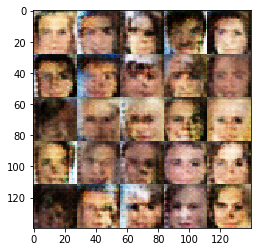

Epoch 1/10... Discriminator Loss: 1.4192... Generator Loss: 0.7621
Epoch 1/10... Discriminator Loss: 1.3811... Generator Loss: 0.7828
Epoch 1/10... Discriminator Loss: 1.4007... Generator Loss: 0.7782
Epoch 1/10... Discriminator Loss: 1.3933... Generator Loss: 0.7747
Epoch 1/10... Discriminator Loss: 1.3739... Generator Loss: 0.7804
Epoch 1/10... Discriminator Loss: 1.3831... Generator Loss: 0.7867
Epoch 1/10... Discriminator Loss: 1.3736... Generator Loss: 0.7791
Epoch 1/10... Discriminator Loss: 1.3798... Generator Loss: 0.7893
Epoch 1/10... Discriminator Loss: 1.3822... Generator Loss: 0.7913
Epoch 1/10... Discriminator Loss: 1.3844... Generator Loss: 0.7811


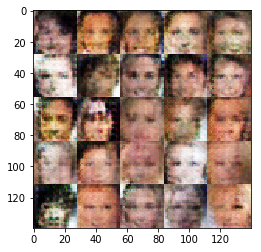

Epoch 1/10... Discriminator Loss: 1.3868... Generator Loss: 0.7879
Epoch 1/10... Discriminator Loss: 1.3952... Generator Loss: 0.7795
Epoch 1/10... Discriminator Loss: 1.4096... Generator Loss: 0.7664
Epoch 1/10... Discriminator Loss: 1.3760... Generator Loss: 0.7859
Epoch 1/10... Discriminator Loss: 1.3820... Generator Loss: 0.7581
Epoch 1/10... Discriminator Loss: 1.3615... Generator Loss: 0.7827
Epoch 1/10... Discriminator Loss: 1.3897... Generator Loss: 0.7682
Epoch 1/10... Discriminator Loss: 1.3906... Generator Loss: 0.7736
Epoch 1/10... Discriminator Loss: 1.3751... Generator Loss: 0.7819
Epoch 1/10... Discriminator Loss: 1.4030... Generator Loss: 0.7693


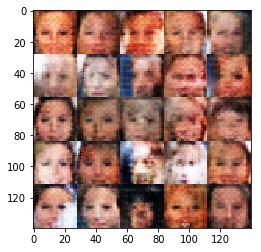

Epoch 1/10... Discriminator Loss: 1.3838... Generator Loss: 0.7702
Epoch 1/10... Discriminator Loss: 1.3608... Generator Loss: 0.7920
Epoch 1/10... Discriminator Loss: 1.3625... Generator Loss: 0.7762
Epoch 1/10... Discriminator Loss: 1.3830... Generator Loss: 0.7713
Epoch 1/10... Discriminator Loss: 1.3870... Generator Loss: 0.7748
Epoch 1/10... Discriminator Loss: 1.3853... Generator Loss: 0.7799
Epoch 1/10... Discriminator Loss: 1.3661... Generator Loss: 0.7846
Epoch 1/10... Discriminator Loss: 1.4003... Generator Loss: 0.7723
Epoch 1/10... Discriminator Loss: 1.3888... Generator Loss: 0.7777
Epoch 1/10... Discriminator Loss: 1.3747... Generator Loss: 0.7774


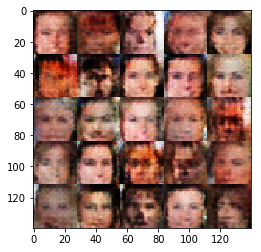

Epoch 1/10... Discriminator Loss: 1.4092... Generator Loss: 0.7605
Epoch 1/10... Discriminator Loss: 1.3681... Generator Loss: 0.7918
Epoch 1/10... Discriminator Loss: 1.3984... Generator Loss: 0.7538
Epoch 1/10... Discriminator Loss: 1.3794... Generator Loss: 0.7840
Epoch 1/10... Discriminator Loss: 1.3957... Generator Loss: 0.7716
Epoch 1/10... Discriminator Loss: 1.4044... Generator Loss: 0.7810
Epoch 1/10... Discriminator Loss: 1.3914... Generator Loss: 0.7686
Epoch 1/10... Discriminator Loss: 1.4032... Generator Loss: 0.7682
Epoch 1/10... Discriminator Loss: 1.3395... Generator Loss: 0.8008
Epoch 1/10... Discriminator Loss: 1.3641... Generator Loss: 0.7910


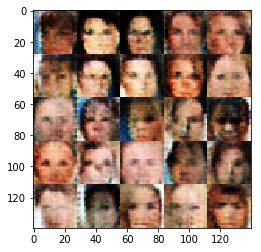

Epoch 1/10... Discriminator Loss: 1.3642... Generator Loss: 0.7828
Epoch 1/10... Discriminator Loss: 1.3796... Generator Loss: 0.7794
Epoch 1/10... Discriminator Loss: 1.3934... Generator Loss: 0.7742
Epoch 1/10... Discriminator Loss: 1.3706... Generator Loss: 0.7837
Epoch 1/10... Discriminator Loss: 1.3805... Generator Loss: 0.7739
Epoch 1/10... Discriminator Loss: 1.3767... Generator Loss: 0.7828
Epoch 1/10... Discriminator Loss: 1.3798... Generator Loss: 0.7717
Epoch 1/10... Discriminator Loss: 1.3857... Generator Loss: 0.7813
Epoch 1/10... Discriminator Loss: 1.3709... Generator Loss: 0.7847
Epoch 1/10... Discriminator Loss: 1.3903... Generator Loss: 0.7680


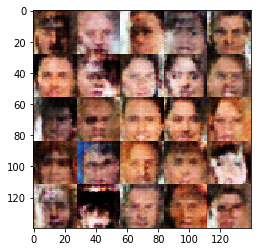

Epoch 1/10... Discriminator Loss: 1.3922... Generator Loss: 0.7634
Epoch 1/10... Discriminator Loss: 1.3866... Generator Loss: 0.7784
Epoch 1/10... Discriminator Loss: 1.3875... Generator Loss: 0.7731
Epoch 1/10... Discriminator Loss: 1.3898... Generator Loss: 0.7830
Epoch 1/10... Discriminator Loss: 1.3739... Generator Loss: 0.7909
Epoch 1/10... Discriminator Loss: 1.3872... Generator Loss: 0.7682
Epoch 1/10... Discriminator Loss: 1.3873... Generator Loss: 0.7780
Epoch 1/10... Discriminator Loss: 1.3640... Generator Loss: 0.7939
Epoch 1/10... Discriminator Loss: 1.4038... Generator Loss: 0.7633
Epoch 1/10... Discriminator Loss: 1.3876... Generator Loss: 0.7720


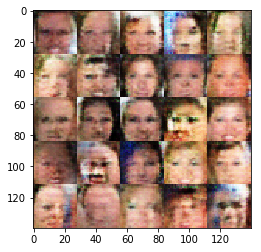

Epoch 1/10... Discriminator Loss: 1.3834... Generator Loss: 0.7734
Epoch 1/10... Discriminator Loss: 1.3631... Generator Loss: 0.7966
Epoch 1/10... Discriminator Loss: 1.3830... Generator Loss: 0.7765
Epoch 1/10... Discriminator Loss: 1.3969... Generator Loss: 0.7771
Epoch 1/10... Discriminator Loss: 1.3801... Generator Loss: 0.7773
Epoch 1/10... Discriminator Loss: 1.4075... Generator Loss: 0.7573
Epoch 1/10... Discriminator Loss: 1.3954... Generator Loss: 0.7707
Epoch 1/10... Discriminator Loss: 1.3844... Generator Loss: 0.7638
Epoch 1/10... Discriminator Loss: 1.3947... Generator Loss: 0.7741
Epoch 1/10... Discriminator Loss: 1.4264... Generator Loss: 0.7346


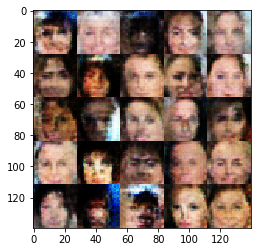

Epoch 1/10... Discriminator Loss: 1.3696... Generator Loss: 0.7876
Epoch 1/10... Discriminator Loss: 1.3846... Generator Loss: 0.7666
Epoch 1/10... Discriminator Loss: 1.3956... Generator Loss: 0.7611
Epoch 1/10... Discriminator Loss: 1.3829... Generator Loss: 0.7838
Epoch 1/10... Discriminator Loss: 1.3759... Generator Loss: 0.7675
Epoch 1/10... Discriminator Loss: 1.3820... Generator Loss: 0.7795
Epoch 1/10... Discriminator Loss: 1.4201... Generator Loss: 0.7561
Epoch 1/10... Discriminator Loss: 1.3918... Generator Loss: 0.7711
Epoch 1/10... Discriminator Loss: 1.3904... Generator Loss: 0.7747
Epoch 1/10... Discriminator Loss: 1.3715... Generator Loss: 0.7824


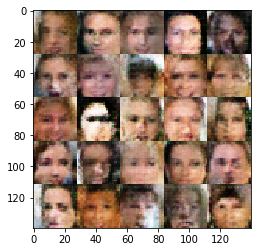

Epoch 1/10... Discriminator Loss: 1.3694... Generator Loss: 0.7864
Epoch 1/10... Discriminator Loss: 1.3911... Generator Loss: 0.7783
Epoch 1/10... Discriminator Loss: 1.3849... Generator Loss: 0.7732
Epoch 1/10... Discriminator Loss: 1.3801... Generator Loss: 0.7765
Epoch 1/10... Discriminator Loss: 1.3816... Generator Loss: 0.7774
Epoch 1/10... Discriminator Loss: 1.3871... Generator Loss: 0.7707
Epoch 1/10... Discriminator Loss: 1.3684... Generator Loss: 0.7775
Epoch 1/10... Discriminator Loss: 1.3848... Generator Loss: 0.7852
Epoch 1/10... Discriminator Loss: 1.3745... Generator Loss: 0.7807
Epoch 1/10... Discriminator Loss: 1.4001... Generator Loss: 0.7703


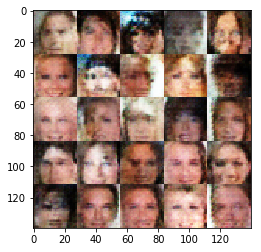

Epoch 1/10... Discriminator Loss: 1.3916... Generator Loss: 0.7798
Epoch 1/10... Discriminator Loss: 1.3952... Generator Loss: 0.7637
Epoch 1/10... Discriminator Loss: 1.3773... Generator Loss: 0.7711
Epoch 1/10... Discriminator Loss: 1.3855... Generator Loss: 0.7776
Epoch 1/10... Discriminator Loss: 1.4080... Generator Loss: 0.7553
Epoch 1/10... Discriminator Loss: 1.3825... Generator Loss: 0.7703
Epoch 1/10... Discriminator Loss: 1.3949... Generator Loss: 0.7691
Epoch 1/10... Discriminator Loss: 1.3950... Generator Loss: 0.7660
Epoch 1/10... Discriminator Loss: 1.3851... Generator Loss: 0.7775
Epoch 1/10... Discriminator Loss: 1.4128... Generator Loss: 0.7576


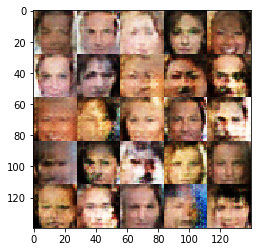

Epoch 1/10... Discriminator Loss: 1.3955... Generator Loss: 0.7605
Epoch 1/10... Discriminator Loss: 1.3894... Generator Loss: 0.7793
Epoch 1/10... Discriminator Loss: 1.3826... Generator Loss: 0.7812
Epoch 1/10... Discriminator Loss: 1.3861... Generator Loss: 0.7780
Epoch 1/10... Discriminator Loss: 1.3852... Generator Loss: 0.7755
Epoch 1/10... Discriminator Loss: 1.3829... Generator Loss: 0.7676
Epoch 1/10... Discriminator Loss: 1.3874... Generator Loss: 0.7754
Epoch 1/10... Discriminator Loss: 1.3604... Generator Loss: 0.7836
Epoch 1/10... Discriminator Loss: 1.3877... Generator Loss: 0.7688
Epoch 1/10... Discriminator Loss: 1.3813... Generator Loss: 0.7718


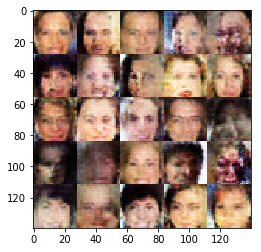

Epoch 1/10... Discriminator Loss: 1.4000... Generator Loss: 0.7592
Epoch 1/10... Discriminator Loss: 1.4001... Generator Loss: 0.7682
Epoch 1/10... Discriminator Loss: 1.3931... Generator Loss: 0.7596
Epoch 1/10... Discriminator Loss: 1.3958... Generator Loss: 0.7624
Epoch 1/10... Discriminator Loss: 1.3423... Generator Loss: 0.8005
Epoch 1/10... Discriminator Loss: 1.4184... Generator Loss: 0.7539
Epoch 1/10... Discriminator Loss: 1.3940... Generator Loss: 0.7711
Epoch 1/10... Discriminator Loss: 1.3949... Generator Loss: 0.7659
Epoch 1/10... Discriminator Loss: 1.4127... Generator Loss: 0.7598
Epoch 1/10... Discriminator Loss: 1.3830... Generator Loss: 0.7785


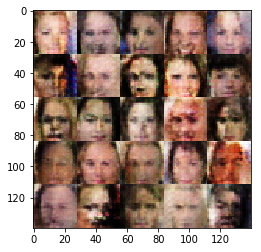

Epoch 1/10... Discriminator Loss: 1.4297... Generator Loss: 0.7384
Epoch 1/10... Discriminator Loss: 1.3839... Generator Loss: 0.7712
Epoch 1/10... Discriminator Loss: 1.3959... Generator Loss: 0.7636
Epoch 1/10... Discriminator Loss: 1.3928... Generator Loss: 0.7713
Epoch 1/10... Discriminator Loss: 1.4037... Generator Loss: 0.7605
Epoch 1/10... Discriminator Loss: 1.4002... Generator Loss: 0.7658
Epoch 1/10... Discriminator Loss: 1.3796... Generator Loss: 0.7675
Epoch 1/10... Discriminator Loss: 1.3839... Generator Loss: 0.7723
Epoch 1/10... Discriminator Loss: 1.4258... Generator Loss: 0.7470
Epoch 1/10... Discriminator Loss: 1.3890... Generator Loss: 0.7729


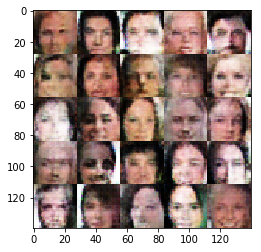

Epoch 1/10... Discriminator Loss: 1.4237... Generator Loss: 0.7461
Epoch 1/10... Discriminator Loss: 1.3782... Generator Loss: 0.7925
Epoch 1/10... Discriminator Loss: 1.3932... Generator Loss: 0.7646
Epoch 1/10... Discriminator Loss: 1.3985... Generator Loss: 0.7716
Epoch 1/10... Discriminator Loss: 1.3892... Generator Loss: 0.7686
Epoch 1/10... Discriminator Loss: 1.3985... Generator Loss: 0.7620
Epoch 1/10... Discriminator Loss: 1.3909... Generator Loss: 0.7680
Epoch 1/10... Discriminator Loss: 1.3937... Generator Loss: 0.7740
Epoch 1/10... Discriminator Loss: 1.3721... Generator Loss: 0.7718
Epoch 1/10... Discriminator Loss: 1.3575... Generator Loss: 0.7698


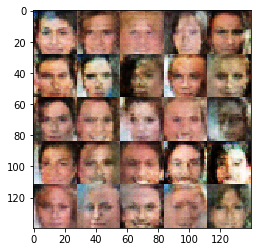

Epoch 1/10... Discriminator Loss: 1.3867... Generator Loss: 0.7771
Epoch 1/10... Discriminator Loss: 1.4083... Generator Loss: 0.7765
Epoch 1/10... Discriminator Loss: 1.3853... Generator Loss: 0.7690
Epoch 1/10... Discriminator Loss: 1.3835... Generator Loss: 0.7759
Epoch 1/10... Discriminator Loss: 1.3986... Generator Loss: 0.7656
Epoch 1/10... Discriminator Loss: 1.3924... Generator Loss: 0.7690
Epoch 1/10... Discriminator Loss: 1.3990... Generator Loss: 0.7731
Epoch 1/10... Discriminator Loss: 1.3939... Generator Loss: 0.7653
Epoch 1/10... Discriminator Loss: 1.3698... Generator Loss: 0.7866
Epoch 1/10... Discriminator Loss: 1.3819... Generator Loss: 0.7772


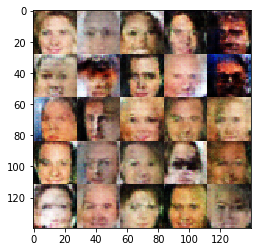

Epoch 1/10... Discriminator Loss: 1.3854... Generator Loss: 0.7688
Epoch 1/10... Discriminator Loss: 1.3828... Generator Loss: 0.7820
Epoch 1/10... Discriminator Loss: 1.3783... Generator Loss: 0.7826
Epoch 1/10... Discriminator Loss: 1.4058... Generator Loss: 0.7800
Epoch 1/10... Discriminator Loss: 1.3915... Generator Loss: 0.7627
Epoch 1/10... Discriminator Loss: 1.4018... Generator Loss: 0.7707
Epoch 1/10... Discriminator Loss: 1.3925... Generator Loss: 0.7706
Epoch 1/10... Discriminator Loss: 1.3944... Generator Loss: 0.7678
Epoch 1/10... Discriminator Loss: 1.3829... Generator Loss: 0.7795
Epoch 1/10... Discriminator Loss: 1.3877... Generator Loss: 0.7697


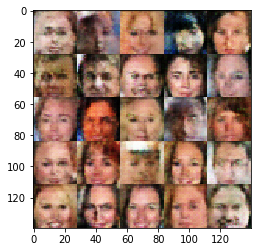

Epoch 1/10... Discriminator Loss: 1.3896... Generator Loss: 0.7636
Epoch 1/10... Discriminator Loss: 1.4014... Generator Loss: 0.7687
Epoch 1/10... Discriminator Loss: 1.3771... Generator Loss: 0.7747
Epoch 1/10... Discriminator Loss: 1.3837... Generator Loss: 0.7703
Epoch 1/10... Discriminator Loss: 1.3958... Generator Loss: 0.7782
Epoch 1/10... Discriminator Loss: 1.3919... Generator Loss: 0.7750
Epoch 1/10... Discriminator Loss: 1.3977... Generator Loss: 0.7943
Epoch 1/10... Discriminator Loss: 1.3925... Generator Loss: 0.7656
Epoch 1/10... Discriminator Loss: 1.3892... Generator Loss: 0.7778
Epoch 1/10... Discriminator Loss: 1.4010... Generator Loss: 0.7614


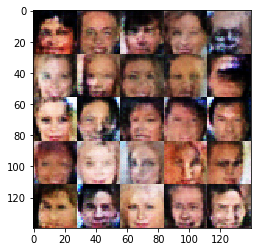

Epoch 1/10... Discriminator Loss: 1.3892... Generator Loss: 0.7737
Epoch 1/10... Discriminator Loss: 1.3795... Generator Loss: 0.7818
Epoch 1/10... Discriminator Loss: 1.3958... Generator Loss: 0.7548
Epoch 1/10... Discriminator Loss: 1.3959... Generator Loss: 0.7667
Epoch 1/10... Discriminator Loss: 1.4045... Generator Loss: 0.7600
Epoch 1/10... Discriminator Loss: 1.3900... Generator Loss: 0.7798
Epoch 1/10... Discriminator Loss: 1.3879... Generator Loss: 0.7811
Epoch 1/10... Discriminator Loss: 1.3772... Generator Loss: 0.7800
Epoch 1/10... Discriminator Loss: 1.3973... Generator Loss: 0.7724
Epoch 1/10... Discriminator Loss: 1.3814... Generator Loss: 0.7960


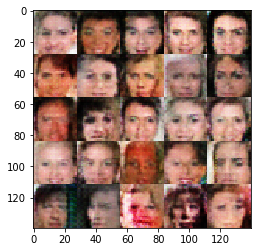

Epoch 1/10... Discriminator Loss: 1.3961... Generator Loss: 0.7770
Epoch 1/10... Discriminator Loss: 1.3912... Generator Loss: 0.7748
Epoch 1/10... Discriminator Loss: 1.4085... Generator Loss: 0.7658
Epoch 1/10... Discriminator Loss: 1.3827... Generator Loss: 0.7754
Epoch 1/10... Discriminator Loss: 1.3910... Generator Loss: 0.7651
Epoch 1/10... Discriminator Loss: 1.3814... Generator Loss: 0.7751
Epoch 1/10... Discriminator Loss: 1.3868... Generator Loss: 0.7727
Epoch 1/10... Discriminator Loss: 1.3969... Generator Loss: 0.7598
Epoch 1/10... Discriminator Loss: 1.3961... Generator Loss: 0.7805
Epoch 1/10... Discriminator Loss: 1.3898... Generator Loss: 0.7743


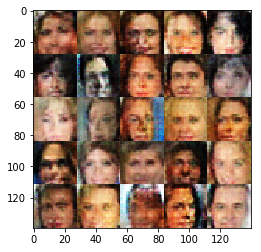

Epoch 1/10... Discriminator Loss: 1.4018... Generator Loss: 0.7605
Epoch 1/10... Discriminator Loss: 1.3935... Generator Loss: 0.7694
Epoch 1/10... Discriminator Loss: 1.3716... Generator Loss: 0.7848
Epoch 1/10... Discriminator Loss: 1.3900... Generator Loss: 0.7685
Epoch 1/10... Discriminator Loss: 1.3880... Generator Loss: 0.7744
Epoch 1/10... Discriminator Loss: 1.3882... Generator Loss: 0.7810
Epoch 1/10... Discriminator Loss: 1.3798... Generator Loss: 0.7735
Epoch 1/10... Discriminator Loss: 1.3811... Generator Loss: 0.7804
Epoch 1/10... Discriminator Loss: 1.3971... Generator Loss: 0.7690
Epoch 1/10... Discriminator Loss: 1.3971... Generator Loss: 0.7717


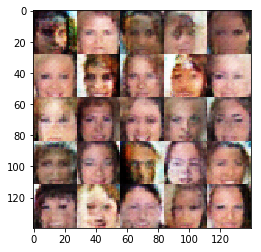

Epoch 1/10... Discriminator Loss: 1.3952... Generator Loss: 0.7717
Epoch 1/10... Discriminator Loss: 1.3589... Generator Loss: 0.7888
Epoch 1/10... Discriminator Loss: 1.3988... Generator Loss: 0.7723
Epoch 1/10... Discriminator Loss: 1.3834... Generator Loss: 0.7690
Epoch 1/10... Discriminator Loss: 1.3843... Generator Loss: 0.7739
Epoch 1/10... Discriminator Loss: 1.3808... Generator Loss: 0.7812
Epoch 1/10... Discriminator Loss: 1.3835... Generator Loss: 0.7761
Epoch 1/10... Discriminator Loss: 1.3944... Generator Loss: 0.7698
Epoch 1/10... Discriminator Loss: 1.3945... Generator Loss: 0.7713
Epoch 1/10... Discriminator Loss: 1.4022... Generator Loss: 0.7572


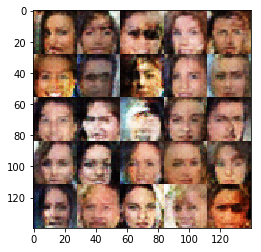

Epoch 1/10... Discriminator Loss: 1.3813... Generator Loss: 0.7757
Epoch 1/10... Discriminator Loss: 1.3904... Generator Loss: 0.7638
Epoch 1/10... Discriminator Loss: 1.3933... Generator Loss: 0.7798
Epoch 1/10... Discriminator Loss: 1.3941... Generator Loss: 0.7722
Epoch 1/10... Discriminator Loss: 1.3823... Generator Loss: 0.7706
Epoch 1/10... Discriminator Loss: 1.3900... Generator Loss: 0.7712
Epoch 1/10... Discriminator Loss: 1.3980... Generator Loss: 0.7805
Epoch 1/10... Discriminator Loss: 1.4017... Generator Loss: 0.7605
Epoch 1/10... Discriminator Loss: 1.3865... Generator Loss: 0.7731
Epoch 1/10... Discriminator Loss: 1.4125... Generator Loss: 0.7478


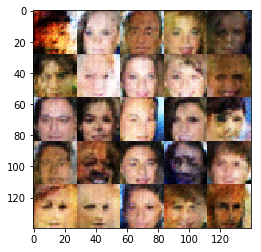

Epoch 1/10... Discriminator Loss: 1.3972... Generator Loss: 0.7673
Epoch 1/10... Discriminator Loss: 1.3902... Generator Loss: 0.7671
Epoch 1/10... Discriminator Loss: 1.3990... Generator Loss: 0.7661
Epoch 1/10... Discriminator Loss: 1.3869... Generator Loss: 0.7593
Epoch 1/10... Discriminator Loss: 1.3915... Generator Loss: 0.7655
Epoch 1/10... Discriminator Loss: 1.4048... Generator Loss: 0.7799
Epoch 2/10... Discriminator Loss: 1.3805... Generator Loss: 0.7790
Epoch 2/10... Discriminator Loss: 1.4010... Generator Loss: 0.7650
Epoch 2/10... Discriminator Loss: 1.4061... Generator Loss: 0.7646
Epoch 2/10... Discriminator Loss: 1.4007... Generator Loss: 0.7655


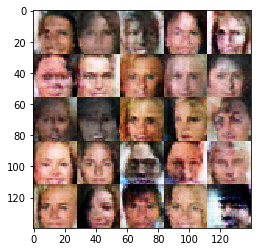

Epoch 2/10... Discriminator Loss: 1.3849... Generator Loss: 0.7755
Epoch 2/10... Discriminator Loss: 1.3811... Generator Loss: 0.7756
Epoch 2/10... Discriminator Loss: 1.3900... Generator Loss: 0.7682
Epoch 2/10... Discriminator Loss: 1.4080... Generator Loss: 0.7454
Epoch 2/10... Discriminator Loss: 1.3972... Generator Loss: 0.7713
Epoch 2/10... Discriminator Loss: 1.3769... Generator Loss: 0.7859
Epoch 2/10... Discriminator Loss: 1.3770... Generator Loss: 0.7777
Epoch 2/10... Discriminator Loss: 1.3905... Generator Loss: 0.7698
Epoch 2/10... Discriminator Loss: 1.3828... Generator Loss: 0.7783
Epoch 2/10... Discriminator Loss: 1.3999... Generator Loss: 0.7616


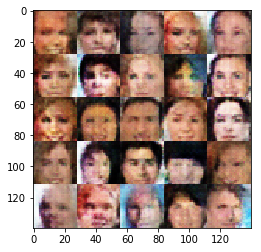

Epoch 2/10... Discriminator Loss: 1.3894... Generator Loss: 0.7748
Epoch 2/10... Discriminator Loss: 1.4028... Generator Loss: 0.7660
Epoch 2/10... Discriminator Loss: 1.3986... Generator Loss: 0.7709
Epoch 2/10... Discriminator Loss: 1.3968... Generator Loss: 0.7666
Epoch 2/10... Discriminator Loss: 1.3842... Generator Loss: 0.7665
Epoch 2/10... Discriminator Loss: 1.3651... Generator Loss: 0.7934
Epoch 2/10... Discriminator Loss: 1.3527... Generator Loss: 0.7989
Epoch 2/10... Discriminator Loss: 1.4105... Generator Loss: 0.7486
Epoch 2/10... Discriminator Loss: 1.3807... Generator Loss: 0.7859
Epoch 2/10... Discriminator Loss: 1.4010... Generator Loss: 0.7652


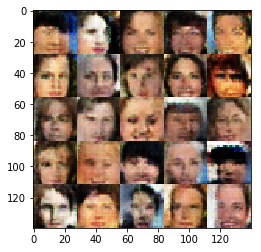

Epoch 2/10... Discriminator Loss: 1.3801... Generator Loss: 0.7806
Epoch 2/10... Discriminator Loss: 1.3782... Generator Loss: 0.7801
Epoch 2/10... Discriminator Loss: 1.3787... Generator Loss: 0.7839
Epoch 2/10... Discriminator Loss: 1.3964... Generator Loss: 0.7697
Epoch 2/10... Discriminator Loss: 1.3906... Generator Loss: 0.7727
Epoch 2/10... Discriminator Loss: 1.3883... Generator Loss: 0.7709
Epoch 2/10... Discriminator Loss: 1.3843... Generator Loss: 0.7719
Epoch 2/10... Discriminator Loss: 1.3901... Generator Loss: 0.7777
Epoch 2/10... Discriminator Loss: 1.3774... Generator Loss: 0.7755
Epoch 2/10... Discriminator Loss: 1.3913... Generator Loss: 0.7658


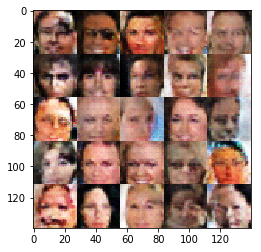

Epoch 2/10... Discriminator Loss: 1.3877... Generator Loss: 0.7780
Epoch 2/10... Discriminator Loss: 1.3993... Generator Loss: 0.7659
Epoch 2/10... Discriminator Loss: 1.4099... Generator Loss: 0.7626
Epoch 2/10... Discriminator Loss: 1.3808... Generator Loss: 0.7858
Epoch 2/10... Discriminator Loss: 1.3871... Generator Loss: 0.7683
Epoch 2/10... Discriminator Loss: 1.4028... Generator Loss: 0.7643
Epoch 2/10... Discriminator Loss: 1.3935... Generator Loss: 0.7570
Epoch 2/10... Discriminator Loss: 1.3865... Generator Loss: 0.7683
Epoch 2/10... Discriminator Loss: 1.3862... Generator Loss: 0.7776
Epoch 2/10... Discriminator Loss: 1.3863... Generator Loss: 0.7683


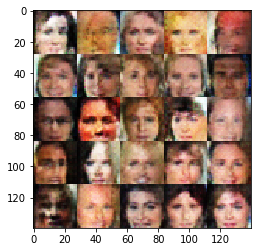

Epoch 2/10... Discriminator Loss: 1.3870... Generator Loss: 0.7843
Epoch 2/10... Discriminator Loss: 1.3873... Generator Loss: 0.7651
Epoch 2/10... Discriminator Loss: 1.4142... Generator Loss: 0.7480
Epoch 2/10... Discriminator Loss: 1.3770... Generator Loss: 0.7858
Epoch 2/10... Discriminator Loss: 1.4006... Generator Loss: 0.7655
Epoch 2/10... Discriminator Loss: 1.3906... Generator Loss: 0.7657
Epoch 2/10... Discriminator Loss: 1.3907... Generator Loss: 0.7770
Epoch 2/10... Discriminator Loss: 1.3847... Generator Loss: 0.7787
Epoch 2/10... Discriminator Loss: 1.3781... Generator Loss: 0.7938
Epoch 2/10... Discriminator Loss: 1.3907... Generator Loss: 0.7731


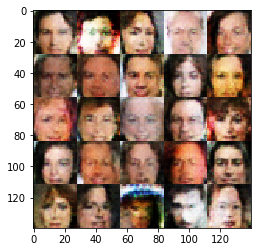

Epoch 2/10... Discriminator Loss: 1.3931... Generator Loss: 0.7654
Epoch 2/10... Discriminator Loss: 1.4039... Generator Loss: 0.7745
Epoch 2/10... Discriminator Loss: 1.3784... Generator Loss: 0.7730
Epoch 2/10... Discriminator Loss: 1.3863... Generator Loss: 0.7787
Epoch 2/10... Discriminator Loss: 1.3844... Generator Loss: 0.7691
Epoch 2/10... Discriminator Loss: 1.4048... Generator Loss: 0.7554
Epoch 2/10... Discriminator Loss: 1.3878... Generator Loss: 0.7756
Epoch 2/10... Discriminator Loss: 1.4151... Generator Loss: 0.7458
Epoch 2/10... Discriminator Loss: 1.3907... Generator Loss: 0.7666
Epoch 2/10... Discriminator Loss: 1.3885... Generator Loss: 0.7794


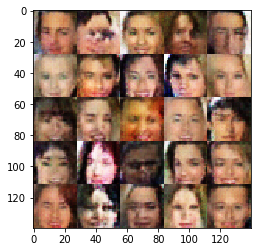

Epoch 2/10... Discriminator Loss: 1.3855... Generator Loss: 0.8018
Epoch 2/10... Discriminator Loss: 1.3967... Generator Loss: 0.7655
Epoch 2/10... Discriminator Loss: 1.3765... Generator Loss: 0.7790
Epoch 2/10... Discriminator Loss: 1.3912... Generator Loss: 0.7739
Epoch 2/10... Discriminator Loss: 1.3758... Generator Loss: 0.7774
Epoch 2/10... Discriminator Loss: 1.3877... Generator Loss: 0.7773
Epoch 2/10... Discriminator Loss: 1.3888... Generator Loss: 0.7639
Epoch 2/10... Discriminator Loss: 1.3831... Generator Loss: 0.7706
Epoch 2/10... Discriminator Loss: 1.4047... Generator Loss: 0.7627
Epoch 2/10... Discriminator Loss: 1.3810... Generator Loss: 0.7733


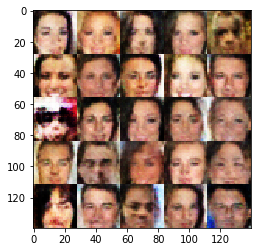

Epoch 2/10... Discriminator Loss: 1.3791... Generator Loss: 0.7854
Epoch 2/10... Discriminator Loss: 1.3795... Generator Loss: 0.7723
Epoch 2/10... Discriminator Loss: 1.3816... Generator Loss: 0.7711
Epoch 2/10... Discriminator Loss: 1.3762... Generator Loss: 0.7709
Epoch 2/10... Discriminator Loss: 1.3718... Generator Loss: 0.7884
Epoch 2/10... Discriminator Loss: 1.3711... Generator Loss: 0.7939
Epoch 2/10... Discriminator Loss: 1.3923... Generator Loss: 0.7727
Epoch 2/10... Discriminator Loss: 1.4037... Generator Loss: 0.7518
Epoch 2/10... Discriminator Loss: 1.3933... Generator Loss: 0.7838
Epoch 2/10... Discriminator Loss: 1.3774... Generator Loss: 0.7825


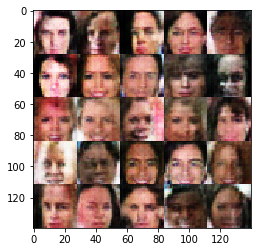

Epoch 2/10... Discriminator Loss: 1.3983... Generator Loss: 0.7631
Epoch 2/10... Discriminator Loss: 1.3827... Generator Loss: 0.7769
Epoch 2/10... Discriminator Loss: 1.3683... Generator Loss: 0.7820
Epoch 2/10... Discriminator Loss: 1.3791... Generator Loss: 0.7811
Epoch 2/10... Discriminator Loss: 1.3936... Generator Loss: 0.7615
Epoch 2/10... Discriminator Loss: 1.3989... Generator Loss: 0.7708
Epoch 2/10... Discriminator Loss: 1.3819... Generator Loss: 0.7722
Epoch 2/10... Discriminator Loss: 1.3718... Generator Loss: 0.7833
Epoch 2/10... Discriminator Loss: 1.3811... Generator Loss: 0.7850
Epoch 2/10... Discriminator Loss: 1.3809... Generator Loss: 0.7744


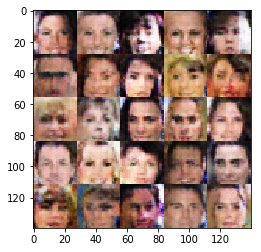

Epoch 2/10... Discriminator Loss: 1.3904... Generator Loss: 0.7581
Epoch 2/10... Discriminator Loss: 1.3848... Generator Loss: 0.7679
Epoch 2/10... Discriminator Loss: 1.3845... Generator Loss: 0.7817
Epoch 2/10... Discriminator Loss: 1.3870... Generator Loss: 0.7771
Epoch 2/10... Discriminator Loss: 1.3827... Generator Loss: 0.7737
Epoch 2/10... Discriminator Loss: 1.3875... Generator Loss: 0.7711
Epoch 2/10... Discriminator Loss: 1.3716... Generator Loss: 0.7806
Epoch 2/10... Discriminator Loss: 1.3949... Generator Loss: 0.7712
Epoch 2/10... Discriminator Loss: 1.3990... Generator Loss: 0.7659
Epoch 2/10... Discriminator Loss: 1.3926... Generator Loss: 0.7727


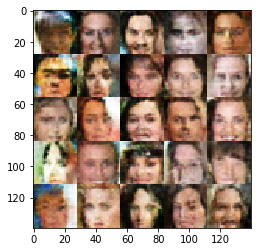

Epoch 2/10... Discriminator Loss: 1.3804... Generator Loss: 0.7808
Epoch 2/10... Discriminator Loss: 1.3788... Generator Loss: 0.7697
Epoch 2/10... Discriminator Loss: 1.3807... Generator Loss: 0.7856
Epoch 2/10... Discriminator Loss: 1.3889... Generator Loss: 0.7783
Epoch 2/10... Discriminator Loss: 1.3820... Generator Loss: 0.7827
Epoch 2/10... Discriminator Loss: 1.3888... Generator Loss: 0.7722
Epoch 2/10... Discriminator Loss: 1.3811... Generator Loss: 0.7684
Epoch 2/10... Discriminator Loss: 1.3875... Generator Loss: 0.7618
Epoch 2/10... Discriminator Loss: 1.3913... Generator Loss: 0.7730
Epoch 2/10... Discriminator Loss: 1.3814... Generator Loss: 0.7657


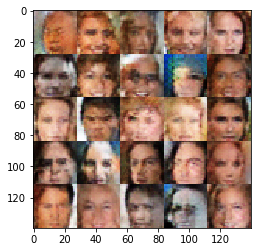

Epoch 2/10... Discriminator Loss: 1.3807... Generator Loss: 0.7720
Epoch 2/10... Discriminator Loss: 1.3883... Generator Loss: 0.7752
Epoch 2/10... Discriminator Loss: 1.3961... Generator Loss: 0.7531
Epoch 2/10... Discriminator Loss: 1.3962... Generator Loss: 0.7579
Epoch 2/10... Discriminator Loss: 1.4330... Generator Loss: 0.7325
Epoch 2/10... Discriminator Loss: 1.3901... Generator Loss: 0.7687
Epoch 2/10... Discriminator Loss: 1.3877... Generator Loss: 0.7683
Epoch 2/10... Discriminator Loss: 1.3846... Generator Loss: 0.7658
Epoch 2/10... Discriminator Loss: 1.3962... Generator Loss: 0.7666
Epoch 2/10... Discriminator Loss: 1.4025... Generator Loss: 0.7826


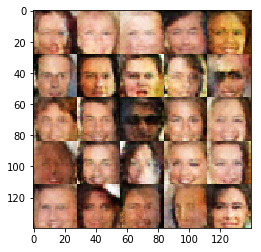

Epoch 2/10... Discriminator Loss: 1.3895... Generator Loss: 0.7706
Epoch 2/10... Discriminator Loss: 1.3769... Generator Loss: 0.7900
Epoch 2/10... Discriminator Loss: 1.3791... Generator Loss: 0.7816
Epoch 2/10... Discriminator Loss: 1.4062... Generator Loss: 0.7618
Epoch 2/10... Discriminator Loss: 1.3794... Generator Loss: 0.7863
Epoch 2/10... Discriminator Loss: 1.3915... Generator Loss: 0.7806
Epoch 2/10... Discriminator Loss: 1.3681... Generator Loss: 0.7979
Epoch 2/10... Discriminator Loss: 1.3998... Generator Loss: 0.7676
Epoch 2/10... Discriminator Loss: 1.3950... Generator Loss: 0.7697
Epoch 2/10... Discriminator Loss: 1.3986... Generator Loss: 0.7602


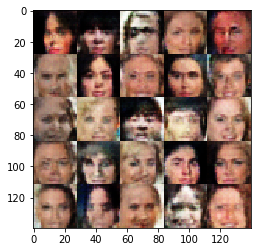

Epoch 2/10... Discriminator Loss: 1.3938... Generator Loss: 0.7546
Epoch 2/10... Discriminator Loss: 1.3957... Generator Loss: 0.7725
Epoch 2/10... Discriminator Loss: 1.3974... Generator Loss: 0.7632
Epoch 2/10... Discriminator Loss: 1.3924... Generator Loss: 0.7677
Epoch 2/10... Discriminator Loss: 1.3939... Generator Loss: 0.7666
Epoch 2/10... Discriminator Loss: 1.3997... Generator Loss: 0.7628
Epoch 2/10... Discriminator Loss: 1.3995... Generator Loss: 0.7693
Epoch 2/10... Discriminator Loss: 1.3722... Generator Loss: 0.7887
Epoch 2/10... Discriminator Loss: 1.3911... Generator Loss: 0.7669
Epoch 2/10... Discriminator Loss: 1.3804... Generator Loss: 0.7715


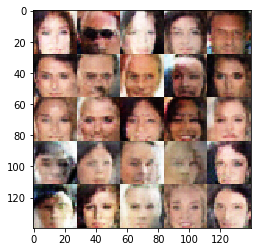

Epoch 2/10... Discriminator Loss: 1.4161... Generator Loss: 0.7468
Epoch 2/10... Discriminator Loss: 1.3868... Generator Loss: 0.7889
Epoch 2/10... Discriminator Loss: 1.3936... Generator Loss: 0.7694
Epoch 2/10... Discriminator Loss: 1.3864... Generator Loss: 0.7688
Epoch 2/10... Discriminator Loss: 1.3866... Generator Loss: 0.7763
Epoch 2/10... Discriminator Loss: 1.3820... Generator Loss: 0.7830
Epoch 2/10... Discriminator Loss: 1.3763... Generator Loss: 0.7827
Epoch 2/10... Discriminator Loss: 1.3891... Generator Loss: 0.7796
Epoch 2/10... Discriminator Loss: 1.3975... Generator Loss: 0.7602
Epoch 2/10... Discriminator Loss: 1.3874... Generator Loss: 0.7800


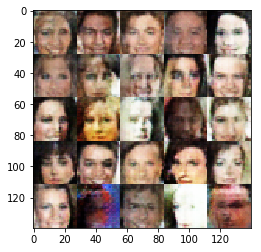

Epoch 2/10... Discriminator Loss: 1.3835... Generator Loss: 0.7610
Epoch 2/10... Discriminator Loss: 1.3893... Generator Loss: 0.7730
Epoch 2/10... Discriminator Loss: 1.3857... Generator Loss: 0.7736
Epoch 2/10... Discriminator Loss: 1.3923... Generator Loss: 0.7783
Epoch 2/10... Discriminator Loss: 1.3954... Generator Loss: 0.7564
Epoch 2/10... Discriminator Loss: 1.3633... Generator Loss: 0.7817
Epoch 2/10... Discriminator Loss: 1.3792... Generator Loss: 0.7769
Epoch 2/10... Discriminator Loss: 1.3796... Generator Loss: 0.7723
Epoch 2/10... Discriminator Loss: 1.3784... Generator Loss: 0.7740
Epoch 2/10... Discriminator Loss: 1.4017... Generator Loss: 0.7651


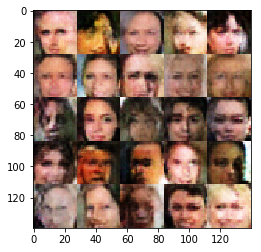

Epoch 2/10... Discriminator Loss: 1.3887... Generator Loss: 0.7626
Epoch 2/10... Discriminator Loss: 1.3861... Generator Loss: 0.7651
Epoch 2/10... Discriminator Loss: 1.4091... Generator Loss: 0.7650
Epoch 2/10... Discriminator Loss: 1.3832... Generator Loss: 0.7723
Epoch 2/10... Discriminator Loss: 1.3709... Generator Loss: 0.7754
Epoch 2/10... Discriminator Loss: 1.3973... Generator Loss: 0.7662
Epoch 2/10... Discriminator Loss: 1.3785... Generator Loss: 0.7815
Epoch 2/10... Discriminator Loss: 1.3811... Generator Loss: 0.7815
Epoch 2/10... Discriminator Loss: 1.3879... Generator Loss: 0.7707
Epoch 2/10... Discriminator Loss: 1.3648... Generator Loss: 0.7830


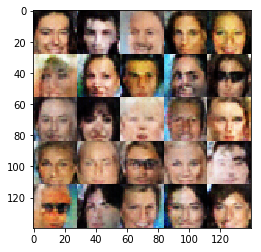

Epoch 2/10... Discriminator Loss: 1.3852... Generator Loss: 0.7599
Epoch 2/10... Discriminator Loss: 1.3718... Generator Loss: 0.7823
Epoch 2/10... Discriminator Loss: 1.3749... Generator Loss: 0.7829
Epoch 2/10... Discriminator Loss: 1.3929... Generator Loss: 0.7613
Epoch 2/10... Discriminator Loss: 1.3916... Generator Loss: 0.7620
Epoch 2/10... Discriminator Loss: 1.3877... Generator Loss: 0.7691
Epoch 2/10... Discriminator Loss: 1.3849... Generator Loss: 0.7839
Epoch 2/10... Discriminator Loss: 1.3797... Generator Loss: 0.7963
Epoch 2/10... Discriminator Loss: 1.3801... Generator Loss: 0.7430
Epoch 2/10... Discriminator Loss: 1.3985... Generator Loss: 0.7821


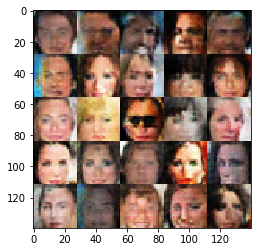

Epoch 2/10... Discriminator Loss: 1.3753... Generator Loss: 0.7800
Epoch 2/10... Discriminator Loss: 1.3900... Generator Loss: 0.7797
Epoch 2/10... Discriminator Loss: 1.3747... Generator Loss: 0.7893
Epoch 2/10... Discriminator Loss: 1.4438... Generator Loss: 0.7723
Epoch 2/10... Discriminator Loss: 1.3777... Generator Loss: 0.7782
Epoch 2/10... Discriminator Loss: 1.3831... Generator Loss: 0.7786
Epoch 2/10... Discriminator Loss: 1.3764... Generator Loss: 0.7746
Epoch 2/10... Discriminator Loss: 1.3747... Generator Loss: 0.7803
Epoch 2/10... Discriminator Loss: 1.3648... Generator Loss: 0.7878
Epoch 2/10... Discriminator Loss: 1.3880... Generator Loss: 0.7643


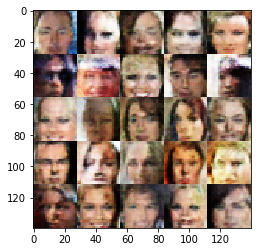

Epoch 2/10... Discriminator Loss: 1.3900... Generator Loss: 0.7705
Epoch 2/10... Discriminator Loss: 1.3737... Generator Loss: 0.7786
Epoch 2/10... Discriminator Loss: 1.3769... Generator Loss: 0.7641
Epoch 2/10... Discriminator Loss: 1.4051... Generator Loss: 0.7661
Epoch 2/10... Discriminator Loss: 1.3810... Generator Loss: 0.7725
Epoch 2/10... Discriminator Loss: 1.3921... Generator Loss: 0.7596
Epoch 2/10... Discriminator Loss: 1.4055... Generator Loss: 0.7695
Epoch 2/10... Discriminator Loss: 1.3596... Generator Loss: 0.7964
Epoch 2/10... Discriminator Loss: 1.3731... Generator Loss: 0.7693
Epoch 2/10... Discriminator Loss: 1.3481... Generator Loss: 0.7874


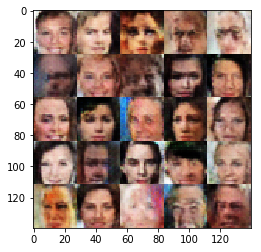

Epoch 2/10... Discriminator Loss: 1.3773... Generator Loss: 0.8035
Epoch 2/10... Discriminator Loss: 1.3789... Generator Loss: 0.7849
Epoch 2/10... Discriminator Loss: 1.4003... Generator Loss: 0.7530
Epoch 2/10... Discriminator Loss: 1.3765... Generator Loss: 0.7860
Epoch 2/10... Discriminator Loss: 1.3785... Generator Loss: 0.7773
Epoch 2/10... Discriminator Loss: 1.3620... Generator Loss: 0.7887
Epoch 2/10... Discriminator Loss: 1.3539... Generator Loss: 0.8174
Epoch 2/10... Discriminator Loss: 1.3746... Generator Loss: 0.7633
Epoch 2/10... Discriminator Loss: 1.3563... Generator Loss: 0.7795
Epoch 2/10... Discriminator Loss: 1.3941... Generator Loss: 0.7484


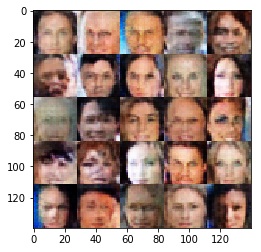

Epoch 2/10... Discriminator Loss: 1.3769... Generator Loss: 0.7875
Epoch 2/10... Discriminator Loss: 1.3596... Generator Loss: 0.7858
Epoch 2/10... Discriminator Loss: 1.3665... Generator Loss: 0.7890
Epoch 2/10... Discriminator Loss: 1.3624... Generator Loss: 0.7821
Epoch 2/10... Discriminator Loss: 1.3831... Generator Loss: 0.7665
Epoch 2/10... Discriminator Loss: 1.3858... Generator Loss: 0.7503
Epoch 2/10... Discriminator Loss: 1.3637... Generator Loss: 0.8025
Epoch 2/10... Discriminator Loss: 1.3705... Generator Loss: 0.7820
Epoch 2/10... Discriminator Loss: 1.3924... Generator Loss: 0.7563
Epoch 2/10... Discriminator Loss: 1.3587... Generator Loss: 0.8070


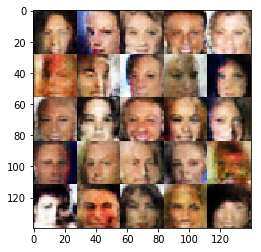

Epoch 2/10... Discriminator Loss: 1.3920... Generator Loss: 0.7661
Epoch 2/10... Discriminator Loss: 1.3866... Generator Loss: 0.7629
Epoch 2/10... Discriminator Loss: 1.3386... Generator Loss: 0.8220
Epoch 2/10... Discriminator Loss: 1.3728... Generator Loss: 0.7667
Epoch 2/10... Discriminator Loss: 1.3796... Generator Loss: 0.7845
Epoch 2/10... Discriminator Loss: 1.3220... Generator Loss: 0.7788
Epoch 2/10... Discriminator Loss: 1.3568... Generator Loss: 0.7958
Epoch 2/10... Discriminator Loss: 1.3537... Generator Loss: 0.7878
Epoch 2/10... Discriminator Loss: 1.3735... Generator Loss: 0.7729
Epoch 2/10... Discriminator Loss: 1.3641... Generator Loss: 0.7851


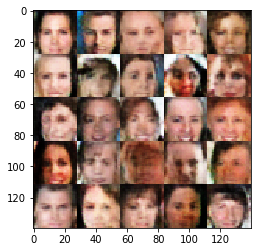

Epoch 2/10... Discriminator Loss: 1.3530... Generator Loss: 0.7941
Epoch 2/10... Discriminator Loss: 1.3606... Generator Loss: 0.7743
Epoch 2/10... Discriminator Loss: 1.3838... Generator Loss: 0.7755
Epoch 2/10... Discriminator Loss: 1.3466... Generator Loss: 0.8091
Epoch 2/10... Discriminator Loss: 1.3671... Generator Loss: 0.7849
Epoch 2/10... Discriminator Loss: 1.3554... Generator Loss: 0.7930
Epoch 2/10... Discriminator Loss: 1.3778... Generator Loss: 0.7821
Epoch 2/10... Discriminator Loss: 1.3580... Generator Loss: 0.7881
Epoch 2/10... Discriminator Loss: 1.3928... Generator Loss: 0.7602
Epoch 2/10... Discriminator Loss: 1.3619... Generator Loss: 0.7738


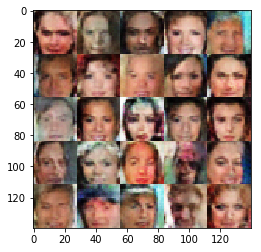

Epoch 2/10... Discriminator Loss: 1.3800... Generator Loss: 0.7602
Epoch 2/10... Discriminator Loss: 1.3925... Generator Loss: 0.7517
Epoch 2/10... Discriminator Loss: 1.3670... Generator Loss: 0.7778
Epoch 2/10... Discriminator Loss: 1.3722... Generator Loss: 0.7816
Epoch 2/10... Discriminator Loss: 1.3701... Generator Loss: 0.7833
Epoch 2/10... Discriminator Loss: 1.3883... Generator Loss: 0.7613
Epoch 2/10... Discriminator Loss: 1.3830... Generator Loss: 0.7653
Epoch 2/10... Discriminator Loss: 1.3937... Generator Loss: 0.7822
Epoch 2/10... Discriminator Loss: 1.3804... Generator Loss: 0.7600
Epoch 2/10... Discriminator Loss: 1.4437... Generator Loss: 0.7863


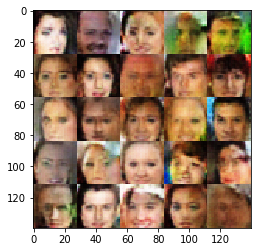

Epoch 2/10... Discriminator Loss: 1.3569... Generator Loss: 0.7839
Epoch 2/10... Discriminator Loss: 1.3836... Generator Loss: 0.7776
Epoch 2/10... Discriminator Loss: 1.4327... Generator Loss: 0.7257
Epoch 2/10... Discriminator Loss: 1.3745... Generator Loss: 0.7519
Epoch 2/10... Discriminator Loss: 1.3550... Generator Loss: 0.7845
Epoch 2/10... Discriminator Loss: 1.3740... Generator Loss: 0.7905
Epoch 2/10... Discriminator Loss: 1.3690... Generator Loss: 0.7757
Epoch 2/10... Discriminator Loss: 1.3599... Generator Loss: 0.7692
Epoch 2/10... Discriminator Loss: 1.3882... Generator Loss: 0.7552
Epoch 2/10... Discriminator Loss: 1.3632... Generator Loss: 0.7779


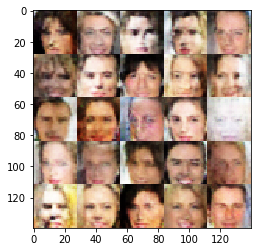

Epoch 2/10... Discriminator Loss: 1.3594... Generator Loss: 0.7856
Epoch 2/10... Discriminator Loss: 1.3538... Generator Loss: 0.7989
Epoch 2/10... Discriminator Loss: 1.3652... Generator Loss: 0.7829
Epoch 2/10... Discriminator Loss: 1.3918... Generator Loss: 0.7697
Epoch 2/10... Discriminator Loss: 1.3684... Generator Loss: 0.7839
Epoch 2/10... Discriminator Loss: 1.3894... Generator Loss: 0.7515
Epoch 2/10... Discriminator Loss: 1.3636... Generator Loss: 0.7902
Epoch 2/10... Discriminator Loss: 1.4171... Generator Loss: 0.8073
Epoch 2/10... Discriminator Loss: 1.3962... Generator Loss: 0.7636
Epoch 2/10... Discriminator Loss: 1.3583... Generator Loss: 0.7804


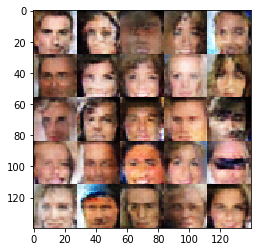

Epoch 2/10... Discriminator Loss: 1.4033... Generator Loss: 0.7597
Epoch 2/10... Discriminator Loss: 1.4051... Generator Loss: 0.7608
Epoch 2/10... Discriminator Loss: 1.3848... Generator Loss: 0.7741
Epoch 2/10... Discriminator Loss: 1.3912... Generator Loss: 0.7541
Epoch 2/10... Discriminator Loss: 1.3498... Generator Loss: 0.7869
Epoch 2/10... Discriminator Loss: 1.3898... Generator Loss: 0.7950
Epoch 2/10... Discriminator Loss: 1.3335... Generator Loss: 0.8004
Epoch 2/10... Discriminator Loss: 1.3785... Generator Loss: 0.7599
Epoch 2/10... Discriminator Loss: 1.3703... Generator Loss: 0.7920
Epoch 2/10... Discriminator Loss: 1.4046... Generator Loss: 0.7574


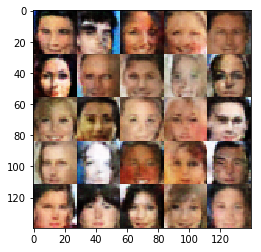

Epoch 2/10... Discriminator Loss: 1.3844... Generator Loss: 0.7688
Epoch 2/10... Discriminator Loss: 1.3520... Generator Loss: 0.7849
Epoch 2/10... Discriminator Loss: 1.3916... Generator Loss: 0.7705
Epoch 2/10... Discriminator Loss: 1.3860... Generator Loss: 0.7781
Epoch 2/10... Discriminator Loss: 1.3397... Generator Loss: 0.7963
Epoch 2/10... Discriminator Loss: 1.3702... Generator Loss: 0.7608
Epoch 2/10... Discriminator Loss: 1.3687... Generator Loss: 0.7930
Epoch 2/10... Discriminator Loss: 1.3553... Generator Loss: 0.7888
Epoch 2/10... Discriminator Loss: 1.3631... Generator Loss: 0.7888
Epoch 2/10... Discriminator Loss: 1.3687... Generator Loss: 0.7772


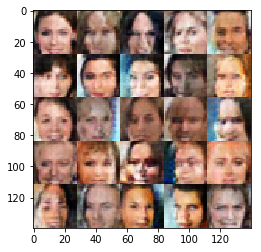

Epoch 2/10... Discriminator Loss: 1.3935... Generator Loss: 0.7715
Epoch 2/10... Discriminator Loss: 1.3951... Generator Loss: 0.7822
Epoch 2/10... Discriminator Loss: 1.3509... Generator Loss: 0.7753
Epoch 2/10... Discriminator Loss: 1.3794... Generator Loss: 0.7614
Epoch 2/10... Discriminator Loss: 1.3526... Generator Loss: 0.7867
Epoch 2/10... Discriminator Loss: 1.4199... Generator Loss: 0.7604
Epoch 2/10... Discriminator Loss: 1.3502... Generator Loss: 0.7838
Epoch 2/10... Discriminator Loss: 1.3298... Generator Loss: 0.7785
Epoch 2/10... Discriminator Loss: 1.4388... Generator Loss: 0.8148
Epoch 2/10... Discriminator Loss: 1.3611... Generator Loss: 0.7595


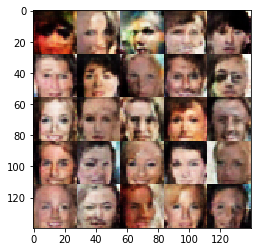

Epoch 2/10... Discriminator Loss: 1.3605... Generator Loss: 0.7809
Epoch 2/10... Discriminator Loss: 1.3640... Generator Loss: 0.7653
Epoch 2/10... Discriminator Loss: 1.3916... Generator Loss: 0.7458
Epoch 2/10... Discriminator Loss: 1.3420... Generator Loss: 0.7716
Epoch 2/10... Discriminator Loss: 1.3512... Generator Loss: 0.7952
Epoch 2/10... Discriminator Loss: 1.3483... Generator Loss: 0.7764
Epoch 2/10... Discriminator Loss: 1.3452... Generator Loss: 0.7850
Epoch 2/10... Discriminator Loss: 1.3623... Generator Loss: 0.8028
Epoch 2/10... Discriminator Loss: 1.3582... Generator Loss: 0.8016
Epoch 2/10... Discriminator Loss: 1.3563... Generator Loss: 0.7840


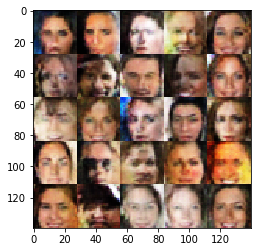

Epoch 2/10... Discriminator Loss: 1.3407... Generator Loss: 0.8021
Epoch 2/10... Discriminator Loss: 1.3425... Generator Loss: 0.7927
Epoch 2/10... Discriminator Loss: 1.3571... Generator Loss: 0.8080
Epoch 3/10... Discriminator Loss: 1.3978... Generator Loss: 0.7712
Epoch 3/10... Discriminator Loss: 1.4071... Generator Loss: 0.7223
Epoch 3/10... Discriminator Loss: 1.3958... Generator Loss: 0.7499
Epoch 3/10... Discriminator Loss: 1.3800... Generator Loss: 0.7815
Epoch 3/10... Discriminator Loss: 1.4048... Generator Loss: 0.7472
Epoch 3/10... Discriminator Loss: 1.3544... Generator Loss: 0.7890
Epoch 3/10... Discriminator Loss: 1.3691... Generator Loss: 0.7653


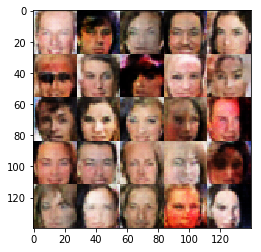

Epoch 3/10... Discriminator Loss: 1.3746... Generator Loss: 0.7642
Epoch 3/10... Discriminator Loss: 1.3664... Generator Loss: 0.8015
Epoch 3/10... Discriminator Loss: 1.3648... Generator Loss: 0.7986
Epoch 3/10... Discriminator Loss: 1.3905... Generator Loss: 0.7513
Epoch 3/10... Discriminator Loss: 1.3610... Generator Loss: 0.7930
Epoch 3/10... Discriminator Loss: 1.3495... Generator Loss: 0.8158
Epoch 3/10... Discriminator Loss: 1.3961... Generator Loss: 0.7630
Epoch 3/10... Discriminator Loss: 1.3691... Generator Loss: 0.7795
Epoch 3/10... Discriminator Loss: 1.3681... Generator Loss: 0.7823
Epoch 3/10... Discriminator Loss: 1.3584... Generator Loss: 0.7609


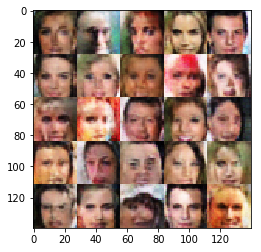

Epoch 3/10... Discriminator Loss: 1.3708... Generator Loss: 0.7568
Epoch 3/10... Discriminator Loss: 1.3873... Generator Loss: 0.7575
Epoch 3/10... Discriminator Loss: 1.3819... Generator Loss: 0.7919
Epoch 3/10... Discriminator Loss: 1.3750... Generator Loss: 0.7654
Epoch 3/10... Discriminator Loss: 1.3248... Generator Loss: 0.7964
Epoch 3/10... Discriminator Loss: 1.3784... Generator Loss: 0.7969
Epoch 3/10... Discriminator Loss: 1.3647... Generator Loss: 0.7663
Epoch 3/10... Discriminator Loss: 1.3520... Generator Loss: 0.7884
Epoch 3/10... Discriminator Loss: 1.3583... Generator Loss: 0.7977
Epoch 3/10... Discriminator Loss: 1.3614... Generator Loss: 0.7767


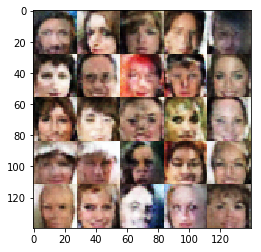

Epoch 3/10... Discriminator Loss: 1.3426... Generator Loss: 0.7838
Epoch 3/10... Discriminator Loss: 1.4001... Generator Loss: 0.7607
Epoch 3/10... Discriminator Loss: 1.3928... Generator Loss: 0.7572
Epoch 3/10... Discriminator Loss: 1.3463... Generator Loss: 0.7779
Epoch 3/10... Discriminator Loss: 1.3390... Generator Loss: 0.8013
Epoch 3/10... Discriminator Loss: 1.3839... Generator Loss: 0.7901
Epoch 3/10... Discriminator Loss: 1.3500... Generator Loss: 0.7768
Epoch 3/10... Discriminator Loss: 1.3661... Generator Loss: 0.7625
Epoch 3/10... Discriminator Loss: 1.3783... Generator Loss: 0.7435
Epoch 3/10... Discriminator Loss: 1.3521... Generator Loss: 0.7560


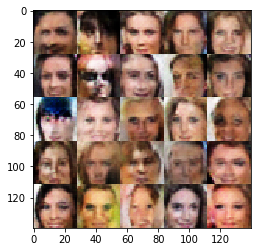

Epoch 3/10... Discriminator Loss: 1.3282... Generator Loss: 0.8159
Epoch 3/10... Discriminator Loss: 1.3899... Generator Loss: 0.7455
Epoch 3/10... Discriminator Loss: 1.3715... Generator Loss: 0.7623
Epoch 3/10... Discriminator Loss: 1.3462... Generator Loss: 0.7869
Epoch 3/10... Discriminator Loss: 1.3540... Generator Loss: 0.7713
Epoch 3/10... Discriminator Loss: 1.3320... Generator Loss: 0.8042
Epoch 3/10... Discriminator Loss: 1.4033... Generator Loss: 0.7645
Epoch 3/10... Discriminator Loss: 1.3716... Generator Loss: 0.7729
Epoch 3/10... Discriminator Loss: 1.3747... Generator Loss: 0.7705
Epoch 3/10... Discriminator Loss: 1.3432... Generator Loss: 0.7867


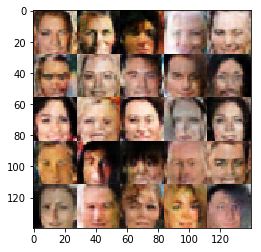

Epoch 3/10... Discriminator Loss: 1.2849... Generator Loss: 0.8101
Epoch 3/10... Discriminator Loss: 1.3197... Generator Loss: 0.8020
Epoch 3/10... Discriminator Loss: 1.3499... Generator Loss: 0.7849
Epoch 3/10... Discriminator Loss: 1.3307... Generator Loss: 0.8071
Epoch 3/10... Discriminator Loss: 1.3427... Generator Loss: 0.7901
Epoch 3/10... Discriminator Loss: 1.3404... Generator Loss: 0.7832
Epoch 3/10... Discriminator Loss: 1.3680... Generator Loss: 0.7763
Epoch 3/10... Discriminator Loss: 1.3026... Generator Loss: 0.8148
Epoch 3/10... Discriminator Loss: 1.3969... Generator Loss: 0.7426
Epoch 3/10... Discriminator Loss: 1.3686... Generator Loss: 0.7867


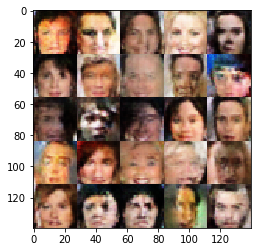

Epoch 3/10... Discriminator Loss: 1.3837... Generator Loss: 0.7673
Epoch 3/10... Discriminator Loss: 1.3408... Generator Loss: 0.7655
Epoch 3/10... Discriminator Loss: 1.3124... Generator Loss: 0.8198
Epoch 3/10... Discriminator Loss: 1.3785... Generator Loss: 0.7463
Epoch 3/10... Discriminator Loss: 1.3261... Generator Loss: 0.8023
Epoch 3/10... Discriminator Loss: 1.3469... Generator Loss: 0.7959
Epoch 3/10... Discriminator Loss: 1.3239... Generator Loss: 0.7594
Epoch 3/10... Discriminator Loss: 1.3465... Generator Loss: 0.7725
Epoch 3/10... Discriminator Loss: 1.3096... Generator Loss: 0.7971
Epoch 3/10... Discriminator Loss: 1.3808... Generator Loss: 0.8007


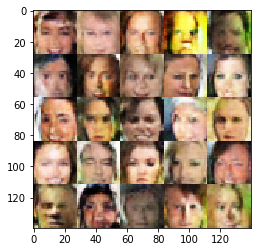

Epoch 3/10... Discriminator Loss: 1.3720... Generator Loss: 0.7494
Epoch 3/10... Discriminator Loss: 1.3858... Generator Loss: 0.7283
Epoch 3/10... Discriminator Loss: 1.3705... Generator Loss: 0.7531
Epoch 3/10... Discriminator Loss: 1.3292... Generator Loss: 0.7836
Epoch 3/10... Discriminator Loss: 1.3557... Generator Loss: 0.7698
Epoch 3/10... Discriminator Loss: 1.3528... Generator Loss: 0.7838
Epoch 3/10... Discriminator Loss: 1.3181... Generator Loss: 0.7861
Epoch 3/10... Discriminator Loss: 1.3270... Generator Loss: 0.8003
Epoch 3/10... Discriminator Loss: 1.3524... Generator Loss: 0.7779
Epoch 3/10... Discriminator Loss: 1.3989... Generator Loss: 0.7499


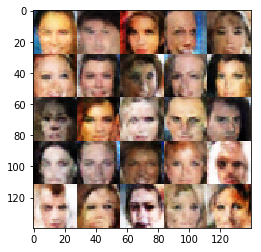

Epoch 3/10... Discriminator Loss: 1.3516... Generator Loss: 0.8067
Epoch 3/10... Discriminator Loss: 1.3091... Generator Loss: 0.8062
Epoch 3/10... Discriminator Loss: 1.3635... Generator Loss: 0.7701
Epoch 3/10... Discriminator Loss: 1.2812... Generator Loss: 0.8683
Epoch 3/10... Discriminator Loss: 1.3627... Generator Loss: 0.7525
Epoch 3/10... Discriminator Loss: 1.3300... Generator Loss: 0.7926
Epoch 3/10... Discriminator Loss: 1.3285... Generator Loss: 0.7793
Epoch 3/10... Discriminator Loss: 1.3233... Generator Loss: 0.7737
Epoch 3/10... Discriminator Loss: 1.2941... Generator Loss: 0.8520
Epoch 3/10... Discriminator Loss: 1.3119... Generator Loss: 0.9102


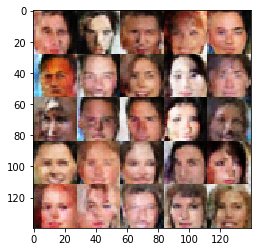

Epoch 3/10... Discriminator Loss: 1.3086... Generator Loss: 0.8473
Epoch 3/10... Discriminator Loss: 1.3535... Generator Loss: 0.7946
Epoch 3/10... Discriminator Loss: 1.3801... Generator Loss: 0.7799
Epoch 3/10... Discriminator Loss: 1.3093... Generator Loss: 0.8334
Epoch 3/10... Discriminator Loss: 1.3347... Generator Loss: 0.7609
Epoch 3/10... Discriminator Loss: 1.3330... Generator Loss: 0.8228
Epoch 3/10... Discriminator Loss: 1.2779... Generator Loss: 0.8276
Epoch 3/10... Discriminator Loss: 1.3612... Generator Loss: 0.7298
Epoch 3/10... Discriminator Loss: 1.2578... Generator Loss: 0.8376
Epoch 3/10... Discriminator Loss: 1.3162... Generator Loss: 0.8248


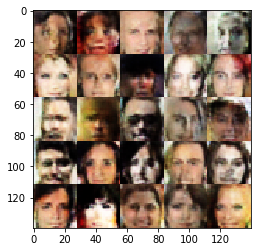

Epoch 3/10... Discriminator Loss: 1.3788... Generator Loss: 0.7862
Epoch 3/10... Discriminator Loss: 1.3519... Generator Loss: 0.8140
Epoch 3/10... Discriminator Loss: 1.3587... Generator Loss: 0.7428
Epoch 3/10... Discriminator Loss: 1.2865... Generator Loss: 0.8000
Epoch 3/10... Discriminator Loss: 1.3858... Generator Loss: 0.7693
Epoch 3/10... Discriminator Loss: 1.3279... Generator Loss: 0.8221
Epoch 3/10... Discriminator Loss: 1.3581... Generator Loss: 0.8132
Epoch 3/10... Discriminator Loss: 1.2614... Generator Loss: 0.8155
Epoch 3/10... Discriminator Loss: 1.3547... Generator Loss: 0.7775
Epoch 3/10... Discriminator Loss: 1.3404... Generator Loss: 0.7832


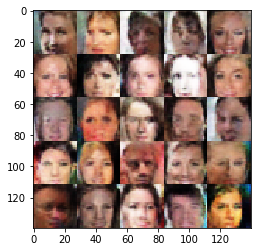

Epoch 3/10... Discriminator Loss: 1.3072... Generator Loss: 0.8815
Epoch 3/10... Discriminator Loss: 1.3766... Generator Loss: 0.7404
Epoch 3/10... Discriminator Loss: 1.3220... Generator Loss: 0.7997
Epoch 3/10... Discriminator Loss: 1.3610... Generator Loss: 0.7597
Epoch 3/10... Discriminator Loss: 1.3348... Generator Loss: 0.8602
Epoch 3/10... Discriminator Loss: 1.2197... Generator Loss: 0.9156
Epoch 3/10... Discriminator Loss: 1.3082... Generator Loss: 0.8344
Epoch 3/10... Discriminator Loss: 1.2303... Generator Loss: 0.9289
Epoch 3/10... Discriminator Loss: 1.3202... Generator Loss: 0.7639
Epoch 3/10... Discriminator Loss: 1.3156... Generator Loss: 0.8390


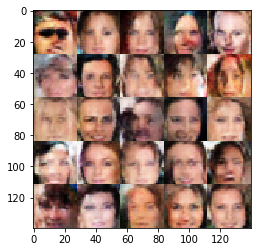

Epoch 3/10... Discriminator Loss: 1.2623... Generator Loss: 0.8547
Epoch 3/10... Discriminator Loss: 1.3098... Generator Loss: 0.7745
Epoch 3/10... Discriminator Loss: 1.3237... Generator Loss: 0.8481
Epoch 3/10... Discriminator Loss: 1.3067... Generator Loss: 0.8397
Epoch 3/10... Discriminator Loss: 1.3194... Generator Loss: 0.7714
Epoch 3/10... Discriminator Loss: 1.3274... Generator Loss: 0.7564
Epoch 3/10... Discriminator Loss: 1.3415... Generator Loss: 0.8063
Epoch 3/10... Discriminator Loss: 1.3033... Generator Loss: 0.8502
Epoch 3/10... Discriminator Loss: 1.3260... Generator Loss: 0.8071
Epoch 3/10... Discriminator Loss: 1.3470... Generator Loss: 0.7835


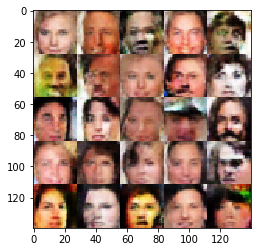

Epoch 3/10... Discriminator Loss: 1.3273... Generator Loss: 0.8280
Epoch 3/10... Discriminator Loss: 1.1990... Generator Loss: 0.9314
Epoch 3/10... Discriminator Loss: 1.3124... Generator Loss: 0.7794
Epoch 3/10... Discriminator Loss: 1.2975... Generator Loss: 0.7981
Epoch 3/10... Discriminator Loss: 1.5525... Generator Loss: 0.8061
Epoch 3/10... Discriminator Loss: 1.3669... Generator Loss: 0.7446
Epoch 3/10... Discriminator Loss: 1.2617... Generator Loss: 0.8864
Epoch 3/10... Discriminator Loss: 1.3586... Generator Loss: 0.7751
Epoch 3/10... Discriminator Loss: 1.2398... Generator Loss: 0.8948
Epoch 3/10... Discriminator Loss: 1.3168... Generator Loss: 0.8335


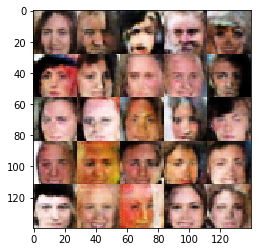

Epoch 3/10... Discriminator Loss: 1.2170... Generator Loss: 0.9731
Epoch 3/10... Discriminator Loss: 1.3145... Generator Loss: 0.8686
Epoch 3/10... Discriminator Loss: 1.3033... Generator Loss: 0.7541
Epoch 3/10... Discriminator Loss: 1.3099... Generator Loss: 0.7845
Epoch 3/10... Discriminator Loss: 1.2755... Generator Loss: 0.8656
Epoch 3/10... Discriminator Loss: 1.2615... Generator Loss: 0.8511
Epoch 3/10... Discriminator Loss: 1.2832... Generator Loss: 0.8047
Epoch 3/10... Discriminator Loss: 1.2572... Generator Loss: 0.8477
Epoch 3/10... Discriminator Loss: 1.2918... Generator Loss: 0.7124
Epoch 3/10... Discriminator Loss: 1.3294... Generator Loss: 0.7800


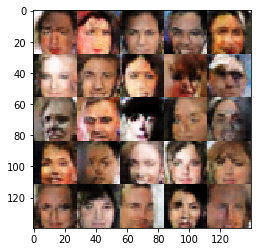

Epoch 3/10... Discriminator Loss: 1.2560... Generator Loss: 0.8359
Epoch 3/10... Discriminator Loss: 1.3026... Generator Loss: 0.9212
Epoch 3/10... Discriminator Loss: 1.4333... Generator Loss: 0.8774
Epoch 3/10... Discriminator Loss: 1.3245... Generator Loss: 0.8376
Epoch 3/10... Discriminator Loss: 1.2758... Generator Loss: 0.8797
Epoch 3/10... Discriminator Loss: 1.2426... Generator Loss: 0.8798
Epoch 3/10... Discriminator Loss: 1.2962... Generator Loss: 0.8500
Epoch 3/10... Discriminator Loss: 1.2818... Generator Loss: 0.8152
Epoch 3/10... Discriminator Loss: 1.2401... Generator Loss: 0.8912
Epoch 3/10... Discriminator Loss: 1.3130... Generator Loss: 0.7600


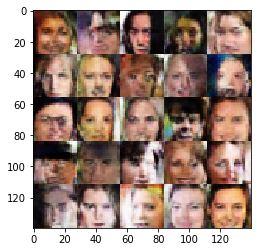

Epoch 3/10... Discriminator Loss: 1.2681... Generator Loss: 0.8635
Epoch 3/10... Discriminator Loss: 1.1984... Generator Loss: 0.9097
Epoch 3/10... Discriminator Loss: 1.3443... Generator Loss: 0.6824
Epoch 3/10... Discriminator Loss: 1.2679... Generator Loss: 0.8166
Epoch 3/10... Discriminator Loss: 1.3369... Generator Loss: 0.7702
Epoch 3/10... Discriminator Loss: 1.3414... Generator Loss: 0.7258
Epoch 3/10... Discriminator Loss: 1.2793... Generator Loss: 0.7776
Epoch 3/10... Discriminator Loss: 1.2823... Generator Loss: 0.8183
Epoch 3/10... Discriminator Loss: 1.2463... Generator Loss: 0.8458
Epoch 3/10... Discriminator Loss: 1.3715... Generator Loss: 0.7596


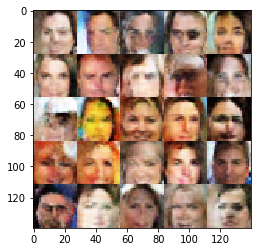

Epoch 3/10... Discriminator Loss: 1.1678... Generator Loss: 0.9374
Epoch 3/10... Discriminator Loss: 1.1972... Generator Loss: 0.8724
Epoch 3/10... Discriminator Loss: 1.3430... Generator Loss: 0.7427
Epoch 3/10... Discriminator Loss: 1.2984... Generator Loss: 0.7754
Epoch 3/10... Discriminator Loss: 1.2629... Generator Loss: 0.8165
Epoch 3/10... Discriminator Loss: 1.2734... Generator Loss: 0.7494
Epoch 3/10... Discriminator Loss: 1.2615... Generator Loss: 0.8519
Epoch 3/10... Discriminator Loss: 1.2253... Generator Loss: 0.8679
Epoch 3/10... Discriminator Loss: 1.2811... Generator Loss: 0.7770
Epoch 3/10... Discriminator Loss: 1.1198... Generator Loss: 0.9671


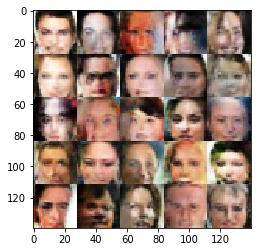

Epoch 3/10... Discriminator Loss: 1.3537... Generator Loss: 0.7350
Epoch 3/10... Discriminator Loss: 1.3067... Generator Loss: 0.7837
Epoch 3/10... Discriminator Loss: 1.2069... Generator Loss: 0.8406
Epoch 3/10... Discriminator Loss: 1.3044... Generator Loss: 0.7936
Epoch 3/10... Discriminator Loss: 1.2851... Generator Loss: 0.7862
Epoch 3/10... Discriminator Loss: 1.2937... Generator Loss: 0.7976
Epoch 3/10... Discriminator Loss: 1.1747... Generator Loss: 0.9499
Epoch 3/10... Discriminator Loss: 1.2649... Generator Loss: 0.8617
Epoch 3/10... Discriminator Loss: 1.2276... Generator Loss: 0.8989
Epoch 3/10... Discriminator Loss: 1.2536... Generator Loss: 0.9643


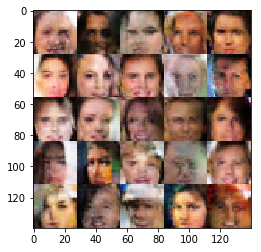

Epoch 3/10... Discriminator Loss: 1.3361... Generator Loss: 0.7830
Epoch 3/10... Discriminator Loss: 1.2641... Generator Loss: 0.7969
Epoch 3/10... Discriminator Loss: 1.2384... Generator Loss: 0.8512
Epoch 3/10... Discriminator Loss: 1.2222... Generator Loss: 0.8229
Epoch 3/10... Discriminator Loss: 1.2938... Generator Loss: 0.8020
Epoch 3/10... Discriminator Loss: 1.4251... Generator Loss: 0.7896
Epoch 3/10... Discriminator Loss: 1.2284... Generator Loss: 0.9769
Epoch 3/10... Discriminator Loss: 1.3055... Generator Loss: 0.7921
Epoch 3/10... Discriminator Loss: 1.2717... Generator Loss: 0.9097
Epoch 3/10... Discriminator Loss: 1.2139... Generator Loss: 0.8455


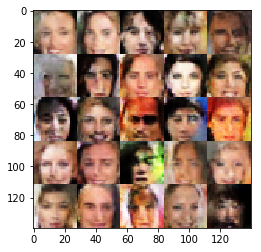

Epoch 3/10... Discriminator Loss: 1.0850... Generator Loss: 0.9853
Epoch 3/10... Discriminator Loss: 1.3108... Generator Loss: 0.7774
Epoch 3/10... Discriminator Loss: 1.2762... Generator Loss: 0.8305
Epoch 3/10... Discriminator Loss: 1.2355... Generator Loss: 0.8812
Epoch 3/10... Discriminator Loss: 1.2371... Generator Loss: 0.8883
Epoch 3/10... Discriminator Loss: 1.2130... Generator Loss: 0.8801
Epoch 3/10... Discriminator Loss: 1.2946... Generator Loss: 0.8140
Epoch 3/10... Discriminator Loss: 1.1730... Generator Loss: 0.8602
Epoch 3/10... Discriminator Loss: 1.2428... Generator Loss: 0.8653
Epoch 3/10... Discriminator Loss: 1.2684... Generator Loss: 0.9054


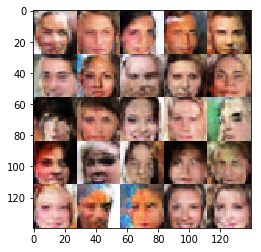

Epoch 3/10... Discriminator Loss: 1.2133... Generator Loss: 0.9363
Epoch 3/10... Discriminator Loss: 1.2724... Generator Loss: 0.8734
Epoch 3/10... Discriminator Loss: 1.3006... Generator Loss: 0.7844
Epoch 3/10... Discriminator Loss: 1.1754... Generator Loss: 0.9533
Epoch 3/10... Discriminator Loss: 1.1713... Generator Loss: 0.9265
Epoch 3/10... Discriminator Loss: 1.3448... Generator Loss: 0.7599
Epoch 3/10... Discriminator Loss: 1.4186... Generator Loss: 0.9092
Epoch 3/10... Discriminator Loss: 1.2499... Generator Loss: 0.8472
Epoch 3/10... Discriminator Loss: 1.1808... Generator Loss: 1.0011
Epoch 3/10... Discriminator Loss: 1.2001... Generator Loss: 0.8449


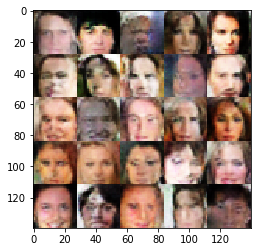

Epoch 3/10... Discriminator Loss: 1.2607... Generator Loss: 0.8557
Epoch 3/10... Discriminator Loss: 1.2858... Generator Loss: 0.7478
Epoch 3/10... Discriminator Loss: 1.2550... Generator Loss: 0.8350
Epoch 3/10... Discriminator Loss: 1.2744... Generator Loss: 0.7798
Epoch 3/10... Discriminator Loss: 1.1426... Generator Loss: 0.9774
Epoch 3/10... Discriminator Loss: 1.2341... Generator Loss: 0.8165
Epoch 3/10... Discriminator Loss: 1.1627... Generator Loss: 0.9238
Epoch 3/10... Discriminator Loss: 1.2889... Generator Loss: 0.7952
Epoch 3/10... Discriminator Loss: 1.1522... Generator Loss: 0.9833
Epoch 3/10... Discriminator Loss: 1.2219... Generator Loss: 0.8334


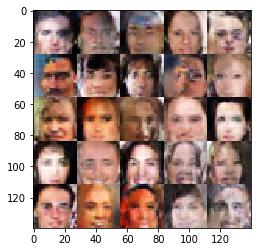

Epoch 3/10... Discriminator Loss: 1.2630... Generator Loss: 0.8393
Epoch 3/10... Discriminator Loss: 1.1648... Generator Loss: 0.9536
Epoch 3/10... Discriminator Loss: 1.2560... Generator Loss: 0.8629
Epoch 3/10... Discriminator Loss: 1.3384... Generator Loss: 0.7829
Epoch 3/10... Discriminator Loss: 1.2634... Generator Loss: 0.8610
Epoch 3/10... Discriminator Loss: 1.3303... Generator Loss: 0.8116
Epoch 3/10... Discriminator Loss: 1.2475... Generator Loss: 0.9182
Epoch 3/10... Discriminator Loss: 1.2520... Generator Loss: 0.7898
Epoch 3/10... Discriminator Loss: 1.1649... Generator Loss: 1.0490
Epoch 3/10... Discriminator Loss: 1.2547... Generator Loss: 0.8418


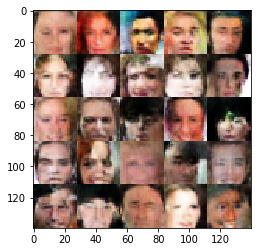

Epoch 3/10... Discriminator Loss: 1.2119... Generator Loss: 0.8944
Epoch 3/10... Discriminator Loss: 1.2044... Generator Loss: 0.8583
Epoch 3/10... Discriminator Loss: 2.1116... Generator Loss: 1.1617
Epoch 3/10... Discriminator Loss: 1.3153... Generator Loss: 0.7859
Epoch 3/10... Discriminator Loss: 1.1855... Generator Loss: 0.9808
Epoch 3/10... Discriminator Loss: 1.1556... Generator Loss: 0.9083
Epoch 3/10... Discriminator Loss: 1.3703... Generator Loss: 1.0067
Epoch 3/10... Discriminator Loss: 1.2751... Generator Loss: 0.8460
Epoch 3/10... Discriminator Loss: 1.2154... Generator Loss: 0.8064
Epoch 3/10... Discriminator Loss: 1.2541... Generator Loss: 0.8236


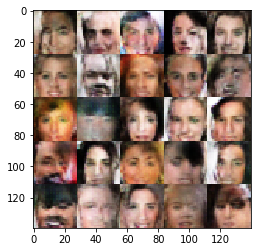

Epoch 3/10... Discriminator Loss: 1.3461... Generator Loss: 0.7744
Epoch 3/10... Discriminator Loss: 1.2030... Generator Loss: 0.9122
Epoch 3/10... Discriminator Loss: 1.2020... Generator Loss: 0.9409
Epoch 3/10... Discriminator Loss: 1.1596... Generator Loss: 0.9115
Epoch 3/10... Discriminator Loss: 1.2876... Generator Loss: 0.8011
Epoch 3/10... Discriminator Loss: 1.2460... Generator Loss: 0.8036
Epoch 3/10... Discriminator Loss: 1.1626... Generator Loss: 0.9469
Epoch 3/10... Discriminator Loss: 1.3075... Generator Loss: 0.7822
Epoch 3/10... Discriminator Loss: 1.2816... Generator Loss: 0.8978
Epoch 3/10... Discriminator Loss: 1.3910... Generator Loss: 0.8740


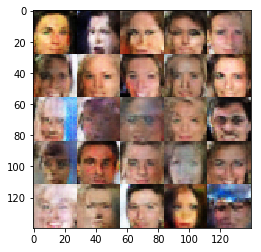

Epoch 3/10... Discriminator Loss: 1.2388... Generator Loss: 0.8892
Epoch 3/10... Discriminator Loss: 1.2738... Generator Loss: 0.7993
Epoch 3/10... Discriminator Loss: 1.3144... Generator Loss: 0.8597
Epoch 3/10... Discriminator Loss: 1.2887... Generator Loss: 0.7927
Epoch 3/10... Discriminator Loss: 1.3492... Generator Loss: 0.7706
Epoch 3/10... Discriminator Loss: 1.1630... Generator Loss: 0.8737
Epoch 3/10... Discriminator Loss: 1.3707... Generator Loss: 0.7778
Epoch 3/10... Discriminator Loss: 1.2385... Generator Loss: 0.8537
Epoch 3/10... Discriminator Loss: 1.2242... Generator Loss: 0.9162
Epoch 3/10... Discriminator Loss: 1.2254... Generator Loss: 0.8891


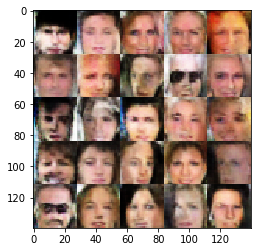

Epoch 3/10... Discriminator Loss: 1.2529... Generator Loss: 0.8298
Epoch 3/10... Discriminator Loss: 1.1725... Generator Loss: 0.9913
Epoch 3/10... Discriminator Loss: 1.3021... Generator Loss: 0.7577
Epoch 3/10... Discriminator Loss: 1.1049... Generator Loss: 0.9501
Epoch 3/10... Discriminator Loss: 1.2725... Generator Loss: 0.8667
Epoch 3/10... Discriminator Loss: 1.3569... Generator Loss: 0.7063
Epoch 3/10... Discriminator Loss: 1.2385... Generator Loss: 0.8682
Epoch 3/10... Discriminator Loss: 1.3953... Generator Loss: 0.6470
Epoch 3/10... Discriminator Loss: 1.3355... Generator Loss: 0.7898
Epoch 3/10... Discriminator Loss: 1.2826... Generator Loss: 0.8361


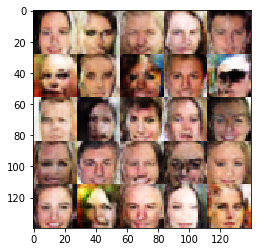

Epoch 3/10... Discriminator Loss: 1.1822... Generator Loss: 0.9100
Epoch 3/10... Discriminator Loss: 1.2214... Generator Loss: 0.9005
Epoch 3/10... Discriminator Loss: 1.2669... Generator Loss: 0.8061
Epoch 3/10... Discriminator Loss: 1.3402... Generator Loss: 0.7771
Epoch 3/10... Discriminator Loss: 1.2733... Generator Loss: 0.8398
Epoch 3/10... Discriminator Loss: 1.1825... Generator Loss: 0.8734
Epoch 3/10... Discriminator Loss: 1.3646... Generator Loss: 0.7548
Epoch 3/10... Discriminator Loss: 1.2694... Generator Loss: 0.8493
Epoch 3/10... Discriminator Loss: 1.2871... Generator Loss: 0.7647
Epoch 3/10... Discriminator Loss: 1.1269... Generator Loss: 0.9740


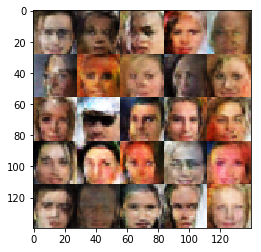

Epoch 3/10... Discriminator Loss: 1.2389... Generator Loss: 0.8782
Epoch 3/10... Discriminator Loss: 1.3215... Generator Loss: 0.7991
Epoch 3/10... Discriminator Loss: 1.2445... Generator Loss: 0.8037
Epoch 3/10... Discriminator Loss: 1.2875... Generator Loss: 0.7690
Epoch 3/10... Discriminator Loss: 1.3271... Generator Loss: 0.7373
Epoch 3/10... Discriminator Loss: 1.3593... Generator Loss: 0.7535
Epoch 3/10... Discriminator Loss: 1.2256... Generator Loss: 0.8949
Epoch 3/10... Discriminator Loss: 1.1525... Generator Loss: 0.9050
Epoch 3/10... Discriminator Loss: 1.3076... Generator Loss: 0.7729
Epoch 3/10... Discriminator Loss: 1.4864... Generator Loss: 0.7541


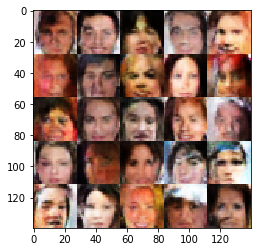

Epoch 3/10... Discriminator Loss: 1.2882... Generator Loss: 0.7656
Epoch 3/10... Discriminator Loss: 1.2023... Generator Loss: 0.9353
Epoch 3/10... Discriminator Loss: 1.2790... Generator Loss: 0.8199
Epoch 3/10... Discriminator Loss: 1.3158... Generator Loss: 0.7854
Epoch 3/10... Discriminator Loss: 1.3328... Generator Loss: 0.8410
Epoch 3/10... Discriminator Loss: 1.3271... Generator Loss: 0.7524
Epoch 3/10... Discriminator Loss: 1.3121... Generator Loss: 0.8203
Epoch 3/10... Discriminator Loss: 1.1912... Generator Loss: 0.8353
Epoch 3/10... Discriminator Loss: 1.4851... Generator Loss: 0.6899
Epoch 3/10... Discriminator Loss: 1.3914... Generator Loss: 0.6650


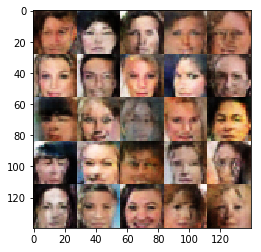

Epoch 3/10... Discriminator Loss: 1.2551... Generator Loss: 0.8127
Epoch 3/10... Discriminator Loss: 1.2663... Generator Loss: 0.7985
Epoch 3/10... Discriminator Loss: 1.2969... Generator Loss: 0.7873
Epoch 3/10... Discriminator Loss: 1.2753... Generator Loss: 0.8372
Epoch 3/10... Discriminator Loss: 1.2774... Generator Loss: 0.8013
Epoch 3/10... Discriminator Loss: 1.1490... Generator Loss: 0.9218
Epoch 3/10... Discriminator Loss: 1.2915... Generator Loss: 0.7862
Epoch 3/10... Discriminator Loss: 1.2058... Generator Loss: 0.9170
Epoch 3/10... Discriminator Loss: 1.2419... Generator Loss: 0.8551
Epoch 4/10... Discriminator Loss: 1.2091... Generator Loss: 0.8482


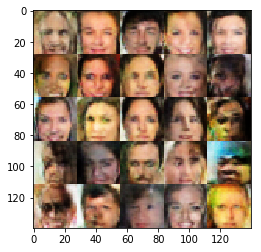

Epoch 4/10... Discriminator Loss: 1.2399... Generator Loss: 0.8099
Epoch 4/10... Discriminator Loss: 1.3548... Generator Loss: 0.7397
Epoch 4/10... Discriminator Loss: 1.3359... Generator Loss: 0.7225
Epoch 4/10... Discriminator Loss: 1.2566... Generator Loss: 0.8287
Epoch 4/10... Discriminator Loss: 1.2551... Generator Loss: 0.8325
Epoch 4/10... Discriminator Loss: 1.2312... Generator Loss: 0.8694
Epoch 4/10... Discriminator Loss: 1.2836... Generator Loss: 0.8633
Epoch 4/10... Discriminator Loss: 1.3397... Generator Loss: 0.8067
Epoch 4/10... Discriminator Loss: 1.2849... Generator Loss: 0.7361
Epoch 4/10... Discriminator Loss: 1.2163... Generator Loss: 0.8276


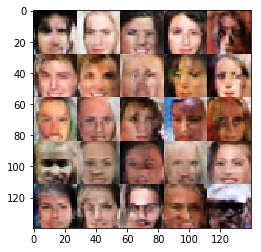

Epoch 4/10... Discriminator Loss: 1.2858... Generator Loss: 0.7559
Epoch 4/10... Discriminator Loss: 1.1775... Generator Loss: 0.8640
Epoch 4/10... Discriminator Loss: 1.2578... Generator Loss: 0.9236
Epoch 4/10... Discriminator Loss: 1.2288... Generator Loss: 0.9320
Epoch 4/10... Discriminator Loss: 1.2093... Generator Loss: 0.9273
Epoch 4/10... Discriminator Loss: 1.2123... Generator Loss: 0.8853
Epoch 4/10... Discriminator Loss: 1.3326... Generator Loss: 0.7341
Epoch 4/10... Discriminator Loss: 1.2339... Generator Loss: 0.7968
Epoch 4/10... Discriminator Loss: 1.2289... Generator Loss: 0.8276
Epoch 4/10... Discriminator Loss: 1.3379... Generator Loss: 0.7602


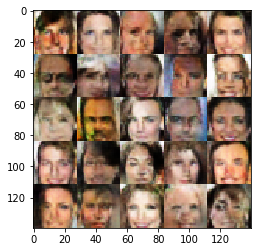

Epoch 4/10... Discriminator Loss: 1.2389... Generator Loss: 0.8602
Epoch 4/10... Discriminator Loss: 1.2131... Generator Loss: 0.8264
Epoch 4/10... Discriminator Loss: 1.4037... Generator Loss: 0.7881
Epoch 4/10... Discriminator Loss: 1.1854... Generator Loss: 0.9185
Epoch 4/10... Discriminator Loss: 1.3412... Generator Loss: 0.6802
Epoch 4/10... Discriminator Loss: 1.2482... Generator Loss: 0.9034
Epoch 4/10... Discriminator Loss: 1.2099... Generator Loss: 0.9078
Epoch 4/10... Discriminator Loss: 1.1257... Generator Loss: 0.8900
Epoch 4/10... Discriminator Loss: 1.2824... Generator Loss: 0.9003
Epoch 4/10... Discriminator Loss: 1.2526... Generator Loss: 0.8250


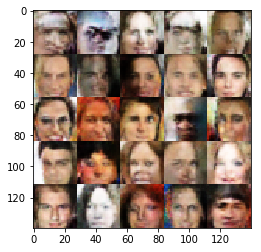

Epoch 4/10... Discriminator Loss: 1.1699... Generator Loss: 0.9495
Epoch 4/10... Discriminator Loss: 1.3124... Generator Loss: 0.7204
Epoch 4/10... Discriminator Loss: 1.1678... Generator Loss: 0.8998
Epoch 4/10... Discriminator Loss: 1.2255... Generator Loss: 0.9016
Epoch 4/10... Discriminator Loss: 1.2793... Generator Loss: 0.7894
Epoch 4/10... Discriminator Loss: 1.3042... Generator Loss: 0.7705
Epoch 4/10... Discriminator Loss: 1.2503... Generator Loss: 0.8837
Epoch 4/10... Discriminator Loss: 1.1773... Generator Loss: 0.8208
Epoch 4/10... Discriminator Loss: 1.2042... Generator Loss: 0.9018
Epoch 4/10... Discriminator Loss: 1.2438... Generator Loss: 0.8800


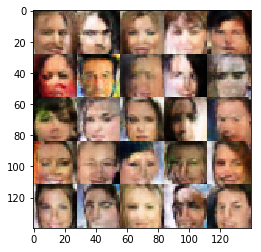

Epoch 4/10... Discriminator Loss: 1.2149... Generator Loss: 0.8511
Epoch 4/10... Discriminator Loss: 1.2629... Generator Loss: 0.8102
Epoch 4/10... Discriminator Loss: 1.1415... Generator Loss: 1.0225
Epoch 4/10... Discriminator Loss: 1.1856... Generator Loss: 0.9816
Epoch 4/10... Discriminator Loss: 1.1617... Generator Loss: 0.9028
Epoch 4/10... Discriminator Loss: 1.2792... Generator Loss: 0.8290
Epoch 4/10... Discriminator Loss: 1.2852... Generator Loss: 0.7802
Epoch 4/10... Discriminator Loss: 1.2830... Generator Loss: 0.7996
Epoch 4/10... Discriminator Loss: 1.3766... Generator Loss: 0.7413
Epoch 4/10... Discriminator Loss: 1.2604... Generator Loss: 0.8131


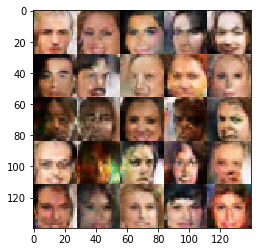

Epoch 4/10... Discriminator Loss: 1.3271... Generator Loss: 0.7952
Epoch 4/10... Discriminator Loss: 1.2144... Generator Loss: 0.8294
Epoch 4/10... Discriminator Loss: 1.1629... Generator Loss: 0.9313
Epoch 4/10... Discriminator Loss: 1.2164... Generator Loss: 0.8068
Epoch 4/10... Discriminator Loss: 1.3017... Generator Loss: 0.7936
Epoch 4/10... Discriminator Loss: 1.2390... Generator Loss: 0.8045
Epoch 4/10... Discriminator Loss: 1.3264... Generator Loss: 0.7901
Epoch 4/10... Discriminator Loss: 1.1400... Generator Loss: 0.9709
Epoch 4/10... Discriminator Loss: 1.2378... Generator Loss: 0.8666
Epoch 4/10... Discriminator Loss: 1.3547... Generator Loss: 0.7965


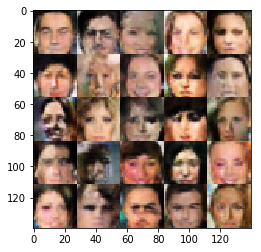

Epoch 4/10... Discriminator Loss: 1.2137... Generator Loss: 0.9235
Epoch 4/10... Discriminator Loss: 1.1710... Generator Loss: 0.9033
Epoch 4/10... Discriminator Loss: 1.2162... Generator Loss: 0.8918
Epoch 4/10... Discriminator Loss: 1.3135... Generator Loss: 0.8012
Epoch 4/10... Discriminator Loss: 1.1537... Generator Loss: 0.8715
Epoch 4/10... Discriminator Loss: 1.3543... Generator Loss: 0.7894
Epoch 4/10... Discriminator Loss: 1.1722... Generator Loss: 0.8868
Epoch 4/10... Discriminator Loss: 1.1848... Generator Loss: 0.8442
Epoch 4/10... Discriminator Loss: 1.2787... Generator Loss: 0.8117
Epoch 4/10... Discriminator Loss: 1.1459... Generator Loss: 0.9860


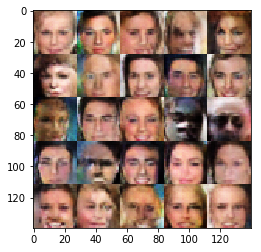

Epoch 4/10... Discriminator Loss: 1.2058... Generator Loss: 0.8612
Epoch 4/10... Discriminator Loss: 1.2336... Generator Loss: 0.8809
Epoch 4/10... Discriminator Loss: 1.2144... Generator Loss: 0.8545
Epoch 4/10... Discriminator Loss: 1.2128... Generator Loss: 0.8238
Epoch 4/10... Discriminator Loss: 1.2159... Generator Loss: 0.8529
Epoch 4/10... Discriminator Loss: 1.1388... Generator Loss: 1.0066
Epoch 4/10... Discriminator Loss: 1.1646... Generator Loss: 0.9334
Epoch 4/10... Discriminator Loss: 1.2081... Generator Loss: 0.8752
Epoch 4/10... Discriminator Loss: 1.2045... Generator Loss: 0.8341
Epoch 4/10... Discriminator Loss: 1.2983... Generator Loss: 0.7726


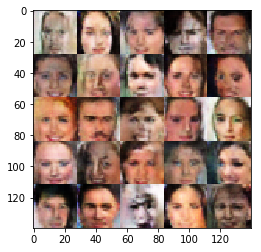

Epoch 4/10... Discriminator Loss: 1.2447... Generator Loss: 0.7840
Epoch 4/10... Discriminator Loss: 1.2466... Generator Loss: 0.9925
Epoch 4/10... Discriminator Loss: 3.1921... Generator Loss: 0.9897
Epoch 4/10... Discriminator Loss: 1.3965... Generator Loss: 0.7885
Epoch 4/10... Discriminator Loss: 1.8637... Generator Loss: 0.9745
Epoch 4/10... Discriminator Loss: 1.2794... Generator Loss: 0.8217
Epoch 4/10... Discriminator Loss: 1.3164... Generator Loss: 0.7362
Epoch 4/10... Discriminator Loss: 1.2718... Generator Loss: 0.8824
Epoch 4/10... Discriminator Loss: 1.2611... Generator Loss: 0.8326
Epoch 4/10... Discriminator Loss: 1.2543... Generator Loss: 0.8174


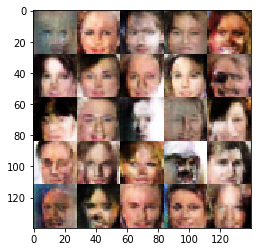

Epoch 4/10... Discriminator Loss: 1.2657... Generator Loss: 0.8613
Epoch 4/10... Discriminator Loss: 1.1868... Generator Loss: 0.8852
Epoch 4/10... Discriminator Loss: 1.2605... Generator Loss: 0.7874
Epoch 4/10... Discriminator Loss: 1.3158... Generator Loss: 0.7368
Epoch 4/10... Discriminator Loss: 1.3643... Generator Loss: 0.7215
Epoch 4/10... Discriminator Loss: 1.2179... Generator Loss: 0.8714
Epoch 4/10... Discriminator Loss: 1.2835... Generator Loss: 0.7722
Epoch 4/10... Discriminator Loss: 1.2828... Generator Loss: 0.7661
Epoch 4/10... Discriminator Loss: 1.2886... Generator Loss: 0.7966
Epoch 4/10... Discriminator Loss: 1.1736... Generator Loss: 0.8521


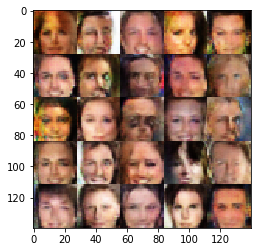

Epoch 4/10... Discriminator Loss: 1.3994... Generator Loss: 0.7304
Epoch 4/10... Discriminator Loss: 1.2296... Generator Loss: 0.8281
Epoch 4/10... Discriminator Loss: 1.1708... Generator Loss: 0.9651
Epoch 4/10... Discriminator Loss: 1.2605... Generator Loss: 0.8062
Epoch 4/10... Discriminator Loss: 1.2190... Generator Loss: 0.8830
Epoch 4/10... Discriminator Loss: 1.1917... Generator Loss: 0.8456
Epoch 4/10... Discriminator Loss: 1.2881... Generator Loss: 0.8423
Epoch 4/10... Discriminator Loss: 1.1358... Generator Loss: 0.8687
Epoch 4/10... Discriminator Loss: 1.2814... Generator Loss: 0.8127
Epoch 4/10... Discriminator Loss: 1.1035... Generator Loss: 1.0640


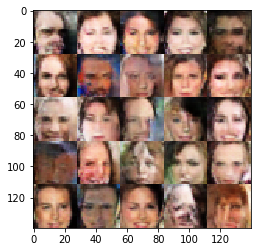

Epoch 4/10... Discriminator Loss: 1.2150... Generator Loss: 0.8149
Epoch 4/10... Discriminator Loss: 1.2612... Generator Loss: 0.8305
Epoch 4/10... Discriminator Loss: 1.1184... Generator Loss: 0.9825
Epoch 4/10... Discriminator Loss: 1.3103... Generator Loss: 0.7750
Epoch 4/10... Discriminator Loss: 1.2228... Generator Loss: 0.8809
Epoch 4/10... Discriminator Loss: 1.2181... Generator Loss: 0.8288
Epoch 4/10... Discriminator Loss: 1.1970... Generator Loss: 0.8296
Epoch 4/10... Discriminator Loss: 1.1935... Generator Loss: 0.8846
Epoch 4/10... Discriminator Loss: 1.1847... Generator Loss: 0.9147
Epoch 4/10... Discriminator Loss: 1.2014... Generator Loss: 0.8741


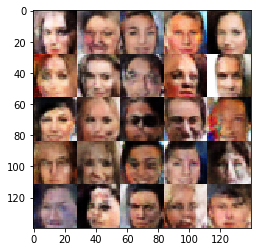

Epoch 4/10... Discriminator Loss: 1.1440... Generator Loss: 0.9553
Epoch 4/10... Discriminator Loss: 1.2974... Generator Loss: 0.7376
Epoch 4/10... Discriminator Loss: 1.2585... Generator Loss: 0.8399
Epoch 4/10... Discriminator Loss: 1.1868... Generator Loss: 0.8660
Epoch 4/10... Discriminator Loss: 1.3625... Generator Loss: 0.7342
Epoch 4/10... Discriminator Loss: 1.1001... Generator Loss: 0.9885
Epoch 4/10... Discriminator Loss: 1.2441... Generator Loss: 0.8985
Epoch 4/10... Discriminator Loss: 1.4337... Generator Loss: 0.6643
Epoch 4/10... Discriminator Loss: 1.0127... Generator Loss: 1.2612
Epoch 4/10... Discriminator Loss: 1.2618... Generator Loss: 0.8171


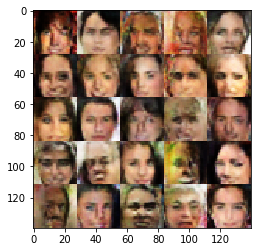

Epoch 4/10... Discriminator Loss: 1.2188... Generator Loss: 0.8727
Epoch 4/10... Discriminator Loss: 1.2655... Generator Loss: 0.7100
Epoch 4/10... Discriminator Loss: 1.2128... Generator Loss: 0.9167
Epoch 4/10... Discriminator Loss: 1.2453... Generator Loss: 0.8026
Epoch 4/10... Discriminator Loss: 1.2462... Generator Loss: 0.8463
Epoch 4/10... Discriminator Loss: 1.1957... Generator Loss: 0.8387
Epoch 4/10... Discriminator Loss: 1.2491... Generator Loss: 0.8976
Epoch 4/10... Discriminator Loss: 1.2022... Generator Loss: 0.9406
Epoch 4/10... Discriminator Loss: 1.2333... Generator Loss: 0.8509
Epoch 4/10... Discriminator Loss: 1.3540... Generator Loss: 0.7386


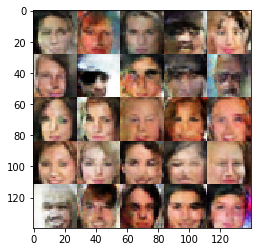

Epoch 4/10... Discriminator Loss: 1.1740... Generator Loss: 0.8593
Epoch 4/10... Discriminator Loss: 1.3127... Generator Loss: 0.7056
Epoch 4/10... Discriminator Loss: 1.1999... Generator Loss: 0.8458
Epoch 4/10... Discriminator Loss: 1.2918... Generator Loss: 0.7630
Epoch 4/10... Discriminator Loss: 1.0981... Generator Loss: 0.9822
Epoch 4/10... Discriminator Loss: 1.1884... Generator Loss: 0.9768
Epoch 4/10... Discriminator Loss: 1.2995... Generator Loss: 0.8268
Epoch 4/10... Discriminator Loss: 1.2040... Generator Loss: 0.9066
Epoch 4/10... Discriminator Loss: 1.3406... Generator Loss: 0.8279
Epoch 4/10... Discriminator Loss: 1.1539... Generator Loss: 0.9085


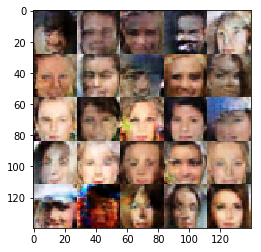

Epoch 4/10... Discriminator Loss: 1.2794... Generator Loss: 0.8406
Epoch 4/10... Discriminator Loss: 1.3359... Generator Loss: 0.7421
Epoch 4/10... Discriminator Loss: 1.2131... Generator Loss: 0.8444
Epoch 4/10... Discriminator Loss: 1.2470... Generator Loss: 0.7976
Epoch 4/10... Discriminator Loss: 1.2748... Generator Loss: 0.7883
Epoch 4/10... Discriminator Loss: 1.2542... Generator Loss: 0.7586
Epoch 4/10... Discriminator Loss: 1.1237... Generator Loss: 1.0328
Epoch 4/10... Discriminator Loss: 1.2640... Generator Loss: 0.8617
Epoch 4/10... Discriminator Loss: 1.1382... Generator Loss: 0.9080
Epoch 4/10... Discriminator Loss: 1.2263... Generator Loss: 0.8723


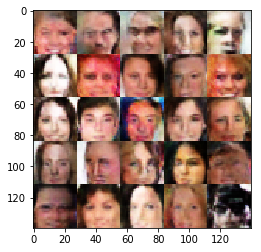

Epoch 4/10... Discriminator Loss: 1.3166... Generator Loss: 0.7265
Epoch 4/10... Discriminator Loss: 1.1651... Generator Loss: 1.0290
Epoch 4/10... Discriminator Loss: 1.2175... Generator Loss: 0.8681
Epoch 4/10... Discriminator Loss: 1.3446... Generator Loss: 0.7550
Epoch 4/10... Discriminator Loss: 1.3626... Generator Loss: 0.8025
Epoch 4/10... Discriminator Loss: 1.2785... Generator Loss: 0.7424
Epoch 4/10... Discriminator Loss: 1.3538... Generator Loss: 0.7722
Epoch 4/10... Discriminator Loss: 1.2726... Generator Loss: 0.7265
Epoch 4/10... Discriminator Loss: 1.2655... Generator Loss: 0.7542
Epoch 4/10... Discriminator Loss: 1.2805... Generator Loss: 0.8462


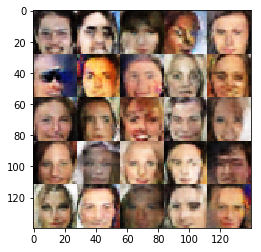

Epoch 4/10... Discriminator Loss: 1.0752... Generator Loss: 1.0545
Epoch 4/10... Discriminator Loss: 1.1967... Generator Loss: 0.8534
Epoch 4/10... Discriminator Loss: 1.3111... Generator Loss: 0.8228
Epoch 4/10... Discriminator Loss: 1.1841... Generator Loss: 0.9034
Epoch 4/10... Discriminator Loss: 1.1795... Generator Loss: 0.8734
Epoch 4/10... Discriminator Loss: 1.1462... Generator Loss: 0.9248
Epoch 4/10... Discriminator Loss: 1.1888... Generator Loss: 0.8842
Epoch 4/10... Discriminator Loss: 1.2492... Generator Loss: 0.8031
Epoch 4/10... Discriminator Loss: 1.2263... Generator Loss: 1.0027
Epoch 4/10... Discriminator Loss: 1.2004... Generator Loss: 0.8946


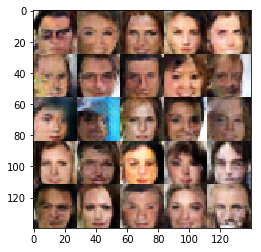

Epoch 4/10... Discriminator Loss: 1.2421... Generator Loss: 0.8832
Epoch 4/10... Discriminator Loss: 1.2318... Generator Loss: 0.9306
Epoch 4/10... Discriminator Loss: 1.2928... Generator Loss: 0.8187
Epoch 4/10... Discriminator Loss: 1.2408... Generator Loss: 0.9002
Epoch 4/10... Discriminator Loss: 1.1620... Generator Loss: 0.9564
Epoch 4/10... Discriminator Loss: 1.2909... Generator Loss: 0.7874
Epoch 4/10... Discriminator Loss: 1.2216... Generator Loss: 0.8167
Epoch 4/10... Discriminator Loss: 1.1960... Generator Loss: 0.8669
Epoch 4/10... Discriminator Loss: 1.2782... Generator Loss: 0.8558
Epoch 4/10... Discriminator Loss: 1.2556... Generator Loss: 0.7674


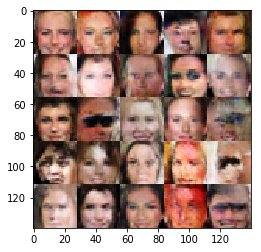

Epoch 4/10... Discriminator Loss: 1.2580... Generator Loss: 0.7451
Epoch 4/10... Discriminator Loss: 1.2484... Generator Loss: 0.9422
Epoch 4/10... Discriminator Loss: 1.2469... Generator Loss: 0.8548
Epoch 4/10... Discriminator Loss: 1.2301... Generator Loss: 0.8311
Epoch 4/10... Discriminator Loss: 1.2556... Generator Loss: 0.7730
Epoch 4/10... Discriminator Loss: 1.2473... Generator Loss: 0.8510
Epoch 4/10... Discriminator Loss: 1.2522... Generator Loss: 0.7465
Epoch 4/10... Discriminator Loss: 1.2457... Generator Loss: 0.8482
Epoch 4/10... Discriminator Loss: 1.1427... Generator Loss: 0.8994
Epoch 4/10... Discriminator Loss: 1.3273... Generator Loss: 0.8048


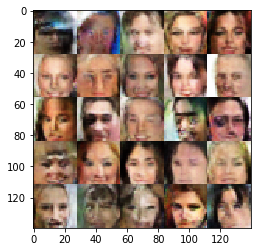

Epoch 4/10... Discriminator Loss: 1.2944... Generator Loss: 0.7305
Epoch 4/10... Discriminator Loss: 0.9750... Generator Loss: 1.0731
Epoch 4/10... Discriminator Loss: 1.2559... Generator Loss: 0.8732
Epoch 4/10... Discriminator Loss: 1.1756... Generator Loss: 0.9271
Epoch 4/10... Discriminator Loss: 1.1216... Generator Loss: 0.9292
Epoch 4/10... Discriminator Loss: 1.2981... Generator Loss: 0.7394
Epoch 4/10... Discriminator Loss: 1.1566... Generator Loss: 0.8305
Epoch 4/10... Discriminator Loss: 1.2475... Generator Loss: 0.9656
Epoch 4/10... Discriminator Loss: 1.2427... Generator Loss: 0.8614
Epoch 4/10... Discriminator Loss: 1.2112... Generator Loss: 0.7928


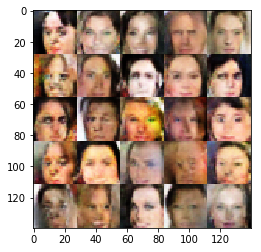

Epoch 4/10... Discriminator Loss: 1.0611... Generator Loss: 1.0144
Epoch 4/10... Discriminator Loss: 1.0358... Generator Loss: 1.1033
Epoch 4/10... Discriminator Loss: 1.2214... Generator Loss: 0.9086
Epoch 4/10... Discriminator Loss: 1.2018... Generator Loss: 0.8882
Epoch 4/10... Discriminator Loss: 1.2699... Generator Loss: 0.7385
Epoch 4/10... Discriminator Loss: 1.3037... Generator Loss: 0.8246
Epoch 4/10... Discriminator Loss: 1.1626... Generator Loss: 0.8508
Epoch 4/10... Discriminator Loss: 1.2215... Generator Loss: 0.8416
Epoch 4/10... Discriminator Loss: 1.3001... Generator Loss: 0.7866
Epoch 4/10... Discriminator Loss: 1.2255... Generator Loss: 0.7729


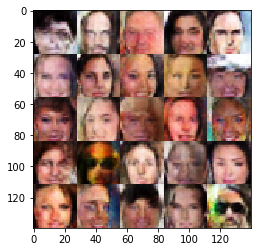

Epoch 4/10... Discriminator Loss: 1.1157... Generator Loss: 0.9553
Epoch 4/10... Discriminator Loss: 1.1737... Generator Loss: 0.8412
Epoch 4/10... Discriminator Loss: 1.3361... Generator Loss: 0.8758
Epoch 4/10... Discriminator Loss: 1.1539... Generator Loss: 0.9203
Epoch 4/10... Discriminator Loss: 1.0289... Generator Loss: 1.1343
Epoch 4/10... Discriminator Loss: 1.2644... Generator Loss: 0.8310
Epoch 4/10... Discriminator Loss: 1.3792... Generator Loss: 0.6644
Epoch 4/10... Discriminator Loss: 1.1670... Generator Loss: 0.9072
Epoch 4/10... Discriminator Loss: 1.2019... Generator Loss: 0.7897
Epoch 4/10... Discriminator Loss: 1.2019... Generator Loss: 0.9260


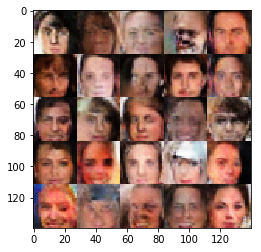

Epoch 4/10... Discriminator Loss: 1.1382... Generator Loss: 0.8816
Epoch 4/10... Discriminator Loss: 1.2019... Generator Loss: 0.8379
Epoch 4/10... Discriminator Loss: 1.1494... Generator Loss: 0.9997
Epoch 4/10... Discriminator Loss: 1.2598... Generator Loss: 0.8154
Epoch 4/10... Discriminator Loss: 1.2499... Generator Loss: 0.8430
Epoch 4/10... Discriminator Loss: 1.2475... Generator Loss: 0.9455
Epoch 4/10... Discriminator Loss: 1.2622... Generator Loss: 0.7834
Epoch 4/10... Discriminator Loss: 1.2588... Generator Loss: 0.7674
Epoch 4/10... Discriminator Loss: 1.3388... Generator Loss: 0.8193
Epoch 4/10... Discriminator Loss: 1.3472... Generator Loss: 0.7658


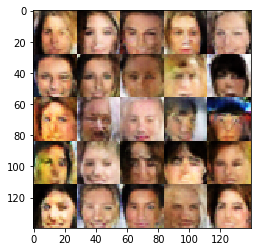

Epoch 4/10... Discriminator Loss: 1.1731... Generator Loss: 0.9515
Epoch 4/10... Discriminator Loss: 1.2567... Generator Loss: 0.7871
Epoch 4/10... Discriminator Loss: 1.2402... Generator Loss: 0.8307
Epoch 4/10... Discriminator Loss: 1.3059... Generator Loss: 0.8098
Epoch 4/10... Discriminator Loss: 1.2722... Generator Loss: 0.7641
Epoch 4/10... Discriminator Loss: 1.1748... Generator Loss: 0.9120
Epoch 4/10... Discriminator Loss: 1.3731... Generator Loss: 0.7480
Epoch 4/10... Discriminator Loss: 1.1213... Generator Loss: 1.0122
Epoch 4/10... Discriminator Loss: 1.1478... Generator Loss: 0.9703
Epoch 4/10... Discriminator Loss: 1.2588... Generator Loss: 0.7370


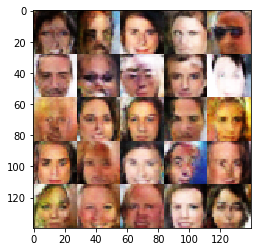

Epoch 4/10... Discriminator Loss: 1.1941... Generator Loss: 0.9187
Epoch 4/10... Discriminator Loss: 1.2030... Generator Loss: 0.8385
Epoch 4/10... Discriminator Loss: 1.1972... Generator Loss: 0.9267
Epoch 4/10... Discriminator Loss: 1.1728... Generator Loss: 0.8874
Epoch 4/10... Discriminator Loss: 1.2431... Generator Loss: 0.9160
Epoch 4/10... Discriminator Loss: 1.2371... Generator Loss: 0.9508
Epoch 4/10... Discriminator Loss: 1.3229... Generator Loss: 0.6922
Epoch 4/10... Discriminator Loss: 1.1472... Generator Loss: 0.9660
Epoch 4/10... Discriminator Loss: 1.2778... Generator Loss: 0.7754
Epoch 4/10... Discriminator Loss: 1.2891... Generator Loss: 0.8076


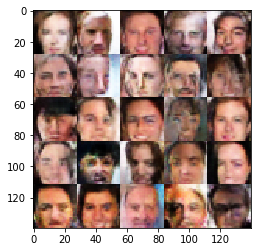

Epoch 4/10... Discriminator Loss: 1.2864... Generator Loss: 0.7951
Epoch 4/10... Discriminator Loss: 1.0331... Generator Loss: 1.0155
Epoch 4/10... Discriminator Loss: 1.2179... Generator Loss: 0.8794
Epoch 4/10... Discriminator Loss: 1.2093... Generator Loss: 0.9052
Epoch 4/10... Discriminator Loss: 1.1895... Generator Loss: 0.8455
Epoch 4/10... Discriminator Loss: 1.3933... Generator Loss: 0.6847
Epoch 4/10... Discriminator Loss: 1.2138... Generator Loss: 0.8211
Epoch 4/10... Discriminator Loss: 1.1974... Generator Loss: 0.8392
Epoch 4/10... Discriminator Loss: 1.1344... Generator Loss: 1.0066
Epoch 4/10... Discriminator Loss: 1.2203... Generator Loss: 0.9186


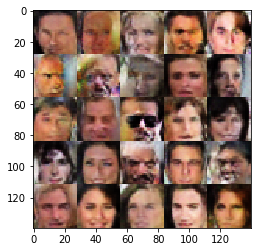

Epoch 4/10... Discriminator Loss: 1.0976... Generator Loss: 0.9794
Epoch 4/10... Discriminator Loss: 1.0447... Generator Loss: 1.2741
Epoch 4/10... Discriminator Loss: 1.2209... Generator Loss: 0.8805
Epoch 4/10... Discriminator Loss: 1.2060... Generator Loss: 0.7946
Epoch 4/10... Discriminator Loss: 1.2791... Generator Loss: 0.8066
Epoch 4/10... Discriminator Loss: 1.3090... Generator Loss: 0.7814
Epoch 4/10... Discriminator Loss: 1.3358... Generator Loss: 0.7966
Epoch 4/10... Discriminator Loss: 1.1249... Generator Loss: 1.0309
Epoch 4/10... Discriminator Loss: 1.1836... Generator Loss: 0.9332
Epoch 4/10... Discriminator Loss: 1.0785... Generator Loss: 0.9357


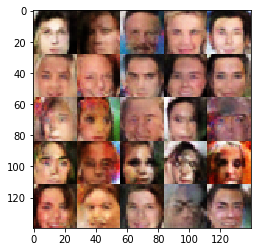

Epoch 4/10... Discriminator Loss: 1.2914... Generator Loss: 0.7865
Epoch 4/10... Discriminator Loss: 1.2229... Generator Loss: 0.8295
Epoch 4/10... Discriminator Loss: 1.1835... Generator Loss: 0.8161
Epoch 4/10... Discriminator Loss: 1.1805... Generator Loss: 0.8602
Epoch 4/10... Discriminator Loss: 1.3221... Generator Loss: 0.7526
Epoch 4/10... Discriminator Loss: 1.2625... Generator Loss: 0.8894
Epoch 4/10... Discriminator Loss: 1.2765... Generator Loss: 0.7693
Epoch 4/10... Discriminator Loss: 1.2062... Generator Loss: 1.0582
Epoch 4/10... Discriminator Loss: 1.1805... Generator Loss: 0.9082
Epoch 4/10... Discriminator Loss: 1.2176... Generator Loss: 1.0359


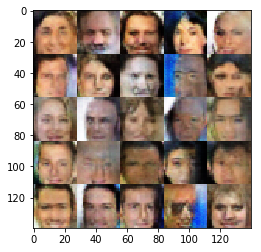

Epoch 4/10... Discriminator Loss: 1.1772... Generator Loss: 0.8715
Epoch 4/10... Discriminator Loss: 1.3667... Generator Loss: 0.8309
Epoch 4/10... Discriminator Loss: 1.2211... Generator Loss: 1.0945
Epoch 4/10... Discriminator Loss: 1.2016... Generator Loss: 0.8815
Epoch 4/10... Discriminator Loss: 1.2388... Generator Loss: 0.8442
Epoch 4/10... Discriminator Loss: 1.3398... Generator Loss: 0.8113
Epoch 4/10... Discriminator Loss: 1.0605... Generator Loss: 1.0197
Epoch 4/10... Discriminator Loss: 1.3196... Generator Loss: 0.7715
Epoch 4/10... Discriminator Loss: 1.4873... Generator Loss: 0.8075
Epoch 4/10... Discriminator Loss: 1.4206... Generator Loss: 0.6958


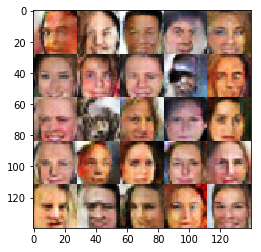

Epoch 4/10... Discriminator Loss: 1.2033... Generator Loss: 0.8468
Epoch 4/10... Discriminator Loss: 1.2630... Generator Loss: 0.8558
Epoch 4/10... Discriminator Loss: 1.2637... Generator Loss: 0.8045
Epoch 4/10... Discriminator Loss: 1.2362... Generator Loss: 0.8622
Epoch 4/10... Discriminator Loss: 1.1314... Generator Loss: 1.0260
Epoch 4/10... Discriminator Loss: 1.2577... Generator Loss: 0.6953
Epoch 4/10... Discriminator Loss: 1.1842... Generator Loss: 0.8507
Epoch 4/10... Discriminator Loss: 1.2510... Generator Loss: 0.7869
Epoch 4/10... Discriminator Loss: 1.2507... Generator Loss: 0.7790
Epoch 4/10... Discriminator Loss: 1.2338... Generator Loss: 0.8651


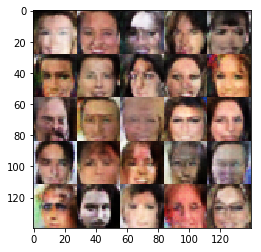

Epoch 4/10... Discriminator Loss: 1.2433... Generator Loss: 0.7555
Epoch 4/10... Discriminator Loss: 1.2476... Generator Loss: 0.8540
Epoch 4/10... Discriminator Loss: 1.1293... Generator Loss: 1.0017
Epoch 4/10... Discriminator Loss: 1.1029... Generator Loss: 1.0069
Epoch 4/10... Discriminator Loss: 1.1432... Generator Loss: 0.8756
Epoch 4/10... Discriminator Loss: 1.1488... Generator Loss: 0.8801
Epoch 5/10... Discriminator Loss: 1.3161... Generator Loss: 0.7024
Epoch 5/10... Discriminator Loss: 1.0323... Generator Loss: 0.9929
Epoch 5/10... Discriminator Loss: 1.1449... Generator Loss: 0.9741
Epoch 5/10... Discriminator Loss: 1.2163... Generator Loss: 0.8267


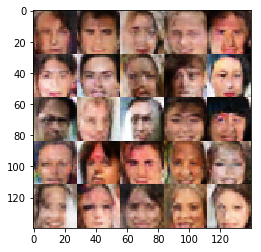

Epoch 5/10... Discriminator Loss: 1.0914... Generator Loss: 0.9965
Epoch 5/10... Discriminator Loss: 1.2278... Generator Loss: 0.7661
Epoch 5/10... Discriminator Loss: 1.2143... Generator Loss: 0.7888
Epoch 5/10... Discriminator Loss: 1.2352... Generator Loss: 0.7827
Epoch 5/10... Discriminator Loss: 1.1832... Generator Loss: 0.8509
Epoch 5/10... Discriminator Loss: 1.2304... Generator Loss: 0.8155
Epoch 5/10... Discriminator Loss: 1.2573... Generator Loss: 0.8310
Epoch 5/10... Discriminator Loss: 1.2772... Generator Loss: 0.7076
Epoch 5/10... Discriminator Loss: 1.1982... Generator Loss: 0.8765
Epoch 5/10... Discriminator Loss: 1.1813... Generator Loss: 0.8948


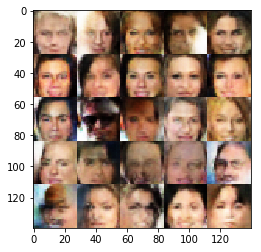

Epoch 5/10... Discriminator Loss: 1.1725... Generator Loss: 0.9085
Epoch 5/10... Discriminator Loss: 1.1747... Generator Loss: 0.8944
Epoch 5/10... Discriminator Loss: 1.1662... Generator Loss: 0.8395
Epoch 5/10... Discriminator Loss: 1.2546... Generator Loss: 0.7982
Epoch 5/10... Discriminator Loss: 1.1532... Generator Loss: 0.9026
Epoch 5/10... Discriminator Loss: 1.1524... Generator Loss: 0.9511
Epoch 5/10... Discriminator Loss: 1.2047... Generator Loss: 0.8179
Epoch 5/10... Discriminator Loss: 1.2357... Generator Loss: 0.8668
Epoch 5/10... Discriminator Loss: 1.2418... Generator Loss: 0.8497
Epoch 5/10... Discriminator Loss: 1.1422... Generator Loss: 0.9120


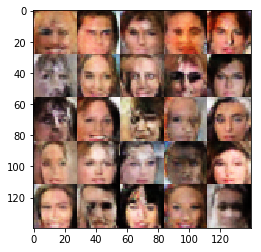

Epoch 5/10... Discriminator Loss: 1.2796... Generator Loss: 0.8237
Epoch 5/10... Discriminator Loss: 1.1541... Generator Loss: 0.9878
Epoch 5/10... Discriminator Loss: 1.2763... Generator Loss: 0.7920
Epoch 5/10... Discriminator Loss: 1.1005... Generator Loss: 0.8827
Epoch 5/10... Discriminator Loss: 1.3276... Generator Loss: 0.7322
Epoch 5/10... Discriminator Loss: 1.3716... Generator Loss: 0.8367
Epoch 5/10... Discriminator Loss: 1.1805... Generator Loss: 0.8547
Epoch 5/10... Discriminator Loss: 1.1293... Generator Loss: 0.9370
Epoch 5/10... Discriminator Loss: 1.1764... Generator Loss: 0.8683
Epoch 5/10... Discriminator Loss: 1.2508... Generator Loss: 0.7640


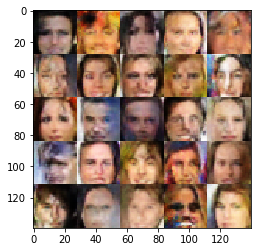

Epoch 5/10... Discriminator Loss: 1.3256... Generator Loss: 0.7627
Epoch 5/10... Discriminator Loss: 1.2831... Generator Loss: 0.8076
Epoch 5/10... Discriminator Loss: 1.1856... Generator Loss: 0.8612
Epoch 5/10... Discriminator Loss: 1.1697... Generator Loss: 0.8725
Epoch 5/10... Discriminator Loss: 1.2375... Generator Loss: 0.8188
Epoch 5/10... Discriminator Loss: 1.2417... Generator Loss: 0.7519
Epoch 5/10... Discriminator Loss: 1.1586... Generator Loss: 0.8776
Epoch 5/10... Discriminator Loss: 1.0341... Generator Loss: 1.0382
Epoch 5/10... Discriminator Loss: 1.1574... Generator Loss: 1.0168
Epoch 5/10... Discriminator Loss: 1.2264... Generator Loss: 0.8463


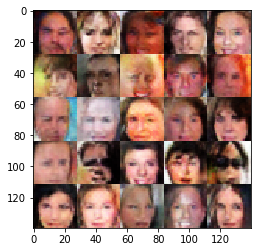

Epoch 5/10... Discriminator Loss: 1.2645... Generator Loss: 0.7938
Epoch 5/10... Discriminator Loss: 1.1281... Generator Loss: 0.9664
Epoch 5/10... Discriminator Loss: 1.1635... Generator Loss: 0.8788
Epoch 5/10... Discriminator Loss: 1.1317... Generator Loss: 0.9048
Epoch 5/10... Discriminator Loss: 1.2125... Generator Loss: 0.8401
Epoch 5/10... Discriminator Loss: 1.1203... Generator Loss: 0.9693
Epoch 5/10... Discriminator Loss: 1.1930... Generator Loss: 0.8921
Epoch 5/10... Discriminator Loss: 1.2306... Generator Loss: 0.8299
Epoch 5/10... Discriminator Loss: 1.1944... Generator Loss: 0.9241
Epoch 5/10... Discriminator Loss: 1.3212... Generator Loss: 0.8097


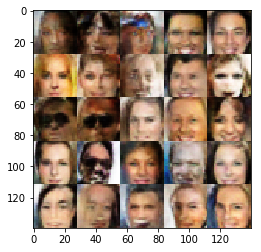

Epoch 5/10... Discriminator Loss: 1.2229... Generator Loss: 0.8695
Epoch 5/10... Discriminator Loss: 1.3269... Generator Loss: 0.9465
Epoch 5/10... Discriminator Loss: 1.4021... Generator Loss: 0.7525
Epoch 5/10... Discriminator Loss: 1.3669... Generator Loss: 0.6837
Epoch 5/10... Discriminator Loss: 1.2100... Generator Loss: 0.9846
Epoch 5/10... Discriminator Loss: 1.1640... Generator Loss: 0.8226
Epoch 5/10... Discriminator Loss: 1.2740... Generator Loss: 0.8182
Epoch 5/10... Discriminator Loss: 1.1462... Generator Loss: 0.9177
Epoch 5/10... Discriminator Loss: 1.1935... Generator Loss: 0.9156
Epoch 5/10... Discriminator Loss: 1.3330... Generator Loss: 0.7212


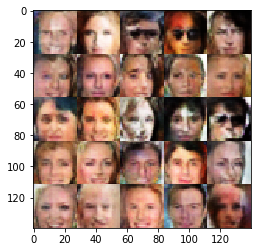

Epoch 5/10... Discriminator Loss: 1.0856... Generator Loss: 0.9582
Epoch 5/10... Discriminator Loss: 1.1033... Generator Loss: 0.9637
Epoch 5/10... Discriminator Loss: 1.2980... Generator Loss: 0.8497
Epoch 5/10... Discriminator Loss: 1.2575... Generator Loss: 0.8605
Epoch 5/10... Discriminator Loss: 1.1498... Generator Loss: 1.0350
Epoch 5/10... Discriminator Loss: 1.2567... Generator Loss: 0.8809
Epoch 5/10... Discriminator Loss: 1.2400... Generator Loss: 0.7650
Epoch 5/10... Discriminator Loss: 1.1935... Generator Loss: 0.9878
Epoch 5/10... Discriminator Loss: 1.1916... Generator Loss: 0.9550
Epoch 5/10... Discriminator Loss: 1.2879... Generator Loss: 0.8342


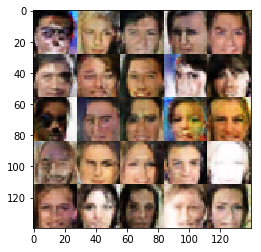

Epoch 5/10... Discriminator Loss: 1.2323... Generator Loss: 0.8164
Epoch 5/10... Discriminator Loss: 1.2645... Generator Loss: 0.8122
Epoch 5/10... Discriminator Loss: 1.3552... Generator Loss: 0.9159
Epoch 5/10... Discriminator Loss: 1.2837... Generator Loss: 0.7642
Epoch 5/10... Discriminator Loss: 1.2222... Generator Loss: 0.8180
Epoch 5/10... Discriminator Loss: 1.1766... Generator Loss: 0.8562
Epoch 5/10... Discriminator Loss: 1.1130... Generator Loss: 0.9129
Epoch 5/10... Discriminator Loss: 1.2757... Generator Loss: 0.7863
Epoch 5/10... Discriminator Loss: 1.2141... Generator Loss: 0.7773
Epoch 5/10... Discriminator Loss: 1.3290... Generator Loss: 0.7307


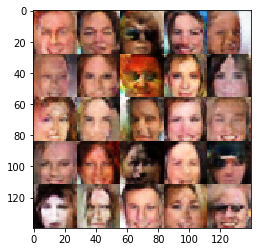

Epoch 5/10... Discriminator Loss: 1.2114... Generator Loss: 0.8618
Epoch 5/10... Discriminator Loss: 1.1806... Generator Loss: 0.8289
Epoch 5/10... Discriminator Loss: 1.3633... Generator Loss: 0.7029
Epoch 5/10... Discriminator Loss: 1.3294... Generator Loss: 0.8959
Epoch 5/10... Discriminator Loss: 1.3449... Generator Loss: 0.7253
Epoch 5/10... Discriminator Loss: 1.1483... Generator Loss: 0.8399
Epoch 5/10... Discriminator Loss: 1.3703... Generator Loss: 0.6345
Epoch 5/10... Discriminator Loss: 1.2382... Generator Loss: 0.8269
Epoch 5/10... Discriminator Loss: 1.1335... Generator Loss: 0.9852
Epoch 5/10... Discriminator Loss: 1.2101... Generator Loss: 0.8288


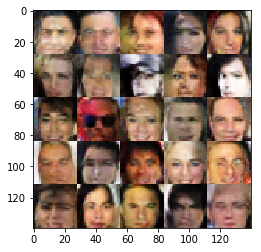

Epoch 5/10... Discriminator Loss: 1.2408... Generator Loss: 0.7922
Epoch 5/10... Discriminator Loss: 1.2324... Generator Loss: 0.8563
Epoch 5/10... Discriminator Loss: 1.3388... Generator Loss: 0.7413
Epoch 5/10... Discriminator Loss: 1.2023... Generator Loss: 0.8082
Epoch 5/10... Discriminator Loss: 1.2155... Generator Loss: 0.9086
Epoch 5/10... Discriminator Loss: 1.3058... Generator Loss: 0.7643
Epoch 5/10... Discriminator Loss: 1.1214... Generator Loss: 0.8725
Epoch 5/10... Discriminator Loss: 1.3622... Generator Loss: 0.6633
Epoch 5/10... Discriminator Loss: 1.3284... Generator Loss: 0.8787
Epoch 5/10... Discriminator Loss: 1.2359... Generator Loss: 0.8476


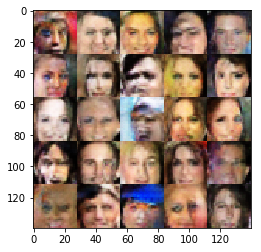

Epoch 5/10... Discriminator Loss: 1.1653... Generator Loss: 0.9017
Epoch 5/10... Discriminator Loss: 1.1526... Generator Loss: 0.9176
Epoch 5/10... Discriminator Loss: 1.1420... Generator Loss: 0.9331
Epoch 5/10... Discriminator Loss: 1.1818... Generator Loss: 0.8486
Epoch 5/10... Discriminator Loss: 1.2398... Generator Loss: 0.7701
Epoch 5/10... Discriminator Loss: 1.1594... Generator Loss: 0.8552
Epoch 5/10... Discriminator Loss: 1.1848... Generator Loss: 0.8445
Epoch 5/10... Discriminator Loss: 1.1876... Generator Loss: 0.9071
Epoch 5/10... Discriminator Loss: 1.1997... Generator Loss: 0.7927
Epoch 5/10... Discriminator Loss: 1.3575... Generator Loss: 0.7782


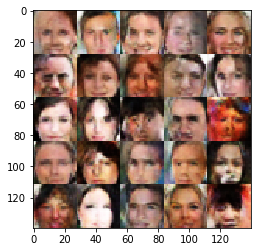

Epoch 5/10... Discriminator Loss: 1.1880... Generator Loss: 0.8913
Epoch 5/10... Discriminator Loss: 1.1381... Generator Loss: 0.9092
Epoch 5/10... Discriminator Loss: 1.3103... Generator Loss: 0.7531
Epoch 5/10... Discriminator Loss: 1.1594... Generator Loss: 0.8240
Epoch 5/10... Discriminator Loss: 1.1627... Generator Loss: 1.0113
Epoch 5/10... Discriminator Loss: 1.1664... Generator Loss: 0.9139
Epoch 5/10... Discriminator Loss: 1.3035... Generator Loss: 0.7583
Epoch 5/10... Discriminator Loss: 1.2757... Generator Loss: 0.7992
Epoch 5/10... Discriminator Loss: 1.2082... Generator Loss: 0.9893
Epoch 5/10... Discriminator Loss: 1.2663... Generator Loss: 0.7504


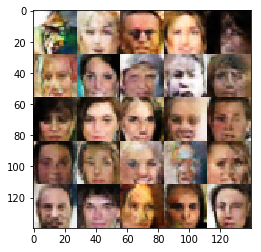

Epoch 5/10... Discriminator Loss: 1.2951... Generator Loss: 0.7549
Epoch 5/10... Discriminator Loss: 1.2287... Generator Loss: 0.8007
Epoch 5/10... Discriminator Loss: 1.3364... Generator Loss: 0.7554
Epoch 5/10... Discriminator Loss: 1.2368... Generator Loss: 0.7794
Epoch 5/10... Discriminator Loss: 1.2873... Generator Loss: 0.9191
Epoch 5/10... Discriminator Loss: 1.1964... Generator Loss: 0.8399
Epoch 5/10... Discriminator Loss: 1.3126... Generator Loss: 0.7338
Epoch 5/10... Discriminator Loss: 1.2091... Generator Loss: 0.8174
Epoch 5/10... Discriminator Loss: 1.3508... Generator Loss: 1.0886
Epoch 5/10... Discriminator Loss: 1.1849... Generator Loss: 0.7867


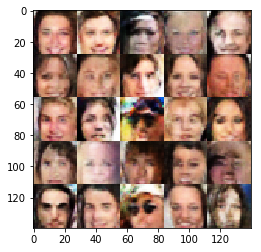

Epoch 5/10... Discriminator Loss: 1.1295... Generator Loss: 0.8737
Epoch 5/10... Discriminator Loss: 1.3398... Generator Loss: 0.7066
Epoch 5/10... Discriminator Loss: 1.4327... Generator Loss: 0.7584
Epoch 5/10... Discriminator Loss: 1.2447... Generator Loss: 0.7903
Epoch 5/10... Discriminator Loss: 1.1605... Generator Loss: 0.9204
Epoch 5/10... Discriminator Loss: 1.1920... Generator Loss: 0.8164
Epoch 5/10... Discriminator Loss: 1.2773... Generator Loss: 0.7512
Epoch 5/10... Discriminator Loss: 1.3016... Generator Loss: 0.8029
Epoch 5/10... Discriminator Loss: 1.2029... Generator Loss: 0.8068
Epoch 5/10... Discriminator Loss: 1.2556... Generator Loss: 0.8368


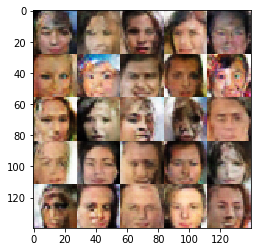

Epoch 5/10... Discriminator Loss: 1.2911... Generator Loss: 0.7751
Epoch 5/10... Discriminator Loss: 1.1717... Generator Loss: 0.9407
Epoch 5/10... Discriminator Loss: 1.2410... Generator Loss: 0.7228
Epoch 5/10... Discriminator Loss: 1.3205... Generator Loss: 0.7551
Epoch 5/10... Discriminator Loss: 1.1665... Generator Loss: 0.8641
Epoch 5/10... Discriminator Loss: 1.4196... Generator Loss: 0.6770
Epoch 5/10... Discriminator Loss: 1.3136... Generator Loss: 0.8974
Epoch 5/10... Discriminator Loss: 1.2321... Generator Loss: 0.8585
Epoch 5/10... Discriminator Loss: 1.2475... Generator Loss: 0.8288
Epoch 5/10... Discriminator Loss: 1.3530... Generator Loss: 0.6620


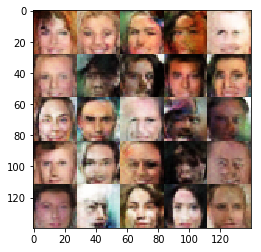

Epoch 5/10... Discriminator Loss: 1.3446... Generator Loss: 0.7550
Epoch 5/10... Discriminator Loss: 1.2450... Generator Loss: 0.7819
Epoch 5/10... Discriminator Loss: 1.1625... Generator Loss: 0.7770
Epoch 5/10... Discriminator Loss: 1.1963... Generator Loss: 0.8720
Epoch 5/10... Discriminator Loss: 1.1099... Generator Loss: 0.9857
Epoch 5/10... Discriminator Loss: 1.3087... Generator Loss: 0.8509
Epoch 5/10... Discriminator Loss: 1.1962... Generator Loss: 0.9222
Epoch 5/10... Discriminator Loss: 1.2412... Generator Loss: 0.9290
Epoch 5/10... Discriminator Loss: 1.2418... Generator Loss: 0.7876
Epoch 5/10... Discriminator Loss: 1.2154... Generator Loss: 0.7721


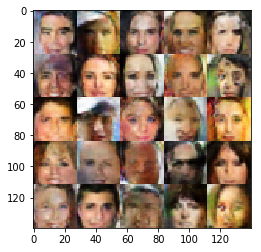

Epoch 5/10... Discriminator Loss: 1.2381... Generator Loss: 0.8679
Epoch 5/10... Discriminator Loss: 1.2820... Generator Loss: 0.8143
Epoch 5/10... Discriminator Loss: 1.2731... Generator Loss: 0.7486
Epoch 5/10... Discriminator Loss: 1.1840... Generator Loss: 0.8843
Epoch 5/10... Discriminator Loss: 1.3394... Generator Loss: 0.7810
Epoch 5/10... Discriminator Loss: 1.2272... Generator Loss: 0.7518
Epoch 5/10... Discriminator Loss: 1.1147... Generator Loss: 0.9034
Epoch 5/10... Discriminator Loss: 1.1371... Generator Loss: 0.9712
Epoch 5/10... Discriminator Loss: 1.0978... Generator Loss: 0.9704
Epoch 5/10... Discriminator Loss: 1.1935... Generator Loss: 0.8167


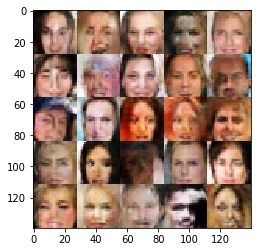

Epoch 5/10... Discriminator Loss: 1.2391... Generator Loss: 0.8704
Epoch 5/10... Discriminator Loss: 1.2138... Generator Loss: 0.8177
Epoch 5/10... Discriminator Loss: 1.2684... Generator Loss: 0.7282
Epoch 5/10... Discriminator Loss: 1.2916... Generator Loss: 0.7919
Epoch 5/10... Discriminator Loss: 1.3176... Generator Loss: 0.7845
Epoch 5/10... Discriminator Loss: 1.0940... Generator Loss: 0.9216
Epoch 5/10... Discriminator Loss: 1.2921... Generator Loss: 0.7602
Epoch 5/10... Discriminator Loss: 1.2027... Generator Loss: 0.7939
Epoch 5/10... Discriminator Loss: 1.1621... Generator Loss: 0.8612
Epoch 5/10... Discriminator Loss: 1.1150... Generator Loss: 1.0041


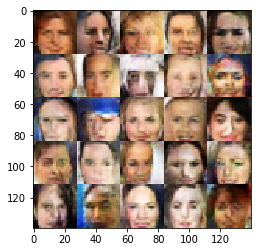

Epoch 5/10... Discriminator Loss: 1.0663... Generator Loss: 1.0101
Epoch 5/10... Discriminator Loss: 1.1723... Generator Loss: 0.8294
Epoch 5/10... Discriminator Loss: 1.2081... Generator Loss: 0.9618
Epoch 5/10... Discriminator Loss: 1.2277... Generator Loss: 0.9938
Epoch 5/10... Discriminator Loss: 1.1570... Generator Loss: 0.8944
Epoch 5/10... Discriminator Loss: 1.2534... Generator Loss: 0.8814
Epoch 5/10... Discriminator Loss: 1.2430... Generator Loss: 0.8465
Epoch 5/10... Discriminator Loss: 1.3461... Generator Loss: 0.7294
Epoch 5/10... Discriminator Loss: 1.2093... Generator Loss: 0.7971
Epoch 5/10... Discriminator Loss: 1.2105... Generator Loss: 0.9702


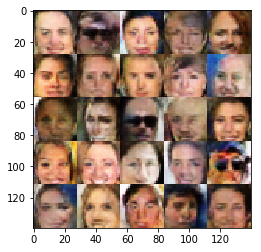

Epoch 5/10... Discriminator Loss: 1.2852... Generator Loss: 0.7524
Epoch 5/10... Discriminator Loss: 1.2583... Generator Loss: 0.8727
Epoch 5/10... Discriminator Loss: 1.3476... Generator Loss: 0.6661
Epoch 5/10... Discriminator Loss: 1.3180... Generator Loss: 0.9219
Epoch 5/10... Discriminator Loss: 1.1779... Generator Loss: 1.0436
Epoch 5/10... Discriminator Loss: 1.2257... Generator Loss: 0.7602
Epoch 5/10... Discriminator Loss: 1.0930... Generator Loss: 1.0111
Epoch 5/10... Discriminator Loss: 1.1820... Generator Loss: 0.7939
Epoch 5/10... Discriminator Loss: 1.1884... Generator Loss: 0.8990
Epoch 5/10... Discriminator Loss: 1.3213... Generator Loss: 0.7183


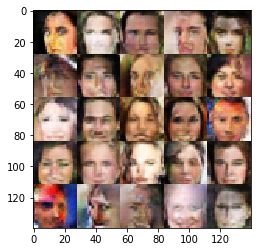

Epoch 5/10... Discriminator Loss: 1.1062... Generator Loss: 0.8786
Epoch 5/10... Discriminator Loss: 1.2652... Generator Loss: 0.7669
Epoch 5/10... Discriminator Loss: 1.0848... Generator Loss: 1.0667
Epoch 5/10... Discriminator Loss: 1.2102... Generator Loss: 0.8084
Epoch 5/10... Discriminator Loss: 1.3349... Generator Loss: 0.7612
Epoch 5/10... Discriminator Loss: 1.3457... Generator Loss: 0.7973
Epoch 5/10... Discriminator Loss: 1.1674... Generator Loss: 0.9659
Epoch 5/10... Discriminator Loss: 0.9905... Generator Loss: 1.1376
Epoch 5/10... Discriminator Loss: 1.1831... Generator Loss: 0.8591
Epoch 5/10... Discriminator Loss: 1.2137... Generator Loss: 0.8577


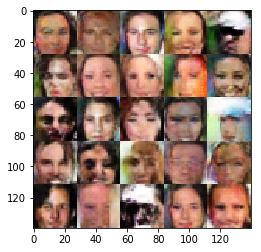

Epoch 5/10... Discriminator Loss: 1.2431... Generator Loss: 0.8664
Epoch 5/10... Discriminator Loss: 1.2322... Generator Loss: 0.7625
Epoch 5/10... Discriminator Loss: 1.1339... Generator Loss: 0.9091
Epoch 5/10... Discriminator Loss: 1.0761... Generator Loss: 0.9880
Epoch 5/10... Discriminator Loss: 1.3328... Generator Loss: 0.8390
Epoch 5/10... Discriminator Loss: 1.3539... Generator Loss: 0.7141
Epoch 5/10... Discriminator Loss: 1.2049... Generator Loss: 0.9292
Epoch 5/10... Discriminator Loss: 1.2494... Generator Loss: 0.8868
Epoch 5/10... Discriminator Loss: 1.1543... Generator Loss: 0.9041
Epoch 5/10... Discriminator Loss: 1.1402... Generator Loss: 0.9251


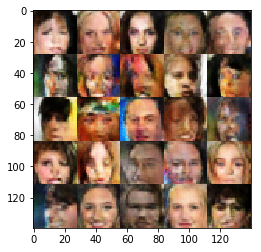

Epoch 5/10... Discriminator Loss: 1.1966... Generator Loss: 0.8500
Epoch 5/10... Discriminator Loss: 1.2594... Generator Loss: 0.7157
Epoch 5/10... Discriminator Loss: 1.1964... Generator Loss: 0.7606
Epoch 5/10... Discriminator Loss: 1.3992... Generator Loss: 0.8225
Epoch 5/10... Discriminator Loss: 1.0589... Generator Loss: 0.9449
Epoch 5/10... Discriminator Loss: 1.0864... Generator Loss: 0.9079
Epoch 5/10... Discriminator Loss: 1.1936... Generator Loss: 0.8267
Epoch 5/10... Discriminator Loss: 1.1428... Generator Loss: 0.8395
Epoch 5/10... Discriminator Loss: 1.1001... Generator Loss: 0.9047
Epoch 5/10... Discriminator Loss: 1.2514... Generator Loss: 0.8675


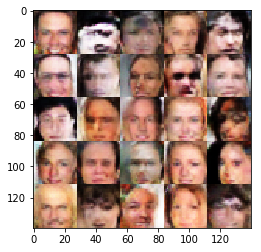

Epoch 5/10... Discriminator Loss: 1.1621... Generator Loss: 0.9280
Epoch 5/10... Discriminator Loss: 1.2255... Generator Loss: 0.8762
Epoch 5/10... Discriminator Loss: 1.2200... Generator Loss: 0.7880
Epoch 5/10... Discriminator Loss: 1.2084... Generator Loss: 0.9062
Epoch 5/10... Discriminator Loss: 1.0927... Generator Loss: 1.0344
Epoch 5/10... Discriminator Loss: 1.0561... Generator Loss: 0.9607
Epoch 5/10... Discriminator Loss: 1.1344... Generator Loss: 0.9253
Epoch 5/10... Discriminator Loss: 1.0360... Generator Loss: 1.0003
Epoch 5/10... Discriminator Loss: 1.1535... Generator Loss: 0.9510
Epoch 5/10... Discriminator Loss: 1.1649... Generator Loss: 0.9464


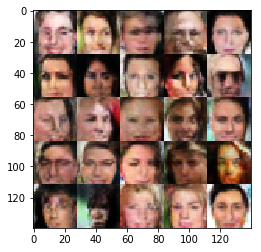

Epoch 5/10... Discriminator Loss: 1.1413... Generator Loss: 0.9118
Epoch 5/10... Discriminator Loss: 1.3287... Generator Loss: 0.7946
Epoch 5/10... Discriminator Loss: 1.2706... Generator Loss: 0.7594
Epoch 5/10... Discriminator Loss: 1.1725... Generator Loss: 0.8212
Epoch 5/10... Discriminator Loss: 1.3932... Generator Loss: 0.8104
Epoch 5/10... Discriminator Loss: 1.0598... Generator Loss: 1.0700
Epoch 5/10... Discriminator Loss: 1.2018... Generator Loss: 0.8082
Epoch 5/10... Discriminator Loss: 1.2639... Generator Loss: 0.7804
Epoch 5/10... Discriminator Loss: 1.3455... Generator Loss: 0.7890
Epoch 5/10... Discriminator Loss: 1.2568... Generator Loss: 0.7661


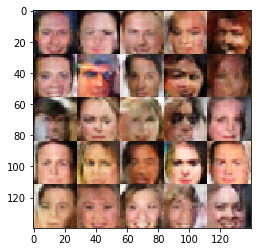

Epoch 5/10... Discriminator Loss: 1.1884... Generator Loss: 1.0409
Epoch 5/10... Discriminator Loss: 1.2124... Generator Loss: 0.8832
Epoch 5/10... Discriminator Loss: 1.1372... Generator Loss: 0.9015
Epoch 5/10... Discriminator Loss: 1.5393... Generator Loss: 0.7595
Epoch 5/10... Discriminator Loss: 2.4401... Generator Loss: 0.8773
Epoch 5/10... Discriminator Loss: 1.3587... Generator Loss: 0.7376
Epoch 5/10... Discriminator Loss: 1.2655... Generator Loss: 0.8179
Epoch 5/10... Discriminator Loss: 1.3603... Generator Loss: 0.7574
Epoch 5/10... Discriminator Loss: 1.2325... Generator Loss: 0.8512
Epoch 5/10... Discriminator Loss: 1.2665... Generator Loss: 0.8337


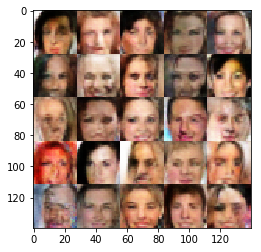

Epoch 5/10... Discriminator Loss: 1.2871... Generator Loss: 0.8547
Epoch 5/10... Discriminator Loss: 1.3192... Generator Loss: 0.7343
Epoch 5/10... Discriminator Loss: 1.3182... Generator Loss: 0.7954
Epoch 5/10... Discriminator Loss: 1.2033... Generator Loss: 0.8539
Epoch 5/10... Discriminator Loss: 1.3094... Generator Loss: 0.7579
Epoch 5/10... Discriminator Loss: 1.2977... Generator Loss: 0.7170
Epoch 5/10... Discriminator Loss: 1.1921... Generator Loss: 0.8355
Epoch 5/10... Discriminator Loss: 1.1723... Generator Loss: 0.8967
Epoch 5/10... Discriminator Loss: 1.2965... Generator Loss: 0.7740
Epoch 5/10... Discriminator Loss: 1.1648... Generator Loss: 0.9530


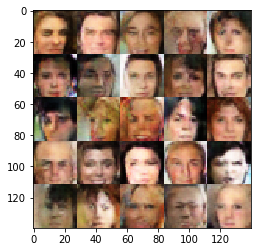

Epoch 5/10... Discriminator Loss: 1.2375... Generator Loss: 0.7576
Epoch 5/10... Discriminator Loss: 1.2625... Generator Loss: 0.7238
Epoch 5/10... Discriminator Loss: 1.1947... Generator Loss: 0.8203
Epoch 5/10... Discriminator Loss: 1.3630... Generator Loss: 0.7206
Epoch 5/10... Discriminator Loss: 1.5057... Generator Loss: 0.6201
Epoch 5/10... Discriminator Loss: 1.3173... Generator Loss: 0.7785
Epoch 5/10... Discriminator Loss: 1.1728... Generator Loss: 0.8429
Epoch 5/10... Discriminator Loss: 1.0158... Generator Loss: 1.0374
Epoch 5/10... Discriminator Loss: 1.2771... Generator Loss: 0.7775
Epoch 5/10... Discriminator Loss: 1.2388... Generator Loss: 0.8136


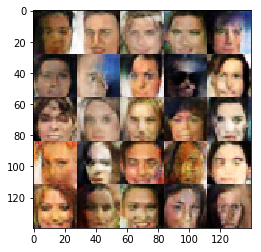

Epoch 5/10... Discriminator Loss: 1.1420... Generator Loss: 0.9034
Epoch 5/10... Discriminator Loss: 1.2161... Generator Loss: 0.8656
Epoch 5/10... Discriminator Loss: 1.1772... Generator Loss: 0.8375
Epoch 5/10... Discriminator Loss: 1.2653... Generator Loss: 0.8057
Epoch 5/10... Discriminator Loss: 1.2330... Generator Loss: 0.7732
Epoch 5/10... Discriminator Loss: 1.1800... Generator Loss: 0.8754
Epoch 5/10... Discriminator Loss: 1.1639... Generator Loss: 0.8818
Epoch 5/10... Discriminator Loss: 1.0297... Generator Loss: 0.9822
Epoch 5/10... Discriminator Loss: 1.1803... Generator Loss: 0.8604
Epoch 5/10... Discriminator Loss: 1.2035... Generator Loss: 0.8352


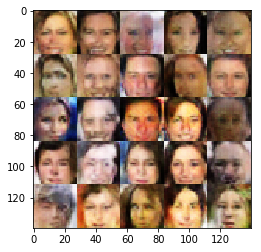

Epoch 5/10... Discriminator Loss: 1.0635... Generator Loss: 0.9723
Epoch 5/10... Discriminator Loss: 1.1151... Generator Loss: 0.9448
Epoch 5/10... Discriminator Loss: 1.4063... Generator Loss: 0.6909
Epoch 5/10... Discriminator Loss: 1.1335... Generator Loss: 0.9371
Epoch 5/10... Discriminator Loss: 1.2789... Generator Loss: 0.8872
Epoch 5/10... Discriminator Loss: 1.2397... Generator Loss: 0.7750
Epoch 5/10... Discriminator Loss: 1.2226... Generator Loss: 0.8249
Epoch 5/10... Discriminator Loss: 1.2042... Generator Loss: 0.7731
Epoch 5/10... Discriminator Loss: 1.2091... Generator Loss: 0.8890
Epoch 5/10... Discriminator Loss: 1.0977... Generator Loss: 1.0327


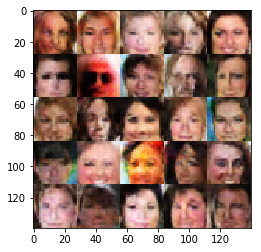

Epoch 5/10... Discriminator Loss: 1.1966... Generator Loss: 0.9000
Epoch 5/10... Discriminator Loss: 1.2291... Generator Loss: 0.8009
Epoch 5/10... Discriminator Loss: 1.3004... Generator Loss: 0.7344
Epoch 5/10... Discriminator Loss: 1.2708... Generator Loss: 0.8358
Epoch 5/10... Discriminator Loss: 1.1895... Generator Loss: 0.8681
Epoch 5/10... Discriminator Loss: 1.1708... Generator Loss: 0.8072
Epoch 5/10... Discriminator Loss: 1.3362... Generator Loss: 0.7891
Epoch 5/10... Discriminator Loss: 1.1263... Generator Loss: 0.9406
Epoch 5/10... Discriminator Loss: 1.0638... Generator Loss: 1.0141
Epoch 5/10... Discriminator Loss: 1.2250... Generator Loss: 0.9723


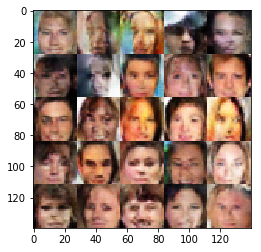

Epoch 5/10... Discriminator Loss: 1.4042... Generator Loss: 0.8366
Epoch 5/10... Discriminator Loss: 1.0409... Generator Loss: 1.0047
Epoch 6/10... Discriminator Loss: 1.3656... Generator Loss: 0.7941
Epoch 6/10... Discriminator Loss: 1.3429... Generator Loss: 0.7247
Epoch 6/10... Discriminator Loss: 1.5259... Generator Loss: 0.6294
Epoch 6/10... Discriminator Loss: 1.1693... Generator Loss: 0.8878
Epoch 6/10... Discriminator Loss: 1.2459... Generator Loss: 0.7708
Epoch 6/10... Discriminator Loss: 1.1736... Generator Loss: 0.8800
Epoch 6/10... Discriminator Loss: 1.1960... Generator Loss: 0.8337
Epoch 6/10... Discriminator Loss: 1.2219... Generator Loss: 0.8191


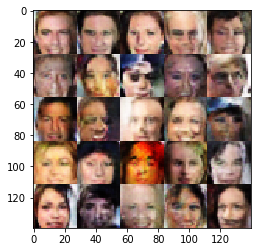

Epoch 6/10... Discriminator Loss: 1.2233... Generator Loss: 0.9399
Epoch 6/10... Discriminator Loss: 1.1576... Generator Loss: 0.8550
Epoch 6/10... Discriminator Loss: 1.0496... Generator Loss: 0.9718
Epoch 6/10... Discriminator Loss: 1.2335... Generator Loss: 0.7516
Epoch 6/10... Discriminator Loss: 1.1712... Generator Loss: 0.9284
Epoch 6/10... Discriminator Loss: 1.1155... Generator Loss: 0.9667
Epoch 6/10... Discriminator Loss: 1.0925... Generator Loss: 0.9300
Epoch 6/10... Discriminator Loss: 1.0948... Generator Loss: 0.9777
Epoch 6/10... Discriminator Loss: 1.2337... Generator Loss: 0.9116
Epoch 6/10... Discriminator Loss: 1.1988... Generator Loss: 0.8609


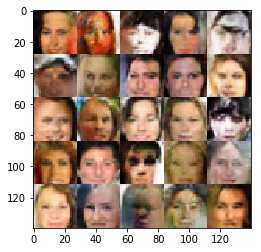

Epoch 6/10... Discriminator Loss: 1.2392... Generator Loss: 0.7538
Epoch 6/10... Discriminator Loss: 1.2187... Generator Loss: 0.8167
Epoch 6/10... Discriminator Loss: 1.1990... Generator Loss: 0.7734
Epoch 6/10... Discriminator Loss: 1.0796... Generator Loss: 0.9803
Epoch 6/10... Discriminator Loss: 1.1801... Generator Loss: 0.7793
Epoch 6/10... Discriminator Loss: 1.1267... Generator Loss: 0.9433
Epoch 6/10... Discriminator Loss: 1.2502... Generator Loss: 0.7577
Epoch 6/10... Discriminator Loss: 1.1933... Generator Loss: 0.8046
Epoch 6/10... Discriminator Loss: 1.1153... Generator Loss: 1.0819
Epoch 6/10... Discriminator Loss: 1.0522... Generator Loss: 1.1290


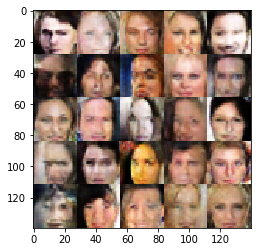

Epoch 6/10... Discriminator Loss: 1.1898... Generator Loss: 0.8226
Epoch 6/10... Discriminator Loss: 1.0998... Generator Loss: 0.9723
Epoch 6/10... Discriminator Loss: 1.3208... Generator Loss: 0.8162
Epoch 6/10... Discriminator Loss: 1.2145... Generator Loss: 0.8492
Epoch 6/10... Discriminator Loss: 1.1415... Generator Loss: 0.8806
Epoch 6/10... Discriminator Loss: 1.1997... Generator Loss: 0.8041
Epoch 6/10... Discriminator Loss: 1.1330... Generator Loss: 0.9280
Epoch 6/10... Discriminator Loss: 1.2791... Generator Loss: 0.8346
Epoch 6/10... Discriminator Loss: 1.2194... Generator Loss: 0.8229
Epoch 6/10... Discriminator Loss: 1.1162... Generator Loss: 0.8719


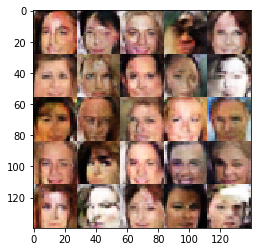

Epoch 6/10... Discriminator Loss: 1.1689... Generator Loss: 0.9160
Epoch 6/10... Discriminator Loss: 1.0833... Generator Loss: 1.0074
Epoch 6/10... Discriminator Loss: 1.2781... Generator Loss: 0.7131
Epoch 6/10... Discriminator Loss: 1.1597... Generator Loss: 0.8457
Epoch 6/10... Discriminator Loss: 1.1102... Generator Loss: 0.9762
Epoch 6/10... Discriminator Loss: 1.1421... Generator Loss: 1.1139
Epoch 6/10... Discriminator Loss: 1.1307... Generator Loss: 0.9950
Epoch 6/10... Discriminator Loss: 1.0403... Generator Loss: 1.1996
Epoch 6/10... Discriminator Loss: 1.4258... Generator Loss: 0.9615
Epoch 6/10... Discriminator Loss: 1.1885... Generator Loss: 1.0419


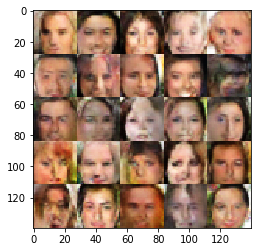

Epoch 6/10... Discriminator Loss: 1.2006... Generator Loss: 0.8875
Epoch 6/10... Discriminator Loss: 1.2894... Generator Loss: 0.7375
Epoch 6/10... Discriminator Loss: 1.2353... Generator Loss: 0.7934
Epoch 6/10... Discriminator Loss: 1.3410... Generator Loss: 0.7487
Epoch 6/10... Discriminator Loss: 1.1501... Generator Loss: 0.8866
Epoch 6/10... Discriminator Loss: 1.2296... Generator Loss: 0.7373
Epoch 6/10... Discriminator Loss: 1.2437... Generator Loss: 0.7422
Epoch 6/10... Discriminator Loss: 1.3480... Generator Loss: 0.7255
Epoch 6/10... Discriminator Loss: 1.1878... Generator Loss: 0.8794
Epoch 6/10... Discriminator Loss: 1.1847... Generator Loss: 0.8119


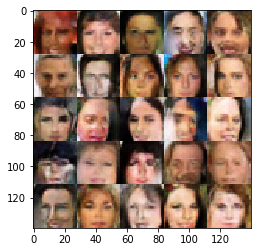

Epoch 6/10... Discriminator Loss: 1.1700... Generator Loss: 0.8929
Epoch 6/10... Discriminator Loss: 1.1542... Generator Loss: 0.8866
Epoch 6/10... Discriminator Loss: 1.3019... Generator Loss: 0.7401
Epoch 6/10... Discriminator Loss: 1.3123... Generator Loss: 0.7640
Epoch 6/10... Discriminator Loss: 1.1123... Generator Loss: 0.9039
Epoch 6/10... Discriminator Loss: 1.1330... Generator Loss: 0.9517
Epoch 6/10... Discriminator Loss: 1.3416... Generator Loss: 0.7738
Epoch 6/10... Discriminator Loss: 1.1244... Generator Loss: 0.9336
Epoch 6/10... Discriminator Loss: 1.1845... Generator Loss: 0.8676
Epoch 6/10... Discriminator Loss: 1.2232... Generator Loss: 0.8708


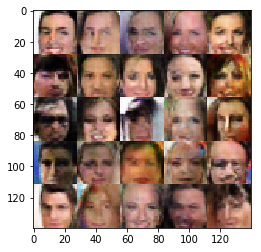

Epoch 6/10... Discriminator Loss: 1.0064... Generator Loss: 1.0859
Epoch 6/10... Discriminator Loss: 1.2035... Generator Loss: 0.8384
Epoch 6/10... Discriminator Loss: 1.2006... Generator Loss: 0.8213
Epoch 6/10... Discriminator Loss: 1.1464... Generator Loss: 0.8907
Epoch 6/10... Discriminator Loss: 1.1010... Generator Loss: 0.9398
Epoch 6/10... Discriminator Loss: 1.4199... Generator Loss: 0.6698
Epoch 6/10... Discriminator Loss: 1.1534... Generator Loss: 0.7933
Epoch 6/10... Discriminator Loss: 1.4046... Generator Loss: 0.8369
Epoch 6/10... Discriminator Loss: 1.2250... Generator Loss: 0.8277
Epoch 6/10... Discriminator Loss: 1.2388... Generator Loss: 0.8319


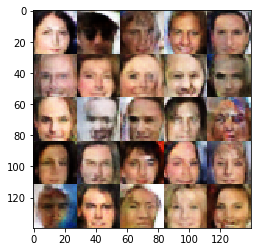

Epoch 6/10... Discriminator Loss: 1.2164... Generator Loss: 0.8729
Epoch 6/10... Discriminator Loss: 1.2375... Generator Loss: 0.8172
Epoch 6/10... Discriminator Loss: 1.2161... Generator Loss: 0.8880
Epoch 6/10... Discriminator Loss: 1.2550... Generator Loss: 0.7126
Epoch 6/10... Discriminator Loss: 1.1310... Generator Loss: 0.8900
Epoch 6/10... Discriminator Loss: 1.1695... Generator Loss: 0.9223
Epoch 6/10... Discriminator Loss: 1.1417... Generator Loss: 0.9807
Epoch 6/10... Discriminator Loss: 1.1123... Generator Loss: 0.8967
Epoch 6/10... Discriminator Loss: 1.1383... Generator Loss: 0.9267
Epoch 6/10... Discriminator Loss: 1.2002... Generator Loss: 0.8594


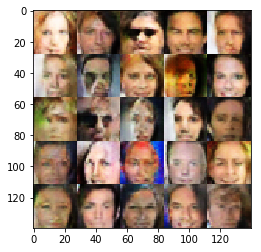

Epoch 6/10... Discriminator Loss: 1.3548... Generator Loss: 0.7589
Epoch 6/10... Discriminator Loss: 1.2515... Generator Loss: 0.8137
Epoch 6/10... Discriminator Loss: 1.1490... Generator Loss: 0.7853
Epoch 6/10... Discriminator Loss: 1.2349... Generator Loss: 0.8620
Epoch 6/10... Discriminator Loss: 1.2299... Generator Loss: 0.8368
Epoch 6/10... Discriminator Loss: 1.2760... Generator Loss: 0.7514
Epoch 6/10... Discriminator Loss: 1.1771... Generator Loss: 0.8229
Epoch 6/10... Discriminator Loss: 1.2334... Generator Loss: 0.7315
Epoch 6/10... Discriminator Loss: 1.0904... Generator Loss: 1.0111
Epoch 6/10... Discriminator Loss: 1.1406... Generator Loss: 0.9735


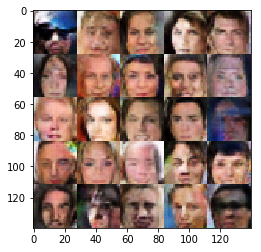

Epoch 6/10... Discriminator Loss: 1.3776... Generator Loss: 0.6646
Epoch 6/10... Discriminator Loss: 1.2469... Generator Loss: 0.8911
Epoch 6/10... Discriminator Loss: 1.3012... Generator Loss: 0.7425
Epoch 6/10... Discriminator Loss: 1.2141... Generator Loss: 0.8971
Epoch 6/10... Discriminator Loss: 1.2238... Generator Loss: 0.8218
Epoch 6/10... Discriminator Loss: 1.1777... Generator Loss: 0.8917
Epoch 6/10... Discriminator Loss: 1.3005... Generator Loss: 0.7669
Epoch 6/10... Discriminator Loss: 1.1671... Generator Loss: 0.8761
Epoch 6/10... Discriminator Loss: 1.2701... Generator Loss: 0.7798
Epoch 6/10... Discriminator Loss: 1.2762... Generator Loss: 0.7796


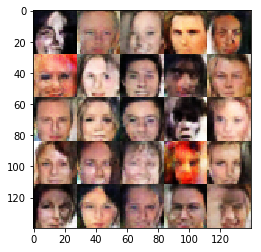

Epoch 6/10... Discriminator Loss: 1.0906... Generator Loss: 0.9436
Epoch 6/10... Discriminator Loss: 1.2249... Generator Loss: 0.7505
Epoch 6/10... Discriminator Loss: 1.1617... Generator Loss: 0.8483
Epoch 6/10... Discriminator Loss: 1.1689... Generator Loss: 0.9062
Epoch 6/10... Discriminator Loss: 1.2611... Generator Loss: 0.8049
Epoch 6/10... Discriminator Loss: 1.0968... Generator Loss: 0.9003
Epoch 6/10... Discriminator Loss: 1.1542... Generator Loss: 0.8782
Epoch 6/10... Discriminator Loss: 1.2468... Generator Loss: 0.8449
Epoch 6/10... Discriminator Loss: 1.1570... Generator Loss: 0.9945
Epoch 6/10... Discriminator Loss: 1.2782... Generator Loss: 0.7169


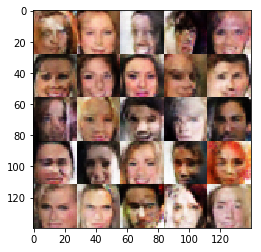

Epoch 6/10... Discriminator Loss: 1.4511... Generator Loss: 0.5957
Epoch 6/10... Discriminator Loss: 1.1379... Generator Loss: 0.8623
Epoch 6/10... Discriminator Loss: 1.2596... Generator Loss: 0.7195
Epoch 6/10... Discriminator Loss: 1.1461... Generator Loss: 0.8366
Epoch 6/10... Discriminator Loss: 1.2298... Generator Loss: 0.9079
Epoch 6/10... Discriminator Loss: 1.3614... Generator Loss: 0.6481
Epoch 6/10... Discriminator Loss: 1.2752... Generator Loss: 0.6983
Epoch 6/10... Discriminator Loss: 1.1821... Generator Loss: 0.8572
Epoch 6/10... Discriminator Loss: 1.2051... Generator Loss: 0.8868
Epoch 6/10... Discriminator Loss: 1.2574... Generator Loss: 0.8359


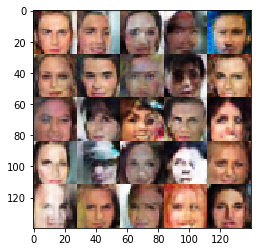

Epoch 6/10... Discriminator Loss: 1.1731... Generator Loss: 0.9624
Epoch 6/10... Discriminator Loss: 1.1996... Generator Loss: 0.8656
Epoch 6/10... Discriminator Loss: 1.0065... Generator Loss: 1.0713
Epoch 6/10... Discriminator Loss: 1.1728... Generator Loss: 0.8164
Epoch 6/10... Discriminator Loss: 1.3633... Generator Loss: 0.6968
Epoch 6/10... Discriminator Loss: 1.1268... Generator Loss: 0.9311
Epoch 6/10... Discriminator Loss: 1.2401... Generator Loss: 0.8907
Epoch 6/10... Discriminator Loss: 1.2224... Generator Loss: 0.8491
Epoch 6/10... Discriminator Loss: 1.2385... Generator Loss: 0.7301
Epoch 6/10... Discriminator Loss: 1.2535... Generator Loss: 0.8887


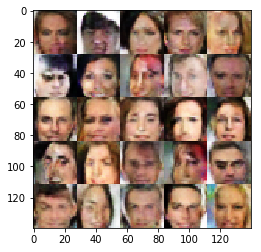

Epoch 6/10... Discriminator Loss: 1.3134... Generator Loss: 0.7545
Epoch 6/10... Discriminator Loss: 1.2991... Generator Loss: 0.8002
Epoch 6/10... Discriminator Loss: 1.1448... Generator Loss: 0.8540
Epoch 6/10... Discriminator Loss: 1.3760... Generator Loss: 0.6796
Epoch 6/10... Discriminator Loss: 1.2322... Generator Loss: 0.8433
Epoch 6/10... Discriminator Loss: 2.4135... Generator Loss: 1.1994
Epoch 6/10... Discriminator Loss: 2.6414... Generator Loss: 0.9308
Epoch 6/10... Discriminator Loss: 1.4748... Generator Loss: 0.7860
Epoch 6/10... Discriminator Loss: 1.6609... Generator Loss: 0.9410
Epoch 6/10... Discriminator Loss: 1.3783... Generator Loss: 0.7184


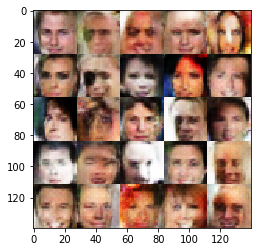

Epoch 6/10... Discriminator Loss: 1.3087... Generator Loss: 0.7519
Epoch 6/10... Discriminator Loss: 1.3496... Generator Loss: 0.7426
Epoch 6/10... Discriminator Loss: 1.2206... Generator Loss: 0.8988
Epoch 6/10... Discriminator Loss: 1.2224... Generator Loss: 0.8464
Epoch 6/10... Discriminator Loss: 1.3025... Generator Loss: 0.7665
Epoch 6/10... Discriminator Loss: 1.2755... Generator Loss: 0.7303
Epoch 6/10... Discriminator Loss: 1.3166... Generator Loss: 0.7615
Epoch 6/10... Discriminator Loss: 1.2745... Generator Loss: 0.7924
Epoch 6/10... Discriminator Loss: 1.1876... Generator Loss: 0.8526
Epoch 6/10... Discriminator Loss: 1.2046... Generator Loss: 0.7884


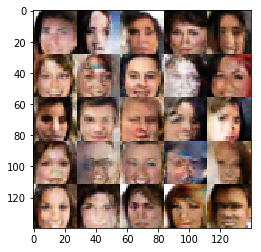

Epoch 6/10... Discriminator Loss: 1.1970... Generator Loss: 0.9098
Epoch 6/10... Discriminator Loss: 1.2721... Generator Loss: 0.8180
Epoch 6/10... Discriminator Loss: 1.2230... Generator Loss: 0.8366
Epoch 6/10... Discriminator Loss: 1.2472... Generator Loss: 0.7887
Epoch 6/10... Discriminator Loss: 1.2166... Generator Loss: 0.8210
Epoch 6/10... Discriminator Loss: 1.1524... Generator Loss: 0.9516
Epoch 6/10... Discriminator Loss: 1.2760... Generator Loss: 0.8059
Epoch 6/10... Discriminator Loss: 1.2895... Generator Loss: 0.7392
Epoch 6/10... Discriminator Loss: 1.2258... Generator Loss: 0.8213
Epoch 6/10... Discriminator Loss: 1.3347... Generator Loss: 0.7686


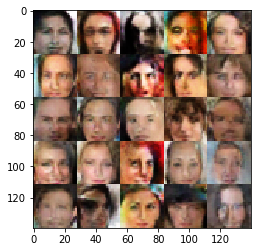

Epoch 6/10... Discriminator Loss: 1.2401... Generator Loss: 0.8124
Epoch 6/10... Discriminator Loss: 1.2725... Generator Loss: 0.8056
Epoch 6/10... Discriminator Loss: 1.2061... Generator Loss: 0.8411
Epoch 6/10... Discriminator Loss: 1.2066... Generator Loss: 0.8262
Epoch 6/10... Discriminator Loss: 1.1862... Generator Loss: 0.8917
Epoch 6/10... Discriminator Loss: 1.2768... Generator Loss: 0.9269
Epoch 6/10... Discriminator Loss: 1.1674... Generator Loss: 0.8761
Epoch 6/10... Discriminator Loss: 1.1041... Generator Loss: 0.9051
Epoch 6/10... Discriminator Loss: 1.2651... Generator Loss: 0.8140
Epoch 6/10... Discriminator Loss: 1.1614... Generator Loss: 0.8106


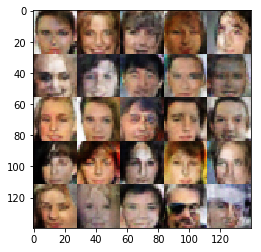

Epoch 6/10... Discriminator Loss: 1.1932... Generator Loss: 0.9477
Epoch 6/10... Discriminator Loss: 1.1578... Generator Loss: 0.9602
Epoch 6/10... Discriminator Loss: 1.2220... Generator Loss: 0.8580
Epoch 6/10... Discriminator Loss: 1.1976... Generator Loss: 0.8629
Epoch 6/10... Discriminator Loss: 1.2976... Generator Loss: 0.7405
Epoch 6/10... Discriminator Loss: 1.2830... Generator Loss: 0.7605
Epoch 6/10... Discriminator Loss: 1.3368... Generator Loss: 0.7486
Epoch 6/10... Discriminator Loss: 1.1425... Generator Loss: 0.8317
Epoch 6/10... Discriminator Loss: 1.3045... Generator Loss: 0.8000
Epoch 6/10... Discriminator Loss: 1.3797... Generator Loss: 0.6677


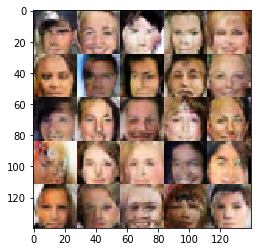

Epoch 6/10... Discriminator Loss: 1.2233... Generator Loss: 0.7988
Epoch 6/10... Discriminator Loss: 1.3643... Generator Loss: 0.7423
Epoch 6/10... Discriminator Loss: 1.2808... Generator Loss: 0.8714
Epoch 6/10... Discriminator Loss: 1.2109... Generator Loss: 0.8404
Epoch 6/10... Discriminator Loss: 1.2868... Generator Loss: 0.7852
Epoch 6/10... Discriminator Loss: 1.1626... Generator Loss: 0.8642
Epoch 6/10... Discriminator Loss: 1.1167... Generator Loss: 0.9182
Epoch 6/10... Discriminator Loss: 1.1688... Generator Loss: 0.8682
Epoch 6/10... Discriminator Loss: 1.2460... Generator Loss: 0.7709
Epoch 6/10... Discriminator Loss: 1.2234... Generator Loss: 0.8786


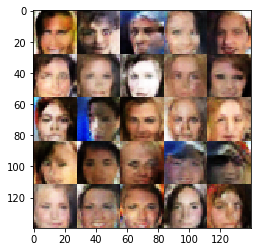

Epoch 6/10... Discriminator Loss: 1.1686... Generator Loss: 0.9232
Epoch 6/10... Discriminator Loss: 1.3161... Generator Loss: 0.7487
Epoch 6/10... Discriminator Loss: 1.3094... Generator Loss: 0.8140
Epoch 6/10... Discriminator Loss: 1.2566... Generator Loss: 0.8674
Epoch 6/10... Discriminator Loss: 1.1834... Generator Loss: 0.8381
Epoch 6/10... Discriminator Loss: 1.2076... Generator Loss: 0.8776
Epoch 6/10... Discriminator Loss: 1.1208... Generator Loss: 0.8751
Epoch 6/10... Discriminator Loss: 1.3020... Generator Loss: 0.6361
Epoch 6/10... Discriminator Loss: 1.0846... Generator Loss: 1.0280
Epoch 6/10... Discriminator Loss: 1.2102... Generator Loss: 0.8199


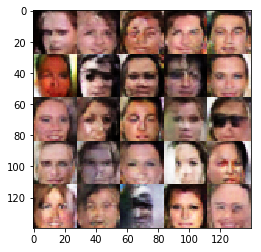

Epoch 6/10... Discriminator Loss: 1.1687... Generator Loss: 0.9481
Epoch 6/10... Discriminator Loss: 1.2297... Generator Loss: 0.8627
Epoch 6/10... Discriminator Loss: 1.2410... Generator Loss: 0.8977
Epoch 6/10... Discriminator Loss: 1.1442... Generator Loss: 0.8420
Epoch 6/10... Discriminator Loss: 1.2580... Generator Loss: 0.7236
Epoch 6/10... Discriminator Loss: 1.5874... Generator Loss: 0.5081
Epoch 6/10... Discriminator Loss: 1.1108... Generator Loss: 0.9408
Epoch 6/10... Discriminator Loss: 1.1971... Generator Loss: 0.8479
Epoch 6/10... Discriminator Loss: 1.1848... Generator Loss: 0.8490
Epoch 6/10... Discriminator Loss: 1.2103... Generator Loss: 0.9128


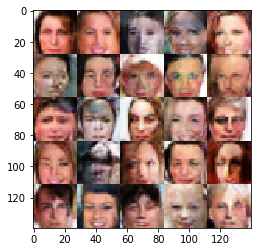

Epoch 6/10... Discriminator Loss: 1.2383... Generator Loss: 0.7320
Epoch 6/10... Discriminator Loss: 1.2172... Generator Loss: 0.8231
Epoch 6/10... Discriminator Loss: 1.1592... Generator Loss: 0.8685
Epoch 6/10... Discriminator Loss: 1.1664... Generator Loss: 0.8355
Epoch 6/10... Discriminator Loss: 1.2814... Generator Loss: 0.9680
Epoch 6/10... Discriminator Loss: 1.0181... Generator Loss: 0.9277
Epoch 6/10... Discriminator Loss: 1.2054... Generator Loss: 0.8069
Epoch 6/10... Discriminator Loss: 1.3473... Generator Loss: 0.7316
Epoch 6/10... Discriminator Loss: 1.1756... Generator Loss: 0.8910
Epoch 6/10... Discriminator Loss: 1.2648... Generator Loss: 0.7247


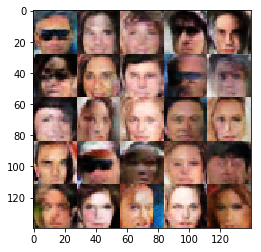

Epoch 6/10... Discriminator Loss: 1.0587... Generator Loss: 0.9114
Epoch 6/10... Discriminator Loss: 1.4546... Generator Loss: 0.5972
Epoch 6/10... Discriminator Loss: 1.0584... Generator Loss: 1.1581
Epoch 6/10... Discriminator Loss: 1.1932... Generator Loss: 0.8280
Epoch 6/10... Discriminator Loss: 1.2360... Generator Loss: 0.8013
Epoch 6/10... Discriminator Loss: 1.2900... Generator Loss: 0.9335
Epoch 6/10... Discriminator Loss: 1.0336... Generator Loss: 0.9924
Epoch 6/10... Discriminator Loss: 1.1810... Generator Loss: 0.8165
Epoch 6/10... Discriminator Loss: 1.1357... Generator Loss: 0.8854
Epoch 6/10... Discriminator Loss: 1.2619... Generator Loss: 0.8546


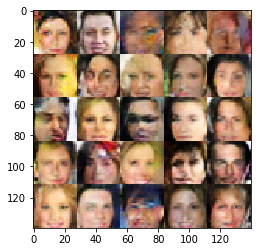

Epoch 6/10... Discriminator Loss: 1.3198... Generator Loss: 1.0736
Epoch 6/10... Discriminator Loss: 1.2437... Generator Loss: 0.8000
Epoch 6/10... Discriminator Loss: 1.1950... Generator Loss: 1.2946
Epoch 6/10... Discriminator Loss: 1.2447... Generator Loss: 0.8752
Epoch 6/10... Discriminator Loss: 1.1898... Generator Loss: 0.8274
Epoch 6/10... Discriminator Loss: 1.2988... Generator Loss: 0.6841
Epoch 6/10... Discriminator Loss: 1.1417... Generator Loss: 0.8810
Epoch 6/10... Discriminator Loss: 1.2914... Generator Loss: 0.7207
Epoch 6/10... Discriminator Loss: 1.2303... Generator Loss: 0.8298
Epoch 6/10... Discriminator Loss: 1.3374... Generator Loss: 0.7865


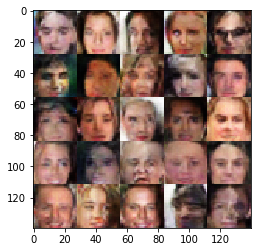

Epoch 6/10... Discriminator Loss: 1.1615... Generator Loss: 0.9075
Epoch 6/10... Discriminator Loss: 1.2473... Generator Loss: 0.8078
Epoch 6/10... Discriminator Loss: 1.2079... Generator Loss: 0.8304
Epoch 6/10... Discriminator Loss: 1.2184... Generator Loss: 0.8355
Epoch 6/10... Discriminator Loss: 1.1527... Generator Loss: 1.0158
Epoch 6/10... Discriminator Loss: 1.1357... Generator Loss: 0.8240
Epoch 6/10... Discriminator Loss: 1.1980... Generator Loss: 0.8511
Epoch 6/10... Discriminator Loss: 1.2027... Generator Loss: 0.9436
Epoch 6/10... Discriminator Loss: 1.2811... Generator Loss: 0.8000
Epoch 6/10... Discriminator Loss: 1.2040... Generator Loss: 0.8003


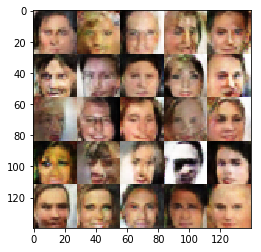

Epoch 6/10... Discriminator Loss: 1.2163... Generator Loss: 0.7926
Epoch 6/10... Discriminator Loss: 1.2942... Generator Loss: 0.7199
Epoch 6/10... Discriminator Loss: 1.2216... Generator Loss: 0.7853
Epoch 6/10... Discriminator Loss: 1.2026... Generator Loss: 0.7625
Epoch 6/10... Discriminator Loss: 1.2293... Generator Loss: 0.9613
Epoch 6/10... Discriminator Loss: 1.2186... Generator Loss: 0.9393
Epoch 6/10... Discriminator Loss: 1.1699... Generator Loss: 0.7990
Epoch 6/10... Discriminator Loss: 1.3486... Generator Loss: 0.8864
Epoch 6/10... Discriminator Loss: 1.1717... Generator Loss: 0.9349
Epoch 6/10... Discriminator Loss: 1.1090... Generator Loss: 1.2011


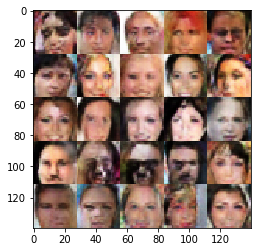

Epoch 6/10... Discriminator Loss: 1.2125... Generator Loss: 0.7697
Epoch 6/10... Discriminator Loss: 1.1593... Generator Loss: 0.8772
Epoch 6/10... Discriminator Loss: 1.2396... Generator Loss: 0.7996
Epoch 6/10... Discriminator Loss: 1.2109... Generator Loss: 0.8224
Epoch 6/10... Discriminator Loss: 1.2953... Generator Loss: 0.7759
Epoch 6/10... Discriminator Loss: 1.2097... Generator Loss: 0.8819
Epoch 6/10... Discriminator Loss: 1.1878... Generator Loss: 0.8110
Epoch 6/10... Discriminator Loss: 1.1078... Generator Loss: 1.0194
Epoch 6/10... Discriminator Loss: 1.2339... Generator Loss: 0.8165
Epoch 6/10... Discriminator Loss: 1.3367... Generator Loss: 0.7991


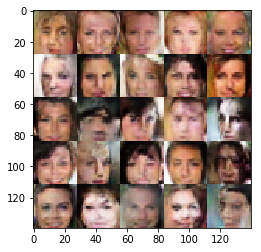

Epoch 6/10... Discriminator Loss: 1.0789... Generator Loss: 1.2069
Epoch 6/10... Discriminator Loss: 1.1355... Generator Loss: 0.8901
Epoch 6/10... Discriminator Loss: 1.1942... Generator Loss: 0.7714
Epoch 6/10... Discriminator Loss: 1.1678... Generator Loss: 0.8370
Epoch 6/10... Discriminator Loss: 1.1123... Generator Loss: 0.9552
Epoch 6/10... Discriminator Loss: 1.2485... Generator Loss: 0.7970
Epoch 6/10... Discriminator Loss: 1.3765... Generator Loss: 0.8405
Epoch 6/10... Discriminator Loss: 1.3087... Generator Loss: 0.7654
Epoch 6/10... Discriminator Loss: 1.1029... Generator Loss: 0.9452
Epoch 6/10... Discriminator Loss: 1.1895... Generator Loss: 0.8698


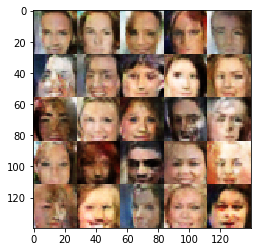

Epoch 6/10... Discriminator Loss: 1.2276... Generator Loss: 0.7367
Epoch 6/10... Discriminator Loss: 1.1213... Generator Loss: 0.9457
Epoch 6/10... Discriminator Loss: 1.2527... Generator Loss: 0.7663
Epoch 6/10... Discriminator Loss: 1.2591... Generator Loss: 0.8155
Epoch 6/10... Discriminator Loss: 1.2205... Generator Loss: 0.9019
Epoch 6/10... Discriminator Loss: 1.2125... Generator Loss: 0.7931
Epoch 6/10... Discriminator Loss: 1.1991... Generator Loss: 0.7934
Epoch 6/10... Discriminator Loss: 1.2488... Generator Loss: 0.8901
Epoch 6/10... Discriminator Loss: 1.1614... Generator Loss: 0.8536
Epoch 6/10... Discriminator Loss: 1.2292... Generator Loss: 0.8061


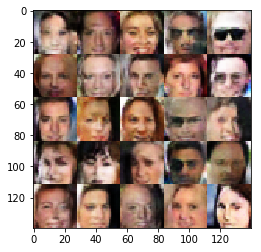

Epoch 6/10... Discriminator Loss: 1.3449... Generator Loss: 0.7458
Epoch 6/10... Discriminator Loss: 1.3053... Generator Loss: 0.7909
Epoch 6/10... Discriminator Loss: 1.2331... Generator Loss: 0.8779
Epoch 6/10... Discriminator Loss: 1.1144... Generator Loss: 0.8192
Epoch 6/10... Discriminator Loss: 1.1975... Generator Loss: 0.8091
Epoch 6/10... Discriminator Loss: 1.1536... Generator Loss: 0.8739
Epoch 6/10... Discriminator Loss: 1.2820... Generator Loss: 0.6997
Epoch 6/10... Discriminator Loss: 1.2596... Generator Loss: 0.6806
Epoch 6/10... Discriminator Loss: 1.1869... Generator Loss: 0.8086
Epoch 6/10... Discriminator Loss: 1.1156... Generator Loss: 1.0173


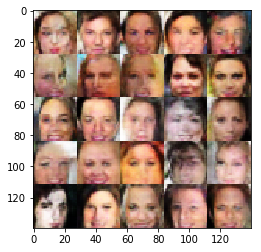

Epoch 6/10... Discriminator Loss: 1.2093... Generator Loss: 0.8652
Epoch 6/10... Discriminator Loss: 1.0995... Generator Loss: 0.9382
Epoch 6/10... Discriminator Loss: 1.2542... Generator Loss: 0.7727
Epoch 6/10... Discriminator Loss: 1.3183... Generator Loss: 0.7591
Epoch 6/10... Discriminator Loss: 1.2151... Generator Loss: 0.8028
Epoch 6/10... Discriminator Loss: 1.0419... Generator Loss: 1.0438
Epoch 6/10... Discriminator Loss: 1.1826... Generator Loss: 0.8667
Epoch 6/10... Discriminator Loss: 1.1571... Generator Loss: 0.8865
Epoch 6/10... Discriminator Loss: 1.2565... Generator Loss: 0.8571
Epoch 7/10... Discriminator Loss: 1.1953... Generator Loss: 0.8405


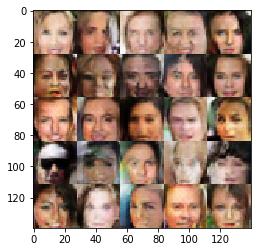

Epoch 7/10... Discriminator Loss: 1.1082... Generator Loss: 1.1025
Epoch 7/10... Discriminator Loss: 1.0900... Generator Loss: 0.9214
Epoch 7/10... Discriminator Loss: 1.2562... Generator Loss: 0.7346
Epoch 7/10... Discriminator Loss: 1.1688... Generator Loss: 0.8093
Epoch 7/10... Discriminator Loss: 1.1219... Generator Loss: 0.9590
Epoch 7/10... Discriminator Loss: 1.1292... Generator Loss: 0.9611
Epoch 7/10... Discriminator Loss: 1.2668... Generator Loss: 0.7697
Epoch 7/10... Discriminator Loss: 1.1539... Generator Loss: 0.8350
Epoch 7/10... Discriminator Loss: 1.1762... Generator Loss: 0.8706
Epoch 7/10... Discriminator Loss: 1.2209... Generator Loss: 0.7932


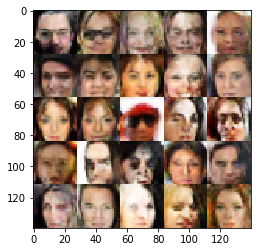

Epoch 7/10... Discriminator Loss: 1.3545... Generator Loss: 0.6858
Epoch 7/10... Discriminator Loss: 1.3114... Generator Loss: 0.7199
Epoch 7/10... Discriminator Loss: 1.1711... Generator Loss: 0.7773
Epoch 7/10... Discriminator Loss: 1.2732... Generator Loss: 0.7510
Epoch 7/10... Discriminator Loss: 1.2152... Generator Loss: 0.8861
Epoch 7/10... Discriminator Loss: 1.1922... Generator Loss: 0.9465
Epoch 7/10... Discriminator Loss: 1.3794... Generator Loss: 0.9253
Epoch 7/10... Discriminator Loss: 1.2019... Generator Loss: 0.7918
Epoch 7/10... Discriminator Loss: 1.2262... Generator Loss: 0.8428
Epoch 7/10... Discriminator Loss: 1.1826... Generator Loss: 0.8439


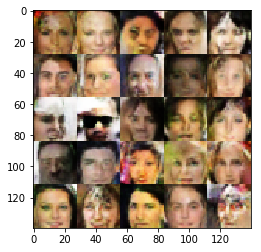

Epoch 7/10... Discriminator Loss: 1.1769... Generator Loss: 0.8748
Epoch 7/10... Discriminator Loss: 1.4672... Generator Loss: 0.7870
Epoch 7/10... Discriminator Loss: 1.1505... Generator Loss: 0.9608
Epoch 7/10... Discriminator Loss: 1.1460... Generator Loss: 0.9606
Epoch 7/10... Discriminator Loss: 1.2897... Generator Loss: 0.7073
Epoch 7/10... Discriminator Loss: 1.1385... Generator Loss: 1.0176
Epoch 7/10... Discriminator Loss: 1.2234... Generator Loss: 0.9236
Epoch 7/10... Discriminator Loss: 1.0637... Generator Loss: 0.9000
Epoch 7/10... Discriminator Loss: 1.3080... Generator Loss: 0.7266
Epoch 7/10... Discriminator Loss: 1.2381... Generator Loss: 0.8506


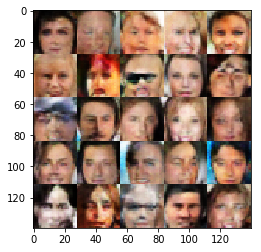

Epoch 7/10... Discriminator Loss: 1.3104... Generator Loss: 0.7604
Epoch 7/10... Discriminator Loss: 1.2371... Generator Loss: 0.8278
Epoch 7/10... Discriminator Loss: 1.3368... Generator Loss: 0.7758
Epoch 7/10... Discriminator Loss: 1.1114... Generator Loss: 0.9104
Epoch 7/10... Discriminator Loss: 1.3068... Generator Loss: 0.6849
Epoch 7/10... Discriminator Loss: 1.2791... Generator Loss: 0.7110
Epoch 7/10... Discriminator Loss: 1.1786... Generator Loss: 0.8162
Epoch 7/10... Discriminator Loss: 1.3287... Generator Loss: 0.7373
Epoch 7/10... Discriminator Loss: 1.4204... Generator Loss: 0.8328
Epoch 7/10... Discriminator Loss: 1.1733... Generator Loss: 0.9107


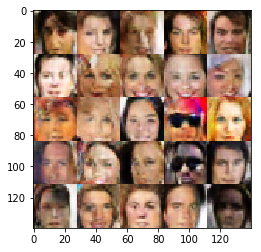

Epoch 7/10... Discriminator Loss: 1.1350... Generator Loss: 1.0970
Epoch 7/10... Discriminator Loss: 1.2132... Generator Loss: 0.7839
Epoch 7/10... Discriminator Loss: 1.2618... Generator Loss: 0.8174
Epoch 7/10... Discriminator Loss: 1.3018... Generator Loss: 0.7850
Epoch 7/10... Discriminator Loss: 1.0141... Generator Loss: 1.0796
Epoch 7/10... Discriminator Loss: 1.1484... Generator Loss: 0.8280
Epoch 7/10... Discriminator Loss: 1.0114... Generator Loss: 1.0691
Epoch 7/10... Discriminator Loss: 1.2573... Generator Loss: 0.7633
Epoch 7/10... Discriminator Loss: 1.3450... Generator Loss: 0.8490
Epoch 7/10... Discriminator Loss: 1.2808... Generator Loss: 0.8209


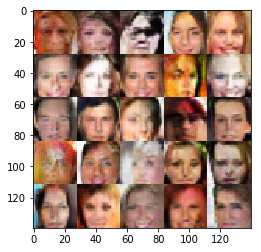

Epoch 7/10... Discriminator Loss: 1.3011... Generator Loss: 0.7960
Epoch 7/10... Discriminator Loss: 1.2039... Generator Loss: 0.8742
Epoch 7/10... Discriminator Loss: 1.4281... Generator Loss: 0.6833
Epoch 7/10... Discriminator Loss: 1.1202... Generator Loss: 1.0422
Epoch 7/10... Discriminator Loss: 1.1295... Generator Loss: 0.9664
Epoch 7/10... Discriminator Loss: 1.3549... Generator Loss: 0.6040
Epoch 7/10... Discriminator Loss: 1.2154... Generator Loss: 0.8470
Epoch 7/10... Discriminator Loss: 1.2699... Generator Loss: 0.8580
Epoch 7/10... Discriminator Loss: 1.0885... Generator Loss: 0.9731
Epoch 7/10... Discriminator Loss: 1.1515... Generator Loss: 0.8878


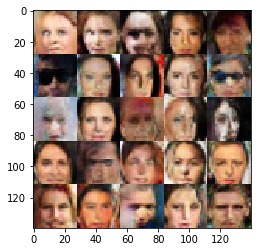

Epoch 7/10... Discriminator Loss: 1.1003... Generator Loss: 0.9462
Epoch 7/10... Discriminator Loss: 1.3349... Generator Loss: 0.7488
Epoch 7/10... Discriminator Loss: 1.1764... Generator Loss: 0.8531
Epoch 7/10... Discriminator Loss: 1.3283... Generator Loss: 0.7076
Epoch 7/10... Discriminator Loss: 1.1522... Generator Loss: 0.9736
Epoch 7/10... Discriminator Loss: 1.4361... Generator Loss: 0.7708
Epoch 7/10... Discriminator Loss: 1.2603... Generator Loss: 0.8989
Epoch 7/10... Discriminator Loss: 1.5426... Generator Loss: 0.5069
Epoch 7/10... Discriminator Loss: 1.3212... Generator Loss: 0.8608
Epoch 7/10... Discriminator Loss: 1.1864... Generator Loss: 1.0855


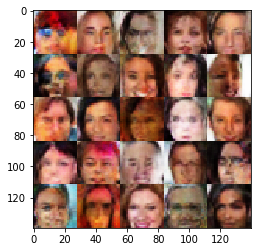

Epoch 7/10... Discriminator Loss: 1.1152... Generator Loss: 0.8523
Epoch 7/10... Discriminator Loss: 1.2193... Generator Loss: 0.8039
Epoch 7/10... Discriminator Loss: 1.2676... Generator Loss: 0.7027
Epoch 7/10... Discriminator Loss: 1.1322... Generator Loss: 0.9255
Epoch 7/10... Discriminator Loss: 1.1990... Generator Loss: 0.8336
Epoch 7/10... Discriminator Loss: 1.0868... Generator Loss: 0.9183
Epoch 7/10... Discriminator Loss: 1.1085... Generator Loss: 1.0321
Epoch 7/10... Discriminator Loss: 1.2504... Generator Loss: 0.8089
Epoch 7/10... Discriminator Loss: 1.2654... Generator Loss: 0.8210
Epoch 7/10... Discriminator Loss: 1.3272... Generator Loss: 0.7540


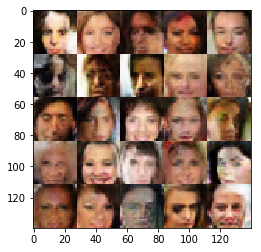

Epoch 7/10... Discriminator Loss: 1.2827... Generator Loss: 0.9155
Epoch 7/10... Discriminator Loss: 1.3963... Generator Loss: 0.6915
Epoch 7/10... Discriminator Loss: 1.2262... Generator Loss: 0.7468
Epoch 7/10... Discriminator Loss: 1.2527... Generator Loss: 0.8865
Epoch 7/10... Discriminator Loss: 1.2019... Generator Loss: 0.7806
Epoch 7/10... Discriminator Loss: 1.1709... Generator Loss: 0.8366
Epoch 7/10... Discriminator Loss: 1.2844... Generator Loss: 0.7788
Epoch 7/10... Discriminator Loss: 1.5112... Generator Loss: 0.5746
Epoch 7/10... Discriminator Loss: 1.1231... Generator Loss: 0.9513
Epoch 7/10... Discriminator Loss: 1.4333... Generator Loss: 0.5681


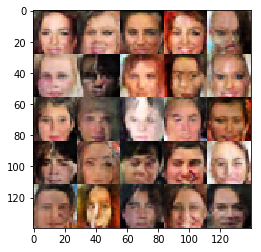

Epoch 7/10... Discriminator Loss: 1.1893... Generator Loss: 0.9019
Epoch 7/10... Discriminator Loss: 1.2413... Generator Loss: 0.8891
Epoch 7/10... Discriminator Loss: 1.1870... Generator Loss: 0.9236
Epoch 7/10... Discriminator Loss: 1.1422... Generator Loss: 0.8710
Epoch 7/10... Discriminator Loss: 1.1728... Generator Loss: 0.9295
Epoch 7/10... Discriminator Loss: 1.2788... Generator Loss: 0.7574
Epoch 7/10... Discriminator Loss: 1.1224... Generator Loss: 1.0528
Epoch 7/10... Discriminator Loss: 1.3164... Generator Loss: 0.9232
Epoch 7/10... Discriminator Loss: 1.3484... Generator Loss: 0.6953
Epoch 7/10... Discriminator Loss: 1.1190... Generator Loss: 0.8763


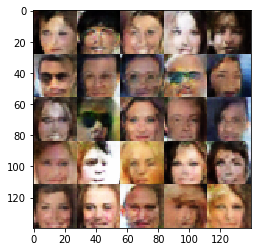

Epoch 7/10... Discriminator Loss: 1.1509... Generator Loss: 0.9233
Epoch 7/10... Discriminator Loss: 1.3297... Generator Loss: 0.6273
Epoch 7/10... Discriminator Loss: 1.1558... Generator Loss: 0.7920
Epoch 7/10... Discriminator Loss: 1.3086... Generator Loss: 0.7131
Epoch 7/10... Discriminator Loss: 1.3000... Generator Loss: 0.7067
Epoch 7/10... Discriminator Loss: 1.1313... Generator Loss: 0.9375
Epoch 7/10... Discriminator Loss: 1.1648... Generator Loss: 0.8164
Epoch 7/10... Discriminator Loss: 1.1868... Generator Loss: 0.7443
Epoch 7/10... Discriminator Loss: 1.2951... Generator Loss: 0.8300
Epoch 7/10... Discriminator Loss: 1.2697... Generator Loss: 0.7816


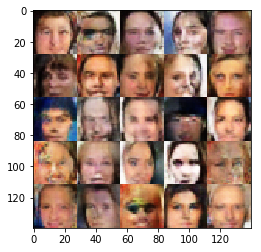

Epoch 7/10... Discriminator Loss: 1.1397... Generator Loss: 0.9416
Epoch 7/10... Discriminator Loss: 1.3477... Generator Loss: 0.6638
Epoch 7/10... Discriminator Loss: 1.2401... Generator Loss: 0.8892
Epoch 7/10... Discriminator Loss: 1.2026... Generator Loss: 0.9414
Epoch 7/10... Discriminator Loss: 1.2832... Generator Loss: 0.6758
Epoch 7/10... Discriminator Loss: 1.2816... Generator Loss: 0.7565
Epoch 7/10... Discriminator Loss: 1.2719... Generator Loss: 0.7543
Epoch 7/10... Discriminator Loss: 1.1264... Generator Loss: 0.9516
Epoch 7/10... Discriminator Loss: 1.2309... Generator Loss: 0.8576
Epoch 7/10... Discriminator Loss: 1.3403... Generator Loss: 0.7406


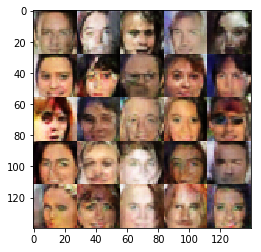

Epoch 7/10... Discriminator Loss: 1.3354... Generator Loss: 0.6025
Epoch 7/10... Discriminator Loss: 1.1916... Generator Loss: 1.0349
Epoch 7/10... Discriminator Loss: 1.2237... Generator Loss: 0.7892
Epoch 7/10... Discriminator Loss: 1.4678... Generator Loss: 0.7546
Epoch 7/10... Discriminator Loss: 1.1467... Generator Loss: 0.8144
Epoch 7/10... Discriminator Loss: 1.2427... Generator Loss: 0.8429
Epoch 7/10... Discriminator Loss: 1.2861... Generator Loss: 0.7540
Epoch 7/10... Discriminator Loss: 0.9802... Generator Loss: 0.9597
Epoch 7/10... Discriminator Loss: 1.2025... Generator Loss: 0.9527
Epoch 7/10... Discriminator Loss: 1.1919... Generator Loss: 0.7726


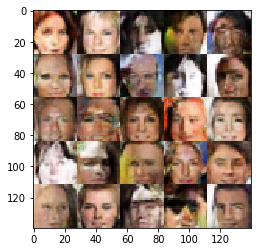

Epoch 7/10... Discriminator Loss: 1.1422... Generator Loss: 0.8678
Epoch 7/10... Discriminator Loss: 1.1562... Generator Loss: 0.8514
Epoch 7/10... Discriminator Loss: 1.1810... Generator Loss: 0.8787
Epoch 7/10... Discriminator Loss: 1.1655... Generator Loss: 0.8504
Epoch 7/10... Discriminator Loss: 1.2576... Generator Loss: 0.7813
Epoch 7/10... Discriminator Loss: 1.1767... Generator Loss: 0.8756
Epoch 7/10... Discriminator Loss: 1.3134... Generator Loss: 0.7397
Epoch 7/10... Discriminator Loss: 1.3481... Generator Loss: 0.7486
Epoch 7/10... Discriminator Loss: 1.2203... Generator Loss: 0.8309
Epoch 7/10... Discriminator Loss: 1.2225... Generator Loss: 0.7527


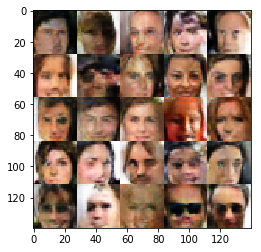

Epoch 7/10... Discriminator Loss: 1.2709... Generator Loss: 0.8517
Epoch 7/10... Discriminator Loss: 1.0690... Generator Loss: 0.9929
Epoch 7/10... Discriminator Loss: 1.1234... Generator Loss: 0.8981
Epoch 7/10... Discriminator Loss: 1.2695... Generator Loss: 0.7274
Epoch 7/10... Discriminator Loss: 1.1815... Generator Loss: 0.8186
Epoch 7/10... Discriminator Loss: 1.3360... Generator Loss: 0.6855
Epoch 7/10... Discriminator Loss: 1.2120... Generator Loss: 0.9271
Epoch 7/10... Discriminator Loss: 1.0652... Generator Loss: 0.9510
Epoch 7/10... Discriminator Loss: 1.5726... Generator Loss: 1.3566
Epoch 7/10... Discriminator Loss: 1.8705... Generator Loss: 0.8261


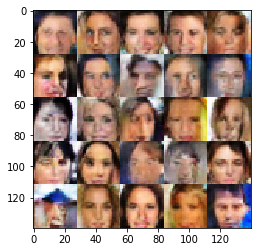

Epoch 7/10... Discriminator Loss: 1.3916... Generator Loss: 0.7856
Epoch 7/10... Discriminator Loss: 1.3190... Generator Loss: 0.8090
Epoch 7/10... Discriminator Loss: 1.1920... Generator Loss: 0.7935
Epoch 7/10... Discriminator Loss: 1.4348... Generator Loss: 0.7851
Epoch 7/10... Discriminator Loss: 1.2977... Generator Loss: 0.8196
Epoch 7/10... Discriminator Loss: 1.2002... Generator Loss: 0.8062
Epoch 7/10... Discriminator Loss: 1.3230... Generator Loss: 0.7303
Epoch 7/10... Discriminator Loss: 1.2446... Generator Loss: 0.7618
Epoch 7/10... Discriminator Loss: 1.2929... Generator Loss: 0.8052
Epoch 7/10... Discriminator Loss: 1.2548... Generator Loss: 0.7265


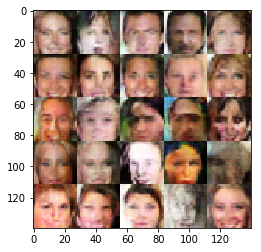

Epoch 7/10... Discriminator Loss: 1.3052... Generator Loss: 0.7467
Epoch 7/10... Discriminator Loss: 1.3209... Generator Loss: 0.6673
Epoch 7/10... Discriminator Loss: 1.1984... Generator Loss: 0.7941
Epoch 7/10... Discriminator Loss: 1.2595... Generator Loss: 0.7905
Epoch 7/10... Discriminator Loss: 1.1761... Generator Loss: 0.8056
Epoch 7/10... Discriminator Loss: 1.2156... Generator Loss: 0.8407
Epoch 7/10... Discriminator Loss: 1.1936... Generator Loss: 0.8310
Epoch 7/10... Discriminator Loss: 1.2245... Generator Loss: 0.8719
Epoch 7/10... Discriminator Loss: 1.3518... Generator Loss: 0.7362
Epoch 7/10... Discriminator Loss: 1.2828... Generator Loss: 0.7330


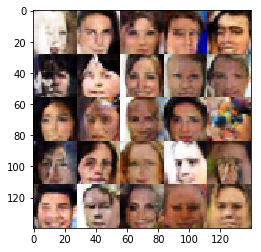

Epoch 7/10... Discriminator Loss: 1.1521... Generator Loss: 0.8281
Epoch 7/10... Discriminator Loss: 1.1254... Generator Loss: 0.8397
Epoch 7/10... Discriminator Loss: 1.2511... Generator Loss: 0.7849
Epoch 7/10... Discriminator Loss: 1.2398... Generator Loss: 0.7628
Epoch 7/10... Discriminator Loss: 1.2402... Generator Loss: 0.7725
Epoch 7/10... Discriminator Loss: 1.3388... Generator Loss: 0.6762
Epoch 7/10... Discriminator Loss: 1.4328... Generator Loss: 0.6978
Epoch 7/10... Discriminator Loss: 1.2781... Generator Loss: 0.7371
Epoch 7/10... Discriminator Loss: 1.2801... Generator Loss: 0.7252
Epoch 7/10... Discriminator Loss: 1.2344... Generator Loss: 0.8688


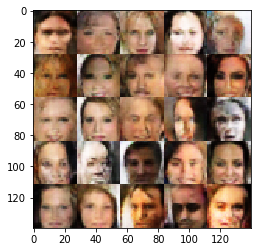

Epoch 7/10... Discriminator Loss: 1.2159... Generator Loss: 0.8791
Epoch 7/10... Discriminator Loss: 1.2555... Generator Loss: 0.8215
Epoch 7/10... Discriminator Loss: 1.2435... Generator Loss: 0.7760
Epoch 7/10... Discriminator Loss: 1.3230... Generator Loss: 0.7098
Epoch 7/10... Discriminator Loss: 1.2004... Generator Loss: 0.8261
Epoch 7/10... Discriminator Loss: 1.0861... Generator Loss: 0.9944
Epoch 7/10... Discriminator Loss: 1.2372... Generator Loss: 0.7433
Epoch 7/10... Discriminator Loss: 1.1294... Generator Loss: 0.9594
Epoch 7/10... Discriminator Loss: 1.2297... Generator Loss: 0.9195
Epoch 7/10... Discriminator Loss: 1.1740... Generator Loss: 0.8236


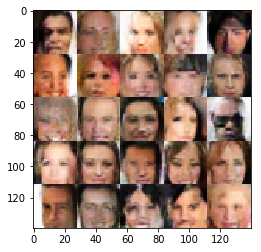

Epoch 7/10... Discriminator Loss: 1.2747... Generator Loss: 0.7533
Epoch 7/10... Discriminator Loss: 1.2380... Generator Loss: 0.8538
Epoch 7/10... Discriminator Loss: 1.4243... Generator Loss: 0.9168
Epoch 7/10... Discriminator Loss: 1.2319... Generator Loss: 0.8402
Epoch 7/10... Discriminator Loss: 1.1531... Generator Loss: 1.0337
Epoch 7/10... Discriminator Loss: 1.2708... Generator Loss: 0.7707
Epoch 7/10... Discriminator Loss: 0.9200... Generator Loss: 1.0852
Epoch 7/10... Discriminator Loss: 1.1880... Generator Loss: 0.9055
Epoch 7/10... Discriminator Loss: 1.1152... Generator Loss: 0.9015
Epoch 7/10... Discriminator Loss: 1.1700... Generator Loss: 0.9534


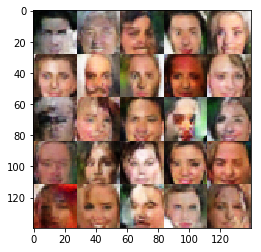

Epoch 7/10... Discriminator Loss: 1.1855... Generator Loss: 0.8764
Epoch 7/10... Discriminator Loss: 1.0763... Generator Loss: 1.0527
Epoch 7/10... Discriminator Loss: 1.1332... Generator Loss: 0.9074
Epoch 7/10... Discriminator Loss: 1.0975... Generator Loss: 0.8337
Epoch 7/10... Discriminator Loss: 1.2683... Generator Loss: 0.7595
Epoch 7/10... Discriminator Loss: 1.2008... Generator Loss: 0.8266
Epoch 7/10... Discriminator Loss: 1.1530... Generator Loss: 0.8818
Epoch 7/10... Discriminator Loss: 1.2835... Generator Loss: 0.6846
Epoch 7/10... Discriminator Loss: 1.0967... Generator Loss: 0.9019
Epoch 7/10... Discriminator Loss: 1.2235... Generator Loss: 0.8001


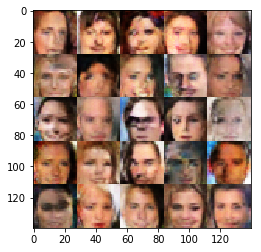

Epoch 7/10... Discriminator Loss: 1.2976... Generator Loss: 0.8324
Epoch 7/10... Discriminator Loss: 1.2150... Generator Loss: 0.8095
Epoch 7/10... Discriminator Loss: 1.3406... Generator Loss: 0.7724
Epoch 7/10... Discriminator Loss: 1.0982... Generator Loss: 0.9731
Epoch 7/10... Discriminator Loss: 1.1884... Generator Loss: 0.8011
Epoch 7/10... Discriminator Loss: 1.1577... Generator Loss: 0.8696
Epoch 7/10... Discriminator Loss: 1.1070... Generator Loss: 0.9111
Epoch 7/10... Discriminator Loss: 1.1551... Generator Loss: 1.0596
Epoch 7/10... Discriminator Loss: 1.2954... Generator Loss: 0.6783
Epoch 7/10... Discriminator Loss: 1.3119... Generator Loss: 0.8631


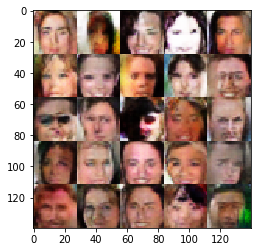

Epoch 7/10... Discriminator Loss: 1.2364... Generator Loss: 0.9229
Epoch 7/10... Discriminator Loss: 1.2543... Generator Loss: 0.7974
Epoch 7/10... Discriminator Loss: 1.3722... Generator Loss: 0.9007
Epoch 7/10... Discriminator Loss: 1.1474... Generator Loss: 0.9307
Epoch 7/10... Discriminator Loss: 1.2096... Generator Loss: 0.8476
Epoch 7/10... Discriminator Loss: 1.1481... Generator Loss: 0.8728
Epoch 7/10... Discriminator Loss: 1.3190... Generator Loss: 0.8787
Epoch 7/10... Discriminator Loss: 1.1668... Generator Loss: 0.8956
Epoch 7/10... Discriminator Loss: 0.9902... Generator Loss: 0.8767
Epoch 7/10... Discriminator Loss: 1.2071... Generator Loss: 1.0083


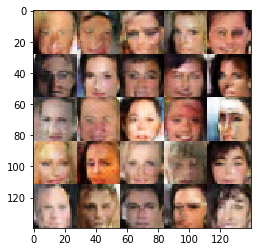

Epoch 7/10... Discriminator Loss: 1.1037... Generator Loss: 0.8847
Epoch 7/10... Discriminator Loss: 1.2255... Generator Loss: 0.9975
Epoch 7/10... Discriminator Loss: 1.3288... Generator Loss: 0.6806
Epoch 7/10... Discriminator Loss: 1.2404... Generator Loss: 0.8848
Epoch 7/10... Discriminator Loss: 1.4301... Generator Loss: 0.8368
Epoch 7/10... Discriminator Loss: 1.2293... Generator Loss: 0.8246
Epoch 7/10... Discriminator Loss: 1.3513... Generator Loss: 0.7096
Epoch 7/10... Discriminator Loss: 1.1352... Generator Loss: 0.8394
Epoch 7/10... Discriminator Loss: 1.3117... Generator Loss: 0.7480
Epoch 7/10... Discriminator Loss: 1.3384... Generator Loss: 0.6450


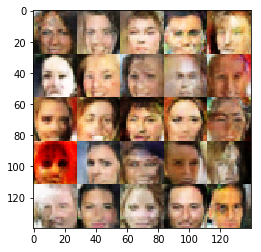

Epoch 7/10... Discriminator Loss: 1.4172... Generator Loss: 0.7331
Epoch 7/10... Discriminator Loss: 0.9848... Generator Loss: 1.0502
Epoch 7/10... Discriminator Loss: 1.0777... Generator Loss: 0.9462
Epoch 7/10... Discriminator Loss: 1.1677... Generator Loss: 0.8337
Epoch 7/10... Discriminator Loss: 1.2009... Generator Loss: 0.7862
Epoch 7/10... Discriminator Loss: 1.1955... Generator Loss: 0.7911
Epoch 7/10... Discriminator Loss: 1.1506... Generator Loss: 0.8036
Epoch 7/10... Discriminator Loss: 1.2743... Generator Loss: 0.8807
Epoch 7/10... Discriminator Loss: 1.1579... Generator Loss: 0.9473
Epoch 7/10... Discriminator Loss: 1.1369... Generator Loss: 0.9591


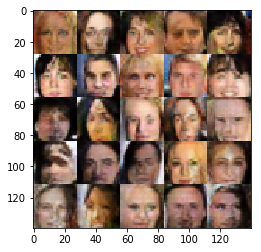

Epoch 7/10... Discriminator Loss: 1.1439... Generator Loss: 0.9774
Epoch 7/10... Discriminator Loss: 1.2704... Generator Loss: 0.7545
Epoch 7/10... Discriminator Loss: 1.2375... Generator Loss: 0.6813
Epoch 7/10... Discriminator Loss: 1.3566... Generator Loss: 0.7772
Epoch 7/10... Discriminator Loss: 1.2173... Generator Loss: 1.0528
Epoch 7/10... Discriminator Loss: 1.0413... Generator Loss: 0.8755
Epoch 7/10... Discriminator Loss: 1.2581... Generator Loss: 0.8009
Epoch 7/10... Discriminator Loss: 1.1363... Generator Loss: 0.8904
Epoch 7/10... Discriminator Loss: 1.2857... Generator Loss: 0.7965
Epoch 7/10... Discriminator Loss: 1.1188... Generator Loss: 0.8265


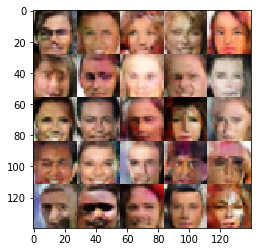

Epoch 7/10... Discriminator Loss: 1.2757... Generator Loss: 0.9571
Epoch 7/10... Discriminator Loss: 1.1517... Generator Loss: 0.8701
Epoch 7/10... Discriminator Loss: 1.2196... Generator Loss: 0.8706
Epoch 7/10... Discriminator Loss: 1.2377... Generator Loss: 0.8239
Epoch 7/10... Discriminator Loss: 1.1609... Generator Loss: 0.8654
Epoch 7/10... Discriminator Loss: 1.2812... Generator Loss: 0.8483
Epoch 7/10... Discriminator Loss: 1.2023... Generator Loss: 0.8400
Epoch 7/10... Discriminator Loss: 1.1216... Generator Loss: 0.8589
Epoch 7/10... Discriminator Loss: 1.2427... Generator Loss: 0.7735
Epoch 7/10... Discriminator Loss: 1.0325... Generator Loss: 0.9471


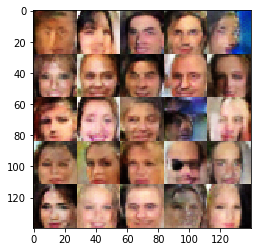

Epoch 7/10... Discriminator Loss: 1.2211... Generator Loss: 0.7682
Epoch 7/10... Discriminator Loss: 1.4147... Generator Loss: 0.7343
Epoch 7/10... Discriminator Loss: 1.3153... Generator Loss: 1.1953
Epoch 7/10... Discriminator Loss: 1.3649... Generator Loss: 0.7055
Epoch 7/10... Discriminator Loss: 1.1974... Generator Loss: 0.8014
Epoch 7/10... Discriminator Loss: 1.3782... Generator Loss: 0.6744
Epoch 7/10... Discriminator Loss: 1.1392... Generator Loss: 0.9897
Epoch 7/10... Discriminator Loss: 1.2646... Generator Loss: 0.9061
Epoch 7/10... Discriminator Loss: 1.2244... Generator Loss: 0.8566
Epoch 7/10... Discriminator Loss: 1.2981... Generator Loss: 0.6767


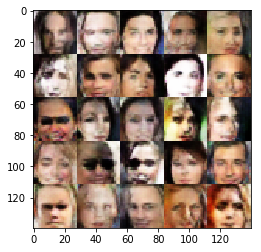

Epoch 7/10... Discriminator Loss: 0.9871... Generator Loss: 1.1240
Epoch 7/10... Discriminator Loss: 1.2332... Generator Loss: 0.9096
Epoch 7/10... Discriminator Loss: 1.1335... Generator Loss: 0.9163
Epoch 7/10... Discriminator Loss: 1.2659... Generator Loss: 0.7547
Epoch 7/10... Discriminator Loss: 1.2828... Generator Loss: 0.7255
Epoch 7/10... Discriminator Loss: 1.1797... Generator Loss: 0.9320
Epoch 7/10... Discriminator Loss: 1.2555... Generator Loss: 0.8015
Epoch 7/10... Discriminator Loss: 1.1755... Generator Loss: 0.9232
Epoch 7/10... Discriminator Loss: 1.2706... Generator Loss: 0.7152
Epoch 7/10... Discriminator Loss: 1.0912... Generator Loss: 0.9552


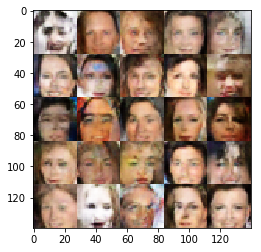

Epoch 7/10... Discriminator Loss: 0.9875... Generator Loss: 0.9802
Epoch 7/10... Discriminator Loss: 1.3463... Generator Loss: 0.7236
Epoch 7/10... Discriminator Loss: 1.2963... Generator Loss: 0.7425
Epoch 7/10... Discriminator Loss: 1.0961... Generator Loss: 0.9442
Epoch 7/10... Discriminator Loss: 1.1625... Generator Loss: 0.8745
Epoch 7/10... Discriminator Loss: 1.4095... Generator Loss: 0.6711
Epoch 7/10... Discriminator Loss: 1.2381... Generator Loss: 0.7573
Epoch 7/10... Discriminator Loss: 1.3156... Generator Loss: 0.7708
Epoch 7/10... Discriminator Loss: 1.3908... Generator Loss: 0.6457
Epoch 7/10... Discriminator Loss: 1.2524... Generator Loss: 0.7462


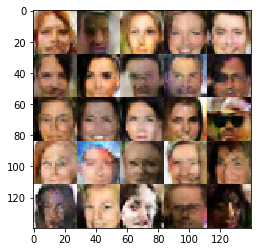

Epoch 7/10... Discriminator Loss: 1.3458... Generator Loss: 0.6831
Epoch 7/10... Discriminator Loss: 1.3203... Generator Loss: 0.7731
Epoch 7/10... Discriminator Loss: 1.2477... Generator Loss: 0.8439
Epoch 7/10... Discriminator Loss: 1.2017... Generator Loss: 0.7895
Epoch 7/10... Discriminator Loss: 1.2388... Generator Loss: 0.7454
Epoch 7/10... Discriminator Loss: 1.2150... Generator Loss: 0.7894
Epoch 7/10... Discriminator Loss: 1.2929... Generator Loss: 0.8202
Epoch 7/10... Discriminator Loss: 1.1816... Generator Loss: 0.8888
Epoch 7/10... Discriminator Loss: 1.3109... Generator Loss: 0.8626
Epoch 7/10... Discriminator Loss: 1.1581... Generator Loss: 0.8033


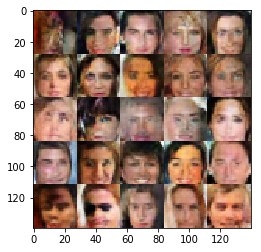

Epoch 7/10... Discriminator Loss: 1.0814... Generator Loss: 0.9939
Epoch 7/10... Discriminator Loss: 1.1712... Generator Loss: 0.8459
Epoch 7/10... Discriminator Loss: 1.2980... Generator Loss: 0.8166
Epoch 7/10... Discriminator Loss: 1.2377... Generator Loss: 0.8747
Epoch 7/10... Discriminator Loss: 1.1599... Generator Loss: 0.9375
Epoch 8/10... Discriminator Loss: 1.2403... Generator Loss: 0.7752
Epoch 8/10... Discriminator Loss: 1.3584... Generator Loss: 0.7404
Epoch 8/10... Discriminator Loss: 1.3641... Generator Loss: 0.7042
Epoch 8/10... Discriminator Loss: 1.1918... Generator Loss: 0.8124
Epoch 8/10... Discriminator Loss: 1.3724... Generator Loss: 0.7444


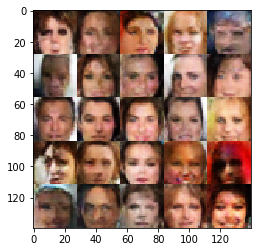

Epoch 8/10... Discriminator Loss: 1.2227... Generator Loss: 0.8208
Epoch 8/10... Discriminator Loss: 1.1757... Generator Loss: 0.9153
Epoch 8/10... Discriminator Loss: 1.1789... Generator Loss: 0.9140
Epoch 8/10... Discriminator Loss: 1.3426... Generator Loss: 1.0599
Epoch 8/10... Discriminator Loss: 1.1564... Generator Loss: 0.9000
Epoch 8/10... Discriminator Loss: 1.1034... Generator Loss: 0.9242
Epoch 8/10... Discriminator Loss: 1.2409... Generator Loss: 0.7552
Epoch 8/10... Discriminator Loss: 1.1151... Generator Loss: 0.9615
Epoch 8/10... Discriminator Loss: 1.2337... Generator Loss: 0.7647
Epoch 8/10... Discriminator Loss: 1.1714... Generator Loss: 0.9001


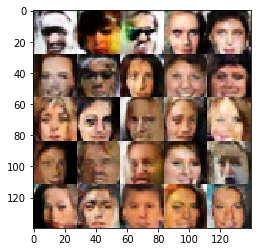

Epoch 8/10... Discriminator Loss: 1.2102... Generator Loss: 0.8646
Epoch 8/10... Discriminator Loss: 1.2522... Generator Loss: 0.8253
Epoch 8/10... Discriminator Loss: 1.2937... Generator Loss: 0.7167
Epoch 8/10... Discriminator Loss: 1.1292... Generator Loss: 0.8205
Epoch 8/10... Discriminator Loss: 1.0749... Generator Loss: 1.0037
Epoch 8/10... Discriminator Loss: 1.1916... Generator Loss: 0.7551
Epoch 8/10... Discriminator Loss: 1.1517... Generator Loss: 0.9108
Epoch 8/10... Discriminator Loss: 1.0744... Generator Loss: 1.1011
Epoch 8/10... Discriminator Loss: 1.1393... Generator Loss: 0.9593
Epoch 8/10... Discriminator Loss: 1.6288... Generator Loss: 0.5215


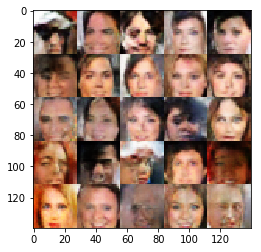

Epoch 8/10... Discriminator Loss: 1.2531... Generator Loss: 0.7903
Epoch 8/10... Discriminator Loss: 1.2075... Generator Loss: 0.9491
Epoch 8/10... Discriminator Loss: 1.3073... Generator Loss: 1.0613
Epoch 8/10... Discriminator Loss: 1.3917... Generator Loss: 0.8401
Epoch 8/10... Discriminator Loss: 1.1535... Generator Loss: 0.9768
Epoch 8/10... Discriminator Loss: 1.2754... Generator Loss: 0.8557
Epoch 8/10... Discriminator Loss: 1.2172... Generator Loss: 0.7875
Epoch 8/10... Discriminator Loss: 1.1270... Generator Loss: 0.8943
Epoch 8/10... Discriminator Loss: 1.3045... Generator Loss: 0.7775
Epoch 8/10... Discriminator Loss: 1.0584... Generator Loss: 1.2442


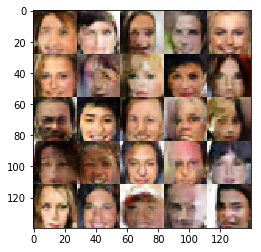

Epoch 8/10... Discriminator Loss: 1.1644... Generator Loss: 0.9370
Epoch 8/10... Discriminator Loss: 1.3404... Generator Loss: 0.7408
Epoch 8/10... Discriminator Loss: 1.0635... Generator Loss: 0.9635
Epoch 8/10... Discriminator Loss: 0.9864... Generator Loss: 1.0296
Epoch 8/10... Discriminator Loss: 1.1903... Generator Loss: 0.9120
Epoch 8/10... Discriminator Loss: 1.1028... Generator Loss: 0.8485
Epoch 8/10... Discriminator Loss: 1.1346... Generator Loss: 0.8321
Epoch 8/10... Discriminator Loss: 1.2268... Generator Loss: 0.7954
Epoch 8/10... Discriminator Loss: 1.2586... Generator Loss: 0.7744
Epoch 8/10... Discriminator Loss: 1.2608... Generator Loss: 0.7890


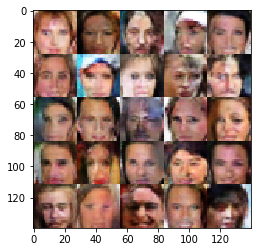

Epoch 8/10... Discriminator Loss: 1.0602... Generator Loss: 0.9258
Epoch 8/10... Discriminator Loss: 1.1929... Generator Loss: 0.9543
Epoch 8/10... Discriminator Loss: 1.1742... Generator Loss: 0.7849
Epoch 8/10... Discriminator Loss: 1.2223... Generator Loss: 0.7700
Epoch 8/10... Discriminator Loss: 1.2913... Generator Loss: 0.9900
Epoch 8/10... Discriminator Loss: 1.1669... Generator Loss: 0.7674
Epoch 8/10... Discriminator Loss: 1.1306... Generator Loss: 0.9193
Epoch 8/10... Discriminator Loss: 1.1424... Generator Loss: 0.8968
Epoch 8/10... Discriminator Loss: 1.2692... Generator Loss: 0.8969
Epoch 8/10... Discriminator Loss: 1.2849... Generator Loss: 0.8586


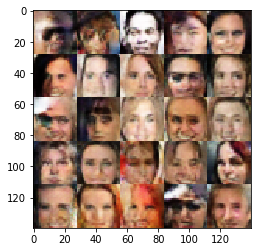

Epoch 8/10... Discriminator Loss: 1.4433... Generator Loss: 0.6410
Epoch 8/10... Discriminator Loss: 1.1666... Generator Loss: 1.0121
Epoch 8/10... Discriminator Loss: 1.3223... Generator Loss: 0.8671
Epoch 8/10... Discriminator Loss: 1.3070... Generator Loss: 0.7999
Epoch 8/10... Discriminator Loss: 1.3473... Generator Loss: 0.7153
Epoch 8/10... Discriminator Loss: 1.1149... Generator Loss: 0.9662
Epoch 8/10... Discriminator Loss: 1.2573... Generator Loss: 0.8288
Epoch 8/10... Discriminator Loss: 1.0722... Generator Loss: 0.9277
Epoch 8/10... Discriminator Loss: 1.2308... Generator Loss: 0.9131
Epoch 8/10... Discriminator Loss: 1.2504... Generator Loss: 0.9025


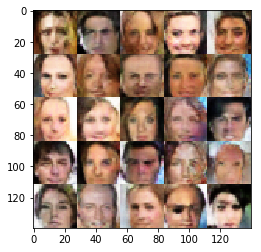

Epoch 8/10... Discriminator Loss: 1.1072... Generator Loss: 0.8887
Epoch 8/10... Discriminator Loss: 1.5927... Generator Loss: 0.5852
Epoch 8/10... Discriminator Loss: 6.1691... Generator Loss: 2.4478
Epoch 8/10... Discriminator Loss: 1.2511... Generator Loss: 0.8152
Epoch 8/10... Discriminator Loss: 1.3893... Generator Loss: 0.7586
Epoch 8/10... Discriminator Loss: 1.4101... Generator Loss: 0.7425
Epoch 8/10... Discriminator Loss: 1.3228... Generator Loss: 0.8156
Epoch 8/10... Discriminator Loss: 1.2723... Generator Loss: 0.7349
Epoch 8/10... Discriminator Loss: 1.2130... Generator Loss: 0.8384
Epoch 8/10... Discriminator Loss: 1.2048... Generator Loss: 0.8009


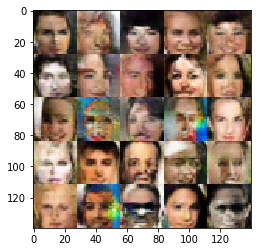

Epoch 8/10... Discriminator Loss: 1.2738... Generator Loss: 0.8148
Epoch 8/10... Discriminator Loss: 1.1544... Generator Loss: 1.0179
Epoch 8/10... Discriminator Loss: 1.0763... Generator Loss: 0.9756
Epoch 8/10... Discriminator Loss: 1.0987... Generator Loss: 0.9886
Epoch 8/10... Discriminator Loss: 1.1644... Generator Loss: 0.8302
Epoch 8/10... Discriminator Loss: 1.1948... Generator Loss: 0.8939
Epoch 8/10... Discriminator Loss: 1.4346... Generator Loss: 0.5813
Epoch 8/10... Discriminator Loss: 1.1727... Generator Loss: 0.9025
Epoch 8/10... Discriminator Loss: 1.2528... Generator Loss: 0.7399
Epoch 8/10... Discriminator Loss: 1.3621... Generator Loss: 0.7418


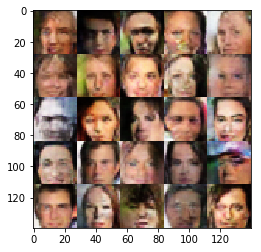

Epoch 8/10... Discriminator Loss: 1.2333... Generator Loss: 0.7778
Epoch 8/10... Discriminator Loss: 1.0634... Generator Loss: 0.9406
Epoch 8/10... Discriminator Loss: 1.1739... Generator Loss: 0.8486
Epoch 8/10... Discriminator Loss: 1.1448... Generator Loss: 0.8220
Epoch 8/10... Discriminator Loss: 1.2958... Generator Loss: 0.7386
Epoch 8/10... Discriminator Loss: 1.2040... Generator Loss: 0.9948
Epoch 8/10... Discriminator Loss: 1.1747... Generator Loss: 0.7933
Epoch 8/10... Discriminator Loss: 1.1436... Generator Loss: 0.9897
Epoch 8/10... Discriminator Loss: 1.4229... Generator Loss: 0.7638
Epoch 8/10... Discriminator Loss: 1.2282... Generator Loss: 0.7199


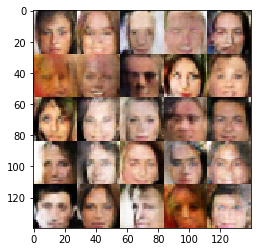

Epoch 8/10... Discriminator Loss: 1.4452... Generator Loss: 0.5775
Epoch 8/10... Discriminator Loss: 1.1183... Generator Loss: 1.0534
Epoch 8/10... Discriminator Loss: 1.0548... Generator Loss: 1.0868
Epoch 8/10... Discriminator Loss: 1.2352... Generator Loss: 0.8306
Epoch 8/10... Discriminator Loss: 1.2173... Generator Loss: 0.8390
Epoch 8/10... Discriminator Loss: 1.2412... Generator Loss: 0.7511
Epoch 8/10... Discriminator Loss: 1.2298... Generator Loss: 0.8983
Epoch 8/10... Discriminator Loss: 1.2190... Generator Loss: 0.7590
Epoch 8/10... Discriminator Loss: 1.1471... Generator Loss: 0.7909
Epoch 8/10... Discriminator Loss: 1.2181... Generator Loss: 0.7693


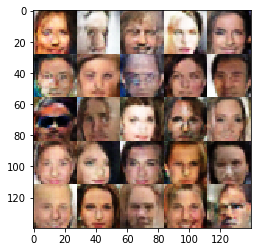

Epoch 8/10... Discriminator Loss: 1.1263... Generator Loss: 0.9662
Epoch 8/10... Discriminator Loss: 1.0802... Generator Loss: 1.0349
Epoch 8/10... Discriminator Loss: 1.2534... Generator Loss: 0.8769
Epoch 8/10... Discriminator Loss: 1.0494... Generator Loss: 0.9490
Epoch 8/10... Discriminator Loss: 1.2061... Generator Loss: 0.7822
Epoch 8/10... Discriminator Loss: 1.0924... Generator Loss: 0.9559
Epoch 8/10... Discriminator Loss: 1.1875... Generator Loss: 0.8032
Epoch 8/10... Discriminator Loss: 1.3081... Generator Loss: 0.7594
Epoch 8/10... Discriminator Loss: 1.1430... Generator Loss: 0.9061
Epoch 8/10... Discriminator Loss: 1.3703... Generator Loss: 0.6110


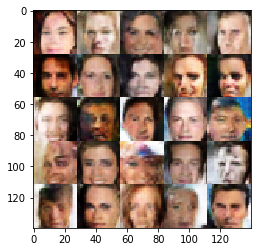

Epoch 8/10... Discriminator Loss: 1.2630... Generator Loss: 0.7592
Epoch 8/10... Discriminator Loss: 1.2532... Generator Loss: 0.7587
Epoch 8/10... Discriminator Loss: 1.1629... Generator Loss: 0.8948
Epoch 8/10... Discriminator Loss: 1.1256... Generator Loss: 0.8994
Epoch 8/10... Discriminator Loss: 1.2117... Generator Loss: 0.8453
Epoch 8/10... Discriminator Loss: 1.2091... Generator Loss: 0.7876
Epoch 8/10... Discriminator Loss: 1.1544... Generator Loss: 0.7646
Epoch 8/10... Discriminator Loss: 1.3902... Generator Loss: 0.6388
Epoch 8/10... Discriminator Loss: 1.1976... Generator Loss: 0.7824
Epoch 8/10... Discriminator Loss: 1.2475... Generator Loss: 0.8145


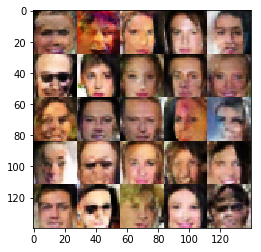

Epoch 8/10... Discriminator Loss: 1.2429... Generator Loss: 0.8595
Epoch 8/10... Discriminator Loss: 1.1743... Generator Loss: 0.9196
Epoch 8/10... Discriminator Loss: 1.2597... Generator Loss: 0.8719
Epoch 8/10... Discriminator Loss: 1.1320... Generator Loss: 0.8348
Epoch 8/10... Discriminator Loss: 1.2041... Generator Loss: 0.8444
Epoch 8/10... Discriminator Loss: 1.2190... Generator Loss: 0.8599
Epoch 8/10... Discriminator Loss: 1.0855... Generator Loss: 0.9103
Epoch 8/10... Discriminator Loss: 1.2981... Generator Loss: 0.7019
Epoch 8/10... Discriminator Loss: 1.0546... Generator Loss: 0.9024
Epoch 8/10... Discriminator Loss: 1.3991... Generator Loss: 0.6918


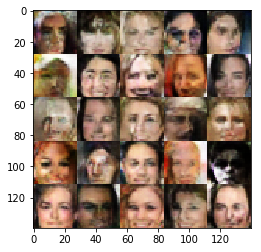

Epoch 8/10... Discriminator Loss: 1.0481... Generator Loss: 1.0928
Epoch 8/10... Discriminator Loss: 1.3598... Generator Loss: 0.9264
Epoch 8/10... Discriminator Loss: 1.2785... Generator Loss: 0.8391
Epoch 8/10... Discriminator Loss: 1.2058... Generator Loss: 0.8475
Epoch 8/10... Discriminator Loss: 1.3578... Generator Loss: 0.7550
Epoch 8/10... Discriminator Loss: 1.2576... Generator Loss: 0.8120
Epoch 8/10... Discriminator Loss: 1.1399... Generator Loss: 0.8282
Epoch 8/10... Discriminator Loss: 1.3788... Generator Loss: 0.5763
Epoch 8/10... Discriminator Loss: 1.1247... Generator Loss: 0.8735
Epoch 8/10... Discriminator Loss: 1.3707... Generator Loss: 0.6879


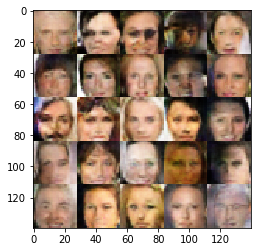

Epoch 8/10... Discriminator Loss: 1.1032... Generator Loss: 0.9577
Epoch 8/10... Discriminator Loss: 1.1675... Generator Loss: 0.9076
Epoch 8/10... Discriminator Loss: 1.4350... Generator Loss: 0.6579
Epoch 8/10... Discriminator Loss: 1.0616... Generator Loss: 0.8660
Epoch 8/10... Discriminator Loss: 1.2581... Generator Loss: 0.8781
Epoch 8/10... Discriminator Loss: 1.0301... Generator Loss: 1.0369
Epoch 8/10... Discriminator Loss: 1.0473... Generator Loss: 0.9675
Epoch 8/10... Discriminator Loss: 1.2920... Generator Loss: 0.7118
Epoch 8/10... Discriminator Loss: 1.1922... Generator Loss: 0.8302
Epoch 8/10... Discriminator Loss: 1.2134... Generator Loss: 0.8044


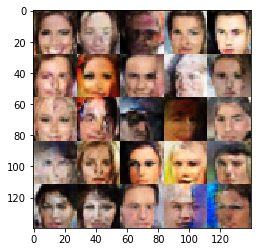

Epoch 8/10... Discriminator Loss: 1.2904... Generator Loss: 0.7491
Epoch 8/10... Discriminator Loss: 1.2537... Generator Loss: 0.7513
Epoch 8/10... Discriminator Loss: 1.2886... Generator Loss: 0.7476
Epoch 8/10... Discriminator Loss: 1.1642... Generator Loss: 0.9472
Epoch 8/10... Discriminator Loss: 1.1712... Generator Loss: 0.7837
Epoch 8/10... Discriminator Loss: 1.1771... Generator Loss: 0.9200
Epoch 8/10... Discriminator Loss: 1.2501... Generator Loss: 0.8234
Epoch 8/10... Discriminator Loss: 1.2728... Generator Loss: 0.8002
Epoch 8/10... Discriminator Loss: 1.2289... Generator Loss: 0.8512
Epoch 8/10... Discriminator Loss: 1.2191... Generator Loss: 0.8418


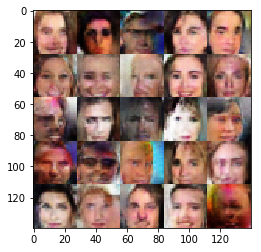

Epoch 8/10... Discriminator Loss: 1.2043... Generator Loss: 0.8687
Epoch 8/10... Discriminator Loss: 1.1466... Generator Loss: 0.8568
Epoch 8/10... Discriminator Loss: 1.4844... Generator Loss: 0.8149
Epoch 8/10... Discriminator Loss: 1.1549... Generator Loss: 0.9146
Epoch 8/10... Discriminator Loss: 1.1443... Generator Loss: 0.8569
Epoch 8/10... Discriminator Loss: 1.2760... Generator Loss: 0.8845
Epoch 8/10... Discriminator Loss: 1.1065... Generator Loss: 1.0545
Epoch 8/10... Discriminator Loss: 1.3260... Generator Loss: 0.8165
Epoch 8/10... Discriminator Loss: 1.2317... Generator Loss: 0.8233
Epoch 8/10... Discriminator Loss: 1.2055... Generator Loss: 0.9665


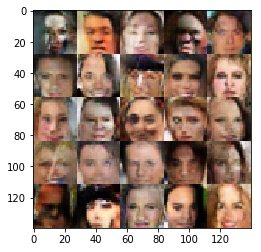

Epoch 8/10... Discriminator Loss: 1.1319... Generator Loss: 0.9576
Epoch 8/10... Discriminator Loss: 1.3169... Generator Loss: 0.7342
Epoch 8/10... Discriminator Loss: 1.1821... Generator Loss: 0.8587
Epoch 8/10... Discriminator Loss: 1.1876... Generator Loss: 0.8578
Epoch 8/10... Discriminator Loss: 1.1495... Generator Loss: 0.9847
Epoch 8/10... Discriminator Loss: 1.2826... Generator Loss: 0.7855
Epoch 8/10... Discriminator Loss: 1.2788... Generator Loss: 0.7371
Epoch 8/10... Discriminator Loss: 1.2743... Generator Loss: 0.8759
Epoch 8/10... Discriminator Loss: 1.2523... Generator Loss: 0.6854
Epoch 8/10... Discriminator Loss: 1.3013... Generator Loss: 0.7469


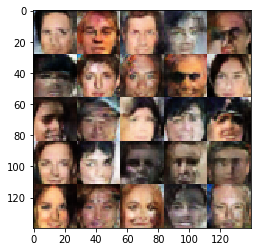

Epoch 8/10... Discriminator Loss: 1.1635... Generator Loss: 0.8356
Epoch 8/10... Discriminator Loss: 1.1196... Generator Loss: 0.8866
Epoch 8/10... Discriminator Loss: 1.0642... Generator Loss: 0.9746
Epoch 8/10... Discriminator Loss: 1.3037... Generator Loss: 0.6878
Epoch 8/10... Discriminator Loss: 1.2777... Generator Loss: 0.8133
Epoch 8/10... Discriminator Loss: 1.2411... Generator Loss: 0.8380
Epoch 8/10... Discriminator Loss: 1.3005... Generator Loss: 0.6691
Epoch 8/10... Discriminator Loss: 1.0570... Generator Loss: 0.9864
Epoch 8/10... Discriminator Loss: 1.2801... Generator Loss: 0.7332
Epoch 8/10... Discriminator Loss: 1.2054... Generator Loss: 0.8366


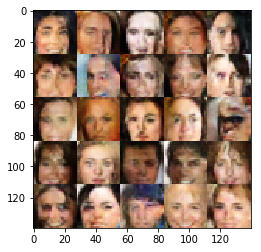

Epoch 8/10... Discriminator Loss: 1.1418... Generator Loss: 1.0275
Epoch 8/10... Discriminator Loss: 1.1717... Generator Loss: 0.8475
Epoch 8/10... Discriminator Loss: 1.1859... Generator Loss: 0.8073
Epoch 8/10... Discriminator Loss: 1.1743... Generator Loss: 0.9846
Epoch 8/10... Discriminator Loss: 1.1648... Generator Loss: 0.8395
Epoch 8/10... Discriminator Loss: 1.3164... Generator Loss: 0.7932
Epoch 8/10... Discriminator Loss: 1.2569... Generator Loss: 0.7869
Epoch 8/10... Discriminator Loss: 1.1538... Generator Loss: 0.9174
Epoch 8/10... Discriminator Loss: 1.2039... Generator Loss: 0.8158
Epoch 8/10... Discriminator Loss: 1.1669... Generator Loss: 0.7645


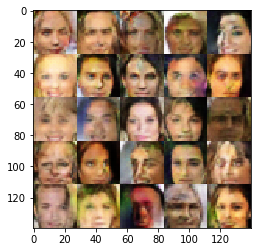

Epoch 8/10... Discriminator Loss: 1.1840... Generator Loss: 0.8365
Epoch 8/10... Discriminator Loss: 1.3576... Generator Loss: 0.8354
Epoch 8/10... Discriminator Loss: 1.2487... Generator Loss: 0.7615
Epoch 8/10... Discriminator Loss: 1.2040... Generator Loss: 0.7814
Epoch 8/10... Discriminator Loss: 1.2055... Generator Loss: 0.8217
Epoch 8/10... Discriminator Loss: 1.3028... Generator Loss: 0.6991
Epoch 8/10... Discriminator Loss: 1.2015... Generator Loss: 0.8388
Epoch 8/10... Discriminator Loss: 1.0063... Generator Loss: 1.0115
Epoch 8/10... Discriminator Loss: 1.2569... Generator Loss: 0.7656
Epoch 8/10... Discriminator Loss: 1.1692... Generator Loss: 0.8223


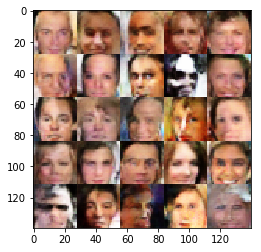

Epoch 8/10... Discriminator Loss: 1.1779... Generator Loss: 0.9178
Epoch 8/10... Discriminator Loss: 1.1931... Generator Loss: 0.8253
Epoch 8/10... Discriminator Loss: 1.1044... Generator Loss: 0.9024
Epoch 8/10... Discriminator Loss: 1.1508... Generator Loss: 1.0425
Epoch 8/10... Discriminator Loss: 1.1766... Generator Loss: 1.0204
Epoch 8/10... Discriminator Loss: 1.2390... Generator Loss: 0.8662
Epoch 8/10... Discriminator Loss: 1.1004... Generator Loss: 0.9156
Epoch 8/10... Discriminator Loss: 1.1216... Generator Loss: 1.0011
Epoch 8/10... Discriminator Loss: 1.0045... Generator Loss: 1.0507
Epoch 8/10... Discriminator Loss: 1.1428... Generator Loss: 0.8402


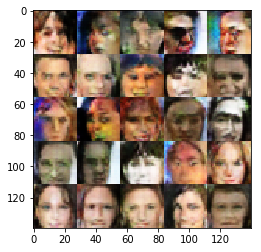

Epoch 8/10... Discriminator Loss: 1.3440... Generator Loss: 0.7043
Epoch 8/10... Discriminator Loss: 1.1426... Generator Loss: 0.9973
Epoch 8/10... Discriminator Loss: 1.4965... Generator Loss: 0.6544
Epoch 8/10... Discriminator Loss: 1.1560... Generator Loss: 0.8759
Epoch 8/10... Discriminator Loss: 1.1660... Generator Loss: 0.8973
Epoch 8/10... Discriminator Loss: 1.1550... Generator Loss: 1.0026
Epoch 8/10... Discriminator Loss: 1.1821... Generator Loss: 0.7189
Epoch 8/10... Discriminator Loss: 1.2197... Generator Loss: 0.7982
Epoch 8/10... Discriminator Loss: 1.2706... Generator Loss: 0.7517
Epoch 8/10... Discriminator Loss: 1.0988... Generator Loss: 0.9161


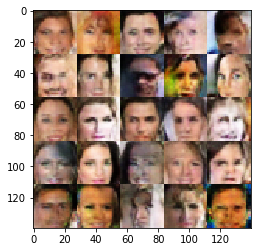

Epoch 8/10... Discriminator Loss: 1.1940... Generator Loss: 0.8160
Epoch 8/10... Discriminator Loss: 1.1174... Generator Loss: 0.9198
Epoch 8/10... Discriminator Loss: 1.1698... Generator Loss: 1.2573
Epoch 8/10... Discriminator Loss: 1.4084... Generator Loss: 0.6646
Epoch 8/10... Discriminator Loss: 1.4059... Generator Loss: 1.0161
Epoch 8/10... Discriminator Loss: 1.1554... Generator Loss: 0.9724
Epoch 8/10... Discriminator Loss: 1.2472... Generator Loss: 0.7501
Epoch 8/10... Discriminator Loss: 1.1063... Generator Loss: 0.9021
Epoch 8/10... Discriminator Loss: 1.2327... Generator Loss: 0.7969
Epoch 8/10... Discriminator Loss: 1.2251... Generator Loss: 0.8733


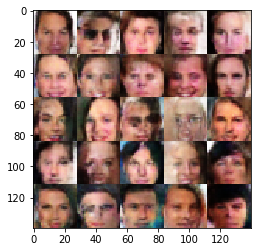

Epoch 8/10... Discriminator Loss: 1.1987... Generator Loss: 0.8238
Epoch 8/10... Discriminator Loss: 1.3470... Generator Loss: 0.7899
Epoch 8/10... Discriminator Loss: 1.3450... Generator Loss: 0.6842
Epoch 8/10... Discriminator Loss: 1.1143... Generator Loss: 0.8997
Epoch 8/10... Discriminator Loss: 1.3226... Generator Loss: 0.8004
Epoch 8/10... Discriminator Loss: 1.1947... Generator Loss: 0.8991
Epoch 8/10... Discriminator Loss: 1.3579... Generator Loss: 0.7519
Epoch 8/10... Discriminator Loss: 1.2518... Generator Loss: 0.7739
Epoch 8/10... Discriminator Loss: 1.1895... Generator Loss: 0.9008
Epoch 8/10... Discriminator Loss: 1.1669... Generator Loss: 1.0240


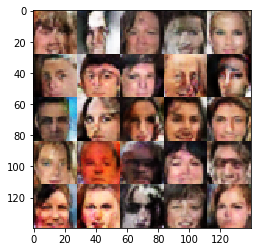

Epoch 8/10... Discriminator Loss: 1.3429... Generator Loss: 0.8648
Epoch 8/10... Discriminator Loss: 1.2390... Generator Loss: 0.7751
Epoch 8/10... Discriminator Loss: 1.3808... Generator Loss: 0.5975
Epoch 8/10... Discriminator Loss: 1.1617... Generator Loss: 0.8543
Epoch 8/10... Discriminator Loss: 1.2925... Generator Loss: 0.7191
Epoch 8/10... Discriminator Loss: 1.1943... Generator Loss: 0.8607
Epoch 8/10... Discriminator Loss: 1.5077... Generator Loss: 0.8360
Epoch 8/10... Discriminator Loss: 1.2508... Generator Loss: 0.8496
Epoch 8/10... Discriminator Loss: 1.1906... Generator Loss: 0.9016
Epoch 8/10... Discriminator Loss: 1.3194... Generator Loss: 0.7908


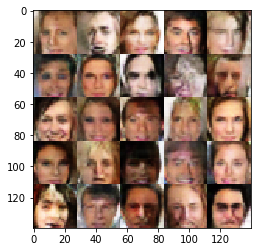

Epoch 8/10... Discriminator Loss: 1.2528... Generator Loss: 0.8091
Epoch 8/10... Discriminator Loss: 1.0692... Generator Loss: 0.9444
Epoch 8/10... Discriminator Loss: 1.1890... Generator Loss: 0.8043
Epoch 8/10... Discriminator Loss: 1.2192... Generator Loss: 0.8230
Epoch 8/10... Discriminator Loss: 1.1597... Generator Loss: 0.9474
Epoch 8/10... Discriminator Loss: 1.3063... Generator Loss: 0.7893
Epoch 8/10... Discriminator Loss: 1.1023... Generator Loss: 0.9093
Epoch 8/10... Discriminator Loss: 1.2770... Generator Loss: 0.8782
Epoch 8/10... Discriminator Loss: 1.2817... Generator Loss: 0.8851
Epoch 8/10... Discriminator Loss: 1.2555... Generator Loss: 0.7757


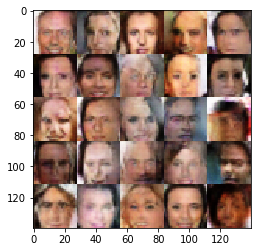

Epoch 8/10... Discriminator Loss: 1.2760... Generator Loss: 0.8671
Epoch 8/10... Discriminator Loss: 1.2011... Generator Loss: 0.9105
Epoch 8/10... Discriminator Loss: 1.2451... Generator Loss: 0.7270
Epoch 8/10... Discriminator Loss: 1.1252... Generator Loss: 0.8494
Epoch 8/10... Discriminator Loss: 1.1714... Generator Loss: 0.9442
Epoch 8/10... Discriminator Loss: 1.1315... Generator Loss: 0.9726
Epoch 8/10... Discriminator Loss: 1.2756... Generator Loss: 0.7300
Epoch 8/10... Discriminator Loss: 1.0007... Generator Loss: 1.0947
Epoch 8/10... Discriminator Loss: 1.1308... Generator Loss: 0.8209
Epoch 8/10... Discriminator Loss: 1.2099... Generator Loss: 0.7623


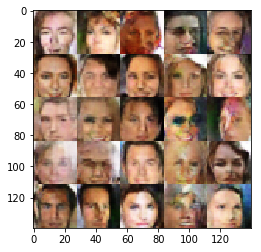

Epoch 8/10... Discriminator Loss: 1.3451... Generator Loss: 0.6539
Epoch 8/10... Discriminator Loss: 1.1620... Generator Loss: 0.8896
Epoch 8/10... Discriminator Loss: 1.2160... Generator Loss: 0.9200
Epoch 8/10... Discriminator Loss: 1.1466... Generator Loss: 0.8831
Epoch 8/10... Discriminator Loss: 1.2572... Generator Loss: 0.8287
Epoch 8/10... Discriminator Loss: 1.2200... Generator Loss: 0.7919
Epoch 8/10... Discriminator Loss: 1.3513... Generator Loss: 0.6871
Epoch 8/10... Discriminator Loss: 1.1819... Generator Loss: 0.8938
Epoch 8/10... Discriminator Loss: 1.6881... Generator Loss: 1.1487
Epoch 8/10... Discriminator Loss: 1.3065... Generator Loss: 0.7328


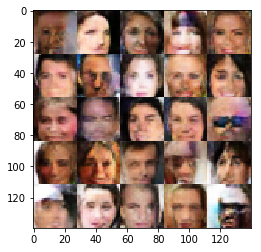

Epoch 8/10... Discriminator Loss: 1.2385... Generator Loss: 0.8323
Epoch 8/10... Discriminator Loss: 1.2828... Generator Loss: 0.7589
Epoch 8/10... Discriminator Loss: 1.2053... Generator Loss: 0.7975
Epoch 8/10... Discriminator Loss: 1.2516... Generator Loss: 0.7988
Epoch 8/10... Discriminator Loss: 1.2534... Generator Loss: 0.7926
Epoch 8/10... Discriminator Loss: 1.1886... Generator Loss: 0.8647
Epoch 8/10... Discriminator Loss: 1.0083... Generator Loss: 0.9951
Epoch 8/10... Discriminator Loss: 1.2966... Generator Loss: 0.7578
Epoch 8/10... Discriminator Loss: 1.1075... Generator Loss: 0.8737
Epoch 8/10... Discriminator Loss: 1.3376... Generator Loss: 0.6494


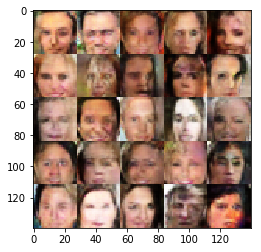

Epoch 8/10... Discriminator Loss: 1.1144... Generator Loss: 0.9094
Epoch 8/10... Discriminator Loss: 1.2633... Generator Loss: 0.7481
Epoch 8/10... Discriminator Loss: 1.1536... Generator Loss: 0.8521
Epoch 8/10... Discriminator Loss: 1.2405... Generator Loss: 0.7459
Epoch 8/10... Discriminator Loss: 1.0778... Generator Loss: 0.9651
Epoch 8/10... Discriminator Loss: 1.1582... Generator Loss: 0.8651
Epoch 8/10... Discriminator Loss: 1.3554... Generator Loss: 0.6876
Epoch 8/10... Discriminator Loss: 1.1879... Generator Loss: 0.9128
Epoch 8/10... Discriminator Loss: 0.9934... Generator Loss: 0.9928
Epoch 8/10... Discriminator Loss: 1.3042... Generator Loss: 0.6944


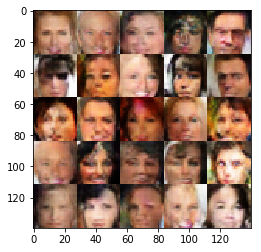

Epoch 8/10... Discriminator Loss: 1.1922... Generator Loss: 0.8086
Epoch 8/10... Discriminator Loss: 1.1493... Generator Loss: 1.0258
Epoch 9/10... Discriminator Loss: 1.4349... Generator Loss: 0.6126
Epoch 9/10... Discriminator Loss: 1.2526... Generator Loss: 0.9136
Epoch 9/10... Discriminator Loss: 1.1564... Generator Loss: 0.8376
Epoch 9/10... Discriminator Loss: 1.4956... Generator Loss: 0.8957
Epoch 9/10... Discriminator Loss: 2.5613... Generator Loss: 0.9832
Epoch 9/10... Discriminator Loss: 1.1302... Generator Loss: 0.9094
Epoch 9/10... Discriminator Loss: 1.2908... Generator Loss: 0.8265
Epoch 9/10... Discriminator Loss: 1.6345... Generator Loss: 0.6873


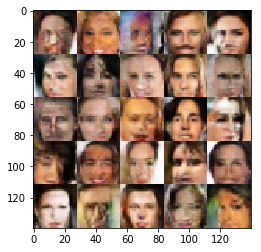

Epoch 9/10... Discriminator Loss: 1.1554... Generator Loss: 0.8475
Epoch 9/10... Discriminator Loss: 1.2254... Generator Loss: 0.8203
Epoch 9/10... Discriminator Loss: 1.3121... Generator Loss: 0.7759
Epoch 9/10... Discriminator Loss: 1.3725... Generator Loss: 0.6826
Epoch 9/10... Discriminator Loss: 1.2374... Generator Loss: 0.7983
Epoch 9/10... Discriminator Loss: 1.3037... Generator Loss: 0.7791
Epoch 9/10... Discriminator Loss: 1.2079... Generator Loss: 0.7913
Epoch 9/10... Discriminator Loss: 1.2770... Generator Loss: 0.8074
Epoch 9/10... Discriminator Loss: 1.1478... Generator Loss: 0.9632
Epoch 9/10... Discriminator Loss: 1.2740... Generator Loss: 0.7654


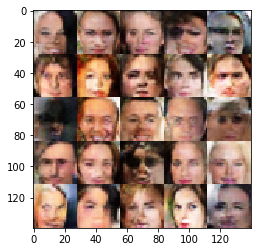

Epoch 9/10... Discriminator Loss: 1.0724... Generator Loss: 0.9049
Epoch 9/10... Discriminator Loss: 1.0746... Generator Loss: 0.8345
Epoch 9/10... Discriminator Loss: 1.2342... Generator Loss: 0.7657
Epoch 9/10... Discriminator Loss: 1.1106... Generator Loss: 0.8302
Epoch 9/10... Discriminator Loss: 1.1663... Generator Loss: 0.8233
Epoch 9/10... Discriminator Loss: 1.1569... Generator Loss: 1.1091
Epoch 9/10... Discriminator Loss: 1.1357... Generator Loss: 0.8756
Epoch 9/10... Discriminator Loss: 1.2630... Generator Loss: 0.7331
Epoch 9/10... Discriminator Loss: 1.1164... Generator Loss: 0.9184
Epoch 9/10... Discriminator Loss: 1.2751... Generator Loss: 0.7369


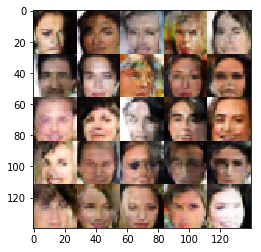

Epoch 9/10... Discriminator Loss: 1.2173... Generator Loss: 0.7994
Epoch 9/10... Discriminator Loss: 1.3641... Generator Loss: 0.7229
Epoch 9/10... Discriminator Loss: 1.2241... Generator Loss: 0.7632
Epoch 9/10... Discriminator Loss: 1.2974... Generator Loss: 0.7307
Epoch 9/10... Discriminator Loss: 1.1704... Generator Loss: 0.9214
Epoch 9/10... Discriminator Loss: 1.4238... Generator Loss: 0.7302
Epoch 9/10... Discriminator Loss: 1.2098... Generator Loss: 0.8544
Epoch 9/10... Discriminator Loss: 1.2104... Generator Loss: 0.9677
Epoch 9/10... Discriminator Loss: 1.1478... Generator Loss: 1.0355
Epoch 9/10... Discriminator Loss: 1.6133... Generator Loss: 0.5748


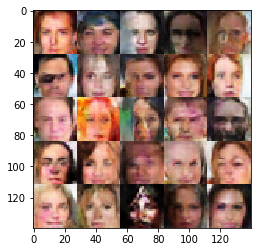

Epoch 9/10... Discriminator Loss: 1.3560... Generator Loss: 0.7122
Epoch 9/10... Discriminator Loss: 1.1776... Generator Loss: 0.8167
Epoch 9/10... Discriminator Loss: 1.3092... Generator Loss: 0.7505
Epoch 9/10... Discriminator Loss: 1.1059... Generator Loss: 0.9768
Epoch 9/10... Discriminator Loss: 1.2601... Generator Loss: 0.7295
Epoch 9/10... Discriminator Loss: 1.2525... Generator Loss: 0.7572
Epoch 9/10... Discriminator Loss: 1.2273... Generator Loss: 0.7905
Epoch 9/10... Discriminator Loss: 1.2256... Generator Loss: 0.7973
Epoch 9/10... Discriminator Loss: 1.3072... Generator Loss: 0.6932
Epoch 9/10... Discriminator Loss: 1.0220... Generator Loss: 0.9741


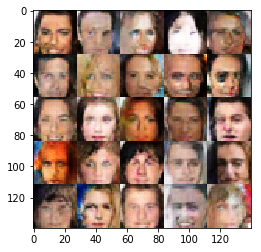

Epoch 9/10... Discriminator Loss: 1.2266... Generator Loss: 0.8751
Epoch 9/10... Discriminator Loss: 1.2444... Generator Loss: 0.7488
Epoch 9/10... Discriminator Loss: 1.2395... Generator Loss: 0.8181
Epoch 9/10... Discriminator Loss: 1.3329... Generator Loss: 0.6786
Epoch 9/10... Discriminator Loss: 1.2207... Generator Loss: 0.8950
Epoch 9/10... Discriminator Loss: 1.2437... Generator Loss: 0.7717
Epoch 9/10... Discriminator Loss: 1.1203... Generator Loss: 0.8871
Epoch 9/10... Discriminator Loss: 1.1884... Generator Loss: 0.8736
Epoch 9/10... Discriminator Loss: 1.2968... Generator Loss: 0.6583
Epoch 9/10... Discriminator Loss: 1.2054... Generator Loss: 0.8403


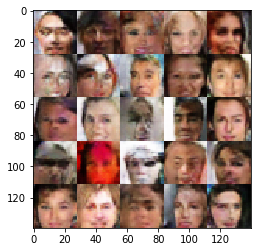

Epoch 9/10... Discriminator Loss: 1.1979... Generator Loss: 0.8694
Epoch 9/10... Discriminator Loss: 1.1090... Generator Loss: 0.8398
Epoch 9/10... Discriminator Loss: 1.1166... Generator Loss: 0.8857
Epoch 9/10... Discriminator Loss: 1.0644... Generator Loss: 1.2716
Epoch 9/10... Discriminator Loss: 1.2405... Generator Loss: 0.7730
Epoch 9/10... Discriminator Loss: 1.1402... Generator Loss: 0.8210
Epoch 9/10... Discriminator Loss: 1.2247... Generator Loss: 0.8370
Epoch 9/10... Discriminator Loss: 1.0681... Generator Loss: 0.9819
Epoch 9/10... Discriminator Loss: 1.1193... Generator Loss: 0.8413
Epoch 9/10... Discriminator Loss: 1.2538... Generator Loss: 0.9298


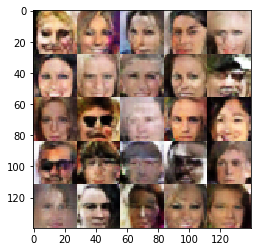

Epoch 9/10... Discriminator Loss: 1.4212... Generator Loss: 0.6956
Epoch 9/10... Discriminator Loss: 1.2697... Generator Loss: 0.7597
Epoch 9/10... Discriminator Loss: 1.3935... Generator Loss: 0.8654
Epoch 9/10... Discriminator Loss: 1.0933... Generator Loss: 1.0320
Epoch 9/10... Discriminator Loss: 1.3492... Generator Loss: 0.7788
Epoch 9/10... Discriminator Loss: 1.2433... Generator Loss: 0.7543
Epoch 9/10... Discriminator Loss: 1.1350... Generator Loss: 0.8700
Epoch 9/10... Discriminator Loss: 1.3505... Generator Loss: 0.6491
Epoch 9/10... Discriminator Loss: 1.1803... Generator Loss: 0.7507
Epoch 9/10... Discriminator Loss: 1.1867... Generator Loss: 0.7979


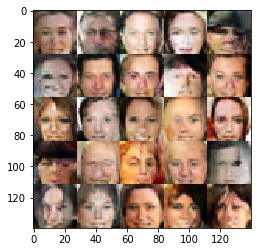

Epoch 9/10... Discriminator Loss: 1.2227... Generator Loss: 0.8242
Epoch 9/10... Discriminator Loss: 1.1661... Generator Loss: 0.9001
Epoch 9/10... Discriminator Loss: 1.0144... Generator Loss: 1.0268
Epoch 9/10... Discriminator Loss: 1.2935... Generator Loss: 0.7048
Epoch 9/10... Discriminator Loss: 1.2962... Generator Loss: 0.8338
Epoch 9/10... Discriminator Loss: 1.3039... Generator Loss: 0.8352
Epoch 9/10... Discriminator Loss: 1.1608... Generator Loss: 0.8573
Epoch 9/10... Discriminator Loss: 1.2212... Generator Loss: 0.8300
Epoch 9/10... Discriminator Loss: 1.2626... Generator Loss: 0.9436
Epoch 9/10... Discriminator Loss: 1.2815... Generator Loss: 0.7370


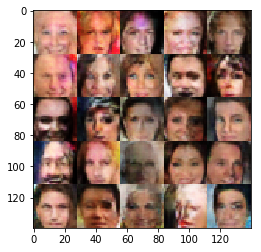

Epoch 9/10... Discriminator Loss: 1.4072... Generator Loss: 0.6471
Epoch 9/10... Discriminator Loss: 1.3370... Generator Loss: 0.8074
Epoch 9/10... Discriminator Loss: 1.3135... Generator Loss: 0.6723
Epoch 9/10... Discriminator Loss: 1.2532... Generator Loss: 0.7006
Epoch 9/10... Discriminator Loss: 1.0669... Generator Loss: 0.9435
Epoch 9/10... Discriminator Loss: 1.1795... Generator Loss: 0.8064
Epoch 9/10... Discriminator Loss: 1.1179... Generator Loss: 0.8926
Epoch 9/10... Discriminator Loss: 1.1659... Generator Loss: 0.8581
Epoch 9/10... Discriminator Loss: 1.2070... Generator Loss: 0.8182
Epoch 9/10... Discriminator Loss: 1.2259... Generator Loss: 0.7069


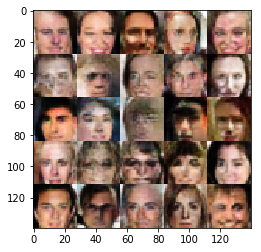

Epoch 9/10... Discriminator Loss: 1.3982... Generator Loss: 1.0161
Epoch 9/10... Discriminator Loss: 1.2883... Generator Loss: 0.7358
Epoch 9/10... Discriminator Loss: 1.2864... Generator Loss: 0.8880
Epoch 9/10... Discriminator Loss: 1.1993... Generator Loss: 0.8417
Epoch 9/10... Discriminator Loss: 1.3390... Generator Loss: 0.6533
Epoch 9/10... Discriminator Loss: 1.2379... Generator Loss: 0.8416
Epoch 9/10... Discriminator Loss: 1.1180... Generator Loss: 0.8531
Epoch 9/10... Discriminator Loss: 1.2197... Generator Loss: 0.8852
Epoch 9/10... Discriminator Loss: 1.2106... Generator Loss: 0.8525
Epoch 9/10... Discriminator Loss: 1.3362... Generator Loss: 0.6297


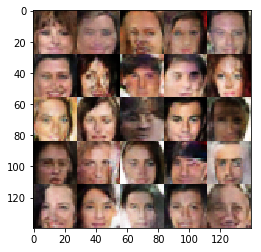

Epoch 9/10... Discriminator Loss: 1.2910... Generator Loss: 0.7673
Epoch 9/10... Discriminator Loss: 1.2453... Generator Loss: 0.9798
Epoch 9/10... Discriminator Loss: 1.3670... Generator Loss: 0.7107
Epoch 9/10... Discriminator Loss: 1.1831... Generator Loss: 0.8161
Epoch 9/10... Discriminator Loss: 1.2142... Generator Loss: 0.7397
Epoch 9/10... Discriminator Loss: 1.2470... Generator Loss: 0.7662
Epoch 9/10... Discriminator Loss: 1.2512... Generator Loss: 0.9819
Epoch 9/10... Discriminator Loss: 1.1710... Generator Loss: 0.9032
Epoch 9/10... Discriminator Loss: 1.2701... Generator Loss: 0.7098
Epoch 9/10... Discriminator Loss: 1.5313... Generator Loss: 0.8021


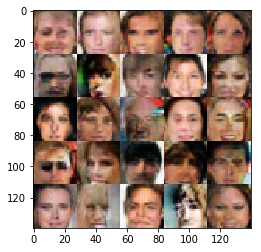

Epoch 9/10... Discriminator Loss: 1.0591... Generator Loss: 1.0163
Epoch 9/10... Discriminator Loss: 1.2381... Generator Loss: 0.8107
Epoch 9/10... Discriminator Loss: 1.2109... Generator Loss: 0.7995
Epoch 9/10... Discriminator Loss: 1.2885... Generator Loss: 0.8749
Epoch 9/10... Discriminator Loss: 1.1179... Generator Loss: 0.8037
Epoch 9/10... Discriminator Loss: 1.1312... Generator Loss: 0.8948
Epoch 9/10... Discriminator Loss: 1.3243... Generator Loss: 0.7576
Epoch 9/10... Discriminator Loss: 1.0402... Generator Loss: 1.0713
Epoch 9/10... Discriminator Loss: 1.2805... Generator Loss: 0.7962
Epoch 9/10... Discriminator Loss: 1.3727... Generator Loss: 0.5744


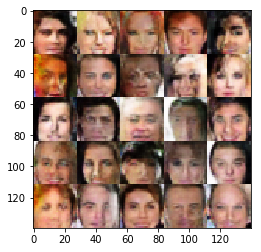

Epoch 9/10... Discriminator Loss: 0.8644... Generator Loss: 1.2657
Epoch 9/10... Discriminator Loss: 1.3541... Generator Loss: 0.7753
Epoch 9/10... Discriminator Loss: 1.1665... Generator Loss: 0.9324
Epoch 9/10... Discriminator Loss: 1.2010... Generator Loss: 0.7926
Epoch 9/10... Discriminator Loss: 1.1459... Generator Loss: 0.9167
Epoch 9/10... Discriminator Loss: 1.0941... Generator Loss: 0.9635
Epoch 9/10... Discriminator Loss: 1.2481... Generator Loss: 1.0098
Epoch 9/10... Discriminator Loss: 1.2611... Generator Loss: 0.7594
Epoch 9/10... Discriminator Loss: 1.2623... Generator Loss: 0.7341
Epoch 9/10... Discriminator Loss: 1.2924... Generator Loss: 0.8553


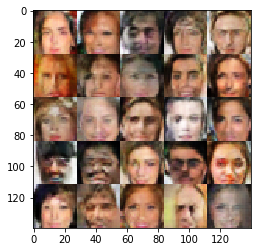

Epoch 9/10... Discriminator Loss: 1.2717... Generator Loss: 0.7810
Epoch 9/10... Discriminator Loss: 1.1341... Generator Loss: 1.0139
Epoch 9/10... Discriminator Loss: 1.3020... Generator Loss: 0.7074
Epoch 9/10... Discriminator Loss: 1.4033... Generator Loss: 0.6488
Epoch 9/10... Discriminator Loss: 1.0385... Generator Loss: 1.0897
Epoch 9/10... Discriminator Loss: 1.1692... Generator Loss: 0.8691
Epoch 9/10... Discriminator Loss: 1.2414... Generator Loss: 0.7756
Epoch 9/10... Discriminator Loss: 1.2371... Generator Loss: 0.6676
Epoch 9/10... Discriminator Loss: 1.1429... Generator Loss: 0.7991
Epoch 9/10... Discriminator Loss: 1.3270... Generator Loss: 0.6397


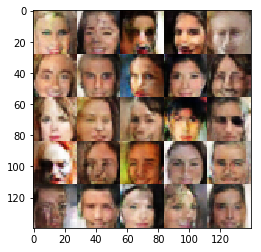

Epoch 9/10... Discriminator Loss: 1.2288... Generator Loss: 0.7258
Epoch 9/10... Discriminator Loss: 1.2260... Generator Loss: 0.7370
Epoch 9/10... Discriminator Loss: 1.1329... Generator Loss: 0.9362
Epoch 9/10... Discriminator Loss: 1.1473... Generator Loss: 1.0458
Epoch 9/10... Discriminator Loss: 1.2336... Generator Loss: 0.7450
Epoch 9/10... Discriminator Loss: 1.2487... Generator Loss: 0.7577
Epoch 9/10... Discriminator Loss: 1.3844... Generator Loss: 0.7193
Epoch 9/10... Discriminator Loss: 1.2159... Generator Loss: 0.7377
Epoch 9/10... Discriminator Loss: 1.1013... Generator Loss: 0.9254
Epoch 9/10... Discriminator Loss: 1.2504... Generator Loss: 0.8397


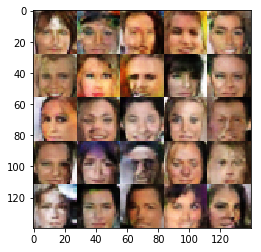

Epoch 9/10... Discriminator Loss: 1.3092... Generator Loss: 0.8079
Epoch 9/10... Discriminator Loss: 1.2307... Generator Loss: 0.8536
Epoch 9/10... Discriminator Loss: 1.2723... Generator Loss: 0.6548
Epoch 9/10... Discriminator Loss: 1.2533... Generator Loss: 0.7933
Epoch 9/10... Discriminator Loss: 1.3035... Generator Loss: 0.6666
Epoch 9/10... Discriminator Loss: 1.2432... Generator Loss: 0.9026
Epoch 9/10... Discriminator Loss: 1.3530... Generator Loss: 0.8575
Epoch 9/10... Discriminator Loss: 1.2000... Generator Loss: 1.0133
Epoch 9/10... Discriminator Loss: 1.1793... Generator Loss: 0.9759
Epoch 9/10... Discriminator Loss: 1.1660... Generator Loss: 0.9048


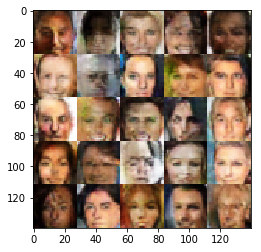

Epoch 9/10... Discriminator Loss: 1.1160... Generator Loss: 0.9082
Epoch 9/10... Discriminator Loss: 1.1556... Generator Loss: 0.8233
Epoch 9/10... Discriminator Loss: 1.0731... Generator Loss: 0.8941
Epoch 9/10... Discriminator Loss: 1.1132... Generator Loss: 0.9415
Epoch 9/10... Discriminator Loss: 1.1220... Generator Loss: 0.8476
Epoch 9/10... Discriminator Loss: 1.2018... Generator Loss: 0.7444
Epoch 9/10... Discriminator Loss: 1.2379... Generator Loss: 0.8558
Epoch 9/10... Discriminator Loss: 1.1212... Generator Loss: 0.8044
Epoch 9/10... Discriminator Loss: 1.2710... Generator Loss: 0.7755
Epoch 9/10... Discriminator Loss: 1.3963... Generator Loss: 0.7588


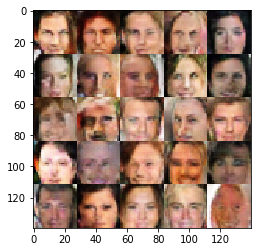

Epoch 9/10... Discriminator Loss: 2.3509... Generator Loss: 1.2555
Epoch 9/10... Discriminator Loss: 1.4904... Generator Loss: 0.7391
Epoch 9/10... Discriminator Loss: 1.1727... Generator Loss: 0.9095
Epoch 9/10... Discriminator Loss: 1.3527... Generator Loss: 0.8426
Epoch 9/10... Discriminator Loss: 1.2921... Generator Loss: 0.7721
Epoch 9/10... Discriminator Loss: 1.3539... Generator Loss: 0.7527
Epoch 9/10... Discriminator Loss: 1.1788... Generator Loss: 0.8226
Epoch 9/10... Discriminator Loss: 1.1943... Generator Loss: 0.8325
Epoch 9/10... Discriminator Loss: 1.2424... Generator Loss: 0.7405
Epoch 9/10... Discriminator Loss: 1.2623... Generator Loss: 0.8737


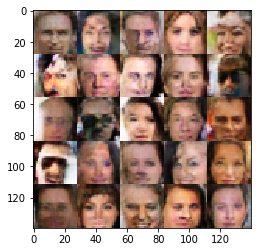

Epoch 9/10... Discriminator Loss: 1.2025... Generator Loss: 0.9509
Epoch 9/10... Discriminator Loss: 1.2872... Generator Loss: 0.7908
Epoch 9/10... Discriminator Loss: 1.2367... Generator Loss: 0.8260
Epoch 9/10... Discriminator Loss: 1.2400... Generator Loss: 0.8213
Epoch 9/10... Discriminator Loss: 1.1035... Generator Loss: 0.9365
Epoch 9/10... Discriminator Loss: 1.2731... Generator Loss: 0.8276
Epoch 9/10... Discriminator Loss: 1.2032... Generator Loss: 0.8314
Epoch 9/10... Discriminator Loss: 1.2470... Generator Loss: 0.8596
Epoch 9/10... Discriminator Loss: 1.2352... Generator Loss: 0.7720
Epoch 9/10... Discriminator Loss: 1.0953... Generator Loss: 0.8968


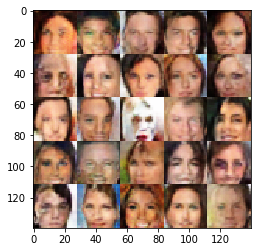

Epoch 9/10... Discriminator Loss: 1.2717... Generator Loss: 0.7563
Epoch 9/10... Discriminator Loss: 1.2443... Generator Loss: 0.7809
Epoch 9/10... Discriminator Loss: 1.2361... Generator Loss: 0.7971
Epoch 9/10... Discriminator Loss: 1.2823... Generator Loss: 0.7838
Epoch 9/10... Discriminator Loss: 1.0971... Generator Loss: 0.9213
Epoch 9/10... Discriminator Loss: 1.3821... Generator Loss: 0.6895
Epoch 9/10... Discriminator Loss: 1.2229... Generator Loss: 0.7229
Epoch 9/10... Discriminator Loss: 1.2544... Generator Loss: 0.8183
Epoch 9/10... Discriminator Loss: 1.2250... Generator Loss: 0.8664
Epoch 9/10... Discriminator Loss: 1.2283... Generator Loss: 0.7480


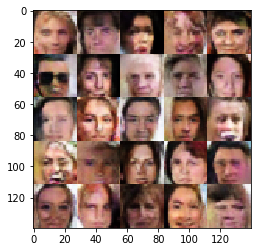

Epoch 9/10... Discriminator Loss: 1.3389... Generator Loss: 0.6256
Epoch 9/10... Discriminator Loss: 1.1440... Generator Loss: 1.0448
Epoch 9/10... Discriminator Loss: 1.1122... Generator Loss: 0.8277
Epoch 9/10... Discriminator Loss: 1.2906... Generator Loss: 0.7511
Epoch 9/10... Discriminator Loss: 1.1504... Generator Loss: 0.9409
Epoch 9/10... Discriminator Loss: 1.2075... Generator Loss: 0.9118
Epoch 9/10... Discriminator Loss: 1.1083... Generator Loss: 0.9889
Epoch 9/10... Discriminator Loss: 1.2002... Generator Loss: 0.9353
Epoch 9/10... Discriminator Loss: 1.1954... Generator Loss: 0.8214
Epoch 9/10... Discriminator Loss: 1.2779... Generator Loss: 0.7726


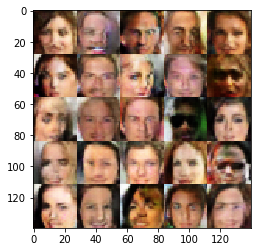

Epoch 9/10... Discriminator Loss: 1.0989... Generator Loss: 0.9893
Epoch 9/10... Discriminator Loss: 1.2481... Generator Loss: 0.8665
Epoch 9/10... Discriminator Loss: 1.2966... Generator Loss: 0.7384
Epoch 9/10... Discriminator Loss: 1.2634... Generator Loss: 0.7792
Epoch 9/10... Discriminator Loss: 1.2766... Generator Loss: 0.6617
Epoch 9/10... Discriminator Loss: 1.2317... Generator Loss: 0.8859
Epoch 9/10... Discriminator Loss: 1.2132... Generator Loss: 0.8130
Epoch 9/10... Discriminator Loss: 1.1749... Generator Loss: 0.8700
Epoch 9/10... Discriminator Loss: 1.2979... Generator Loss: 0.6636
Epoch 9/10... Discriminator Loss: 1.2887... Generator Loss: 0.9039


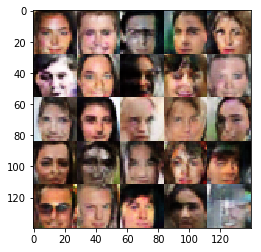

Epoch 9/10... Discriminator Loss: 1.1973... Generator Loss: 0.7209
Epoch 9/10... Discriminator Loss: 1.1061... Generator Loss: 0.9117
Epoch 9/10... Discriminator Loss: 1.2833... Generator Loss: 1.0657
Epoch 9/10... Discriminator Loss: 1.1257... Generator Loss: 0.9201
Epoch 9/10... Discriminator Loss: 1.0431... Generator Loss: 1.1233
Epoch 9/10... Discriminator Loss: 1.2061... Generator Loss: 0.7708
Epoch 9/10... Discriminator Loss: 1.1541... Generator Loss: 0.8443
Epoch 9/10... Discriminator Loss: 1.2768... Generator Loss: 0.8465
Epoch 9/10... Discriminator Loss: 1.1794... Generator Loss: 0.8129
Epoch 9/10... Discriminator Loss: 1.2868... Generator Loss: 0.7933


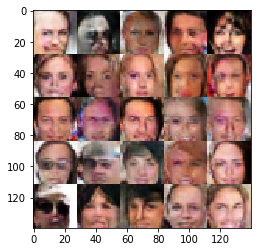

Epoch 9/10... Discriminator Loss: 1.0647... Generator Loss: 0.9148
Epoch 9/10... Discriminator Loss: 1.2848... Generator Loss: 0.8449
Epoch 9/10... Discriminator Loss: 1.1710... Generator Loss: 0.8726
Epoch 9/10... Discriminator Loss: 1.0830... Generator Loss: 1.0221
Epoch 9/10... Discriminator Loss: 1.2818... Generator Loss: 1.1870
Epoch 9/10... Discriminator Loss: 1.0684... Generator Loss: 0.9079
Epoch 9/10... Discriminator Loss: 1.3457... Generator Loss: 0.7002
Epoch 9/10... Discriminator Loss: 1.3948... Generator Loss: 0.7776
Epoch 9/10... Discriminator Loss: 1.1795... Generator Loss: 0.8670
Epoch 9/10... Discriminator Loss: 1.2283... Generator Loss: 0.7703


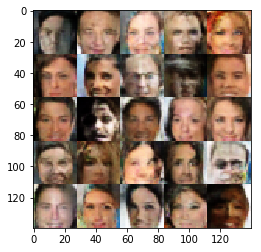

Epoch 9/10... Discriminator Loss: 1.2419... Generator Loss: 1.0211
Epoch 9/10... Discriminator Loss: 1.1135... Generator Loss: 0.8877
Epoch 9/10... Discriminator Loss: 1.2117... Generator Loss: 1.0439
Epoch 9/10... Discriminator Loss: 1.1683... Generator Loss: 0.8636
Epoch 9/10... Discriminator Loss: 1.2599... Generator Loss: 1.1122
Epoch 9/10... Discriminator Loss: 1.1164... Generator Loss: 0.8767
Epoch 9/10... Discriminator Loss: 1.3011... Generator Loss: 0.8047
Epoch 9/10... Discriminator Loss: 1.2922... Generator Loss: 0.8972
Epoch 9/10... Discriminator Loss: 1.3140... Generator Loss: 0.8462
Epoch 9/10... Discriminator Loss: 1.0924... Generator Loss: 1.0821


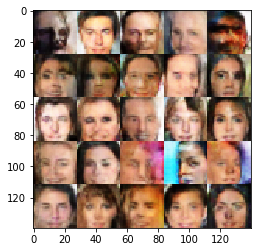

Epoch 9/10... Discriminator Loss: 1.3408... Generator Loss: 0.6751
Epoch 9/10... Discriminator Loss: 1.3324... Generator Loss: 0.6818
Epoch 9/10... Discriminator Loss: 1.4193... Generator Loss: 0.6655
Epoch 9/10... Discriminator Loss: 1.2569... Generator Loss: 0.8438
Epoch 9/10... Discriminator Loss: 1.1251... Generator Loss: 0.9270
Epoch 9/10... Discriminator Loss: 1.3667... Generator Loss: 0.7569
Epoch 9/10... Discriminator Loss: 1.4207... Generator Loss: 0.6466
Epoch 9/10... Discriminator Loss: 1.2486... Generator Loss: 0.8259
Epoch 9/10... Discriminator Loss: 1.2890... Generator Loss: 0.7156
Epoch 9/10... Discriminator Loss: 1.2620... Generator Loss: 0.9077


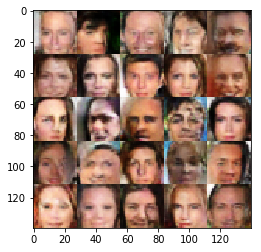

Epoch 9/10... Discriminator Loss: 1.3327... Generator Loss: 0.6262
Epoch 9/10... Discriminator Loss: 1.1960... Generator Loss: 0.7945
Epoch 9/10... Discriminator Loss: 1.2358... Generator Loss: 0.8140
Epoch 9/10... Discriminator Loss: 1.1111... Generator Loss: 0.8951
Epoch 9/10... Discriminator Loss: 1.2811... Generator Loss: 0.7255
Epoch 9/10... Discriminator Loss: 1.3278... Generator Loss: 0.7164
Epoch 9/10... Discriminator Loss: 1.3444... Generator Loss: 0.7526
Epoch 9/10... Discriminator Loss: 1.2695... Generator Loss: 0.7418
Epoch 9/10... Discriminator Loss: 1.2539... Generator Loss: 0.8901
Epoch 9/10... Discriminator Loss: 1.1832... Generator Loss: 0.9072


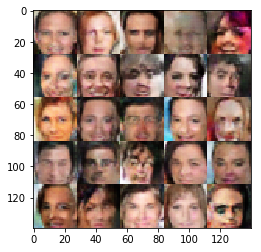

Epoch 9/10... Discriminator Loss: 1.2637... Generator Loss: 0.7037
Epoch 9/10... Discriminator Loss: 1.3511... Generator Loss: 0.6635
Epoch 9/10... Discriminator Loss: 1.2609... Generator Loss: 0.6911
Epoch 9/10... Discriminator Loss: 1.0820... Generator Loss: 0.9461
Epoch 9/10... Discriminator Loss: 1.0559... Generator Loss: 1.0836
Epoch 9/10... Discriminator Loss: 1.1740... Generator Loss: 0.8156
Epoch 9/10... Discriminator Loss: 1.3047... Generator Loss: 0.7784
Epoch 9/10... Discriminator Loss: 1.2185... Generator Loss: 0.9107
Epoch 9/10... Discriminator Loss: 1.1581... Generator Loss: 0.7806
Epoch 9/10... Discriminator Loss: 1.1331... Generator Loss: 1.0153


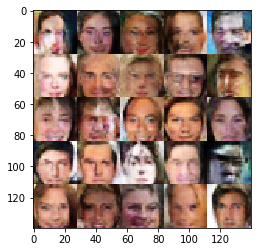

Epoch 9/10... Discriminator Loss: 1.2725... Generator Loss: 0.7683
Epoch 9/10... Discriminator Loss: 1.2802... Generator Loss: 0.7232
Epoch 9/10... Discriminator Loss: 1.2092... Generator Loss: 0.7716
Epoch 9/10... Discriminator Loss: 1.0577... Generator Loss: 0.9500
Epoch 9/10... Discriminator Loss: 1.2760... Generator Loss: 0.7319
Epoch 9/10... Discriminator Loss: 1.2528... Generator Loss: 0.7909
Epoch 9/10... Discriminator Loss: 1.1265... Generator Loss: 0.9546
Epoch 9/10... Discriminator Loss: 1.1549... Generator Loss: 0.9352
Epoch 9/10... Discriminator Loss: 1.3370... Generator Loss: 0.6631
Epoch 9/10... Discriminator Loss: 1.3017... Generator Loss: 0.7313


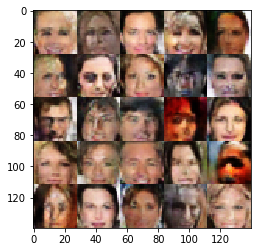

Epoch 9/10... Discriminator Loss: 1.1637... Generator Loss: 0.7977
Epoch 9/10... Discriminator Loss: 1.7262... Generator Loss: 0.4852
Epoch 9/10... Discriminator Loss: 1.2731... Generator Loss: 0.8162
Epoch 9/10... Discriminator Loss: 1.3616... Generator Loss: 0.6994
Epoch 9/10... Discriminator Loss: 1.2183... Generator Loss: 0.9413
Epoch 9/10... Discriminator Loss: 1.2540... Generator Loss: 0.7571
Epoch 9/10... Discriminator Loss: 1.1578... Generator Loss: 0.8066
Epoch 9/10... Discriminator Loss: 1.1712... Generator Loss: 0.8193
Epoch 9/10... Discriminator Loss: 1.1581... Generator Loss: 0.9941
Epoch 9/10... Discriminator Loss: 1.2532... Generator Loss: 0.7818


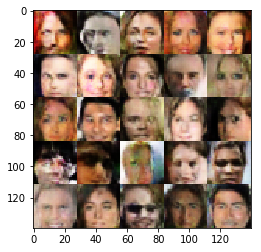

Epoch 9/10... Discriminator Loss: 1.2688... Generator Loss: 0.7483
Epoch 9/10... Discriminator Loss: 1.2605... Generator Loss: 0.7576
Epoch 9/10... Discriminator Loss: 1.2631... Generator Loss: 0.8367
Epoch 9/10... Discriminator Loss: 1.1943... Generator Loss: 0.7081
Epoch 9/10... Discriminator Loss: 1.2136... Generator Loss: 0.7692
Epoch 9/10... Discriminator Loss: 1.3413... Generator Loss: 0.7420
Epoch 9/10... Discriminator Loss: 1.2862... Generator Loss: 0.8529
Epoch 9/10... Discriminator Loss: 1.0317... Generator Loss: 0.9689
Epoch 10/10... Discriminator Loss: 1.3513... Generator Loss: 0.6224
Epoch 10/10... Discriminator Loss: 1.5828... Generator Loss: 0.8848


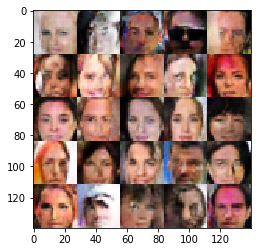

Epoch 10/10... Discriminator Loss: 1.5397... Generator Loss: 0.5313
Epoch 10/10... Discriminator Loss: 1.3294... Generator Loss: 0.8299
Epoch 10/10... Discriminator Loss: 1.1902... Generator Loss: 0.8140
Epoch 10/10... Discriminator Loss: 1.1319... Generator Loss: 0.9095
Epoch 10/10... Discriminator Loss: 1.2991... Generator Loss: 0.6898
Epoch 10/10... Discriminator Loss: 1.3055... Generator Loss: 0.8385
Epoch 10/10... Discriminator Loss: 1.2688... Generator Loss: 0.8712
Epoch 10/10... Discriminator Loss: 1.2492... Generator Loss: 0.7023
Epoch 10/10... Discriminator Loss: 1.2711... Generator Loss: 0.7485
Epoch 10/10... Discriminator Loss: 1.2467... Generator Loss: 0.7222


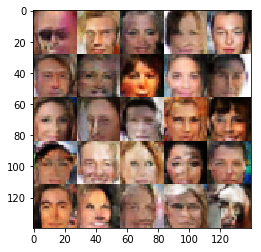

Epoch 10/10... Discriminator Loss: 1.0603... Generator Loss: 1.1286
Epoch 10/10... Discriminator Loss: 1.2711... Generator Loss: 0.7474
Epoch 10/10... Discriminator Loss: 1.0458... Generator Loss: 0.9537
Epoch 10/10... Discriminator Loss: 1.2814... Generator Loss: 0.7718
Epoch 10/10... Discriminator Loss: 1.1817... Generator Loss: 0.8097
Epoch 10/10... Discriminator Loss: 1.5446... Generator Loss: 0.7027
Epoch 10/10... Discriminator Loss: 1.0508... Generator Loss: 0.9443
Epoch 10/10... Discriminator Loss: 1.1183... Generator Loss: 0.8953
Epoch 10/10... Discriminator Loss: 1.1871... Generator Loss: 0.8352
Epoch 10/10... Discriminator Loss: 1.0361... Generator Loss: 0.9682


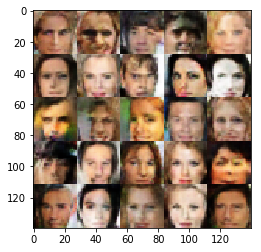

Epoch 10/10... Discriminator Loss: 1.1517... Generator Loss: 0.9429
Epoch 10/10... Discriminator Loss: 1.1811... Generator Loss: 0.7620
Epoch 10/10... Discriminator Loss: 1.4952... Generator Loss: 0.6210
Epoch 10/10... Discriminator Loss: 1.2050... Generator Loss: 0.7582
Epoch 10/10... Discriminator Loss: 1.2472... Generator Loss: 0.8626
Epoch 10/10... Discriminator Loss: 1.3202... Generator Loss: 0.9008
Epoch 10/10... Discriminator Loss: 1.2055... Generator Loss: 0.8319
Epoch 10/10... Discriminator Loss: 1.0903... Generator Loss: 0.9709
Epoch 10/10... Discriminator Loss: 1.2849... Generator Loss: 0.8189
Epoch 10/10... Discriminator Loss: 1.3713... Generator Loss: 0.8503


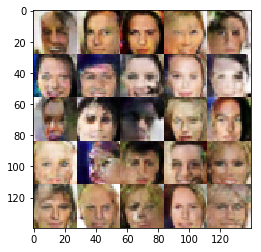

Epoch 10/10... Discriminator Loss: 1.2282... Generator Loss: 0.7502
Epoch 10/10... Discriminator Loss: 1.1944... Generator Loss: 0.8247
Epoch 10/10... Discriminator Loss: 1.2991... Generator Loss: 0.8009
Epoch 10/10... Discriminator Loss: 1.2819... Generator Loss: 0.8372
Epoch 10/10... Discriminator Loss: 1.2917... Generator Loss: 0.6688
Epoch 10/10... Discriminator Loss: 1.1420... Generator Loss: 0.8676
Epoch 10/10... Discriminator Loss: 1.2297... Generator Loss: 0.7819
Epoch 10/10... Discriminator Loss: 1.1957... Generator Loss: 0.9548
Epoch 10/10... Discriminator Loss: 1.3336... Generator Loss: 0.6250
Epoch 10/10... Discriminator Loss: 1.1021... Generator Loss: 0.9132


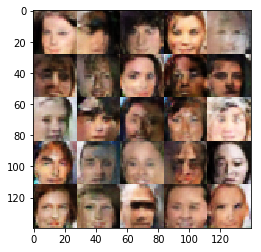

Epoch 10/10... Discriminator Loss: 1.1166... Generator Loss: 0.8268
Epoch 10/10... Discriminator Loss: 1.2005... Generator Loss: 0.8264
Epoch 10/10... Discriminator Loss: 1.0638... Generator Loss: 0.9641
Epoch 10/10... Discriminator Loss: 1.2674... Generator Loss: 0.7488
Epoch 10/10... Discriminator Loss: 1.2411... Generator Loss: 0.6812
Epoch 10/10... Discriminator Loss: 1.3125... Generator Loss: 0.7633
Epoch 10/10... Discriminator Loss: 1.1779... Generator Loss: 0.8056
Epoch 10/10... Discriminator Loss: 1.2572... Generator Loss: 0.7106
Epoch 10/10... Discriminator Loss: 1.2626... Generator Loss: 0.7036
Epoch 10/10... Discriminator Loss: 1.2476... Generator Loss: 0.7818


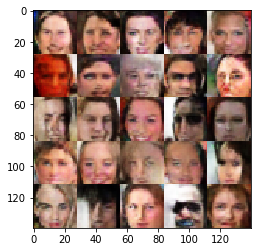

Epoch 10/10... Discriminator Loss: 1.1616... Generator Loss: 0.8735
Epoch 10/10... Discriminator Loss: 1.2400... Generator Loss: 0.8702
Epoch 10/10... Discriminator Loss: 1.3513... Generator Loss: 0.6904
Epoch 10/10... Discriminator Loss: 1.3659... Generator Loss: 0.6722
Epoch 10/10... Discriminator Loss: 0.9826... Generator Loss: 1.0161
Epoch 10/10... Discriminator Loss: 1.2915... Generator Loss: 0.7609
Epoch 10/10... Discriminator Loss: 1.3209... Generator Loss: 0.7920
Epoch 10/10... Discriminator Loss: 1.2622... Generator Loss: 0.7998
Epoch 10/10... Discriminator Loss: 1.1810... Generator Loss: 1.0003
Epoch 10/10... Discriminator Loss: 1.2062... Generator Loss: 0.8565


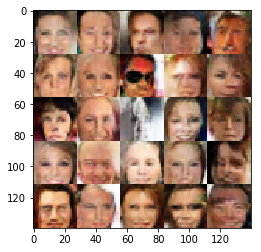

Epoch 10/10... Discriminator Loss: 1.3803... Generator Loss: 0.8009
Epoch 10/10... Discriminator Loss: 1.2254... Generator Loss: 0.8348
Epoch 10/10... Discriminator Loss: 1.1435... Generator Loss: 0.7423
Epoch 10/10... Discriminator Loss: 1.1223... Generator Loss: 0.9128
Epoch 10/10... Discriminator Loss: 1.2742... Generator Loss: 0.9439
Epoch 10/10... Discriminator Loss: 1.4578... Generator Loss: 1.0069
Epoch 10/10... Discriminator Loss: 1.3211... Generator Loss: 1.0359
Epoch 10/10... Discriminator Loss: 1.5652... Generator Loss: 0.6955
Epoch 10/10... Discriminator Loss: 1.2956... Generator Loss: 0.7017
Epoch 10/10... Discriminator Loss: 1.2045... Generator Loss: 1.0949


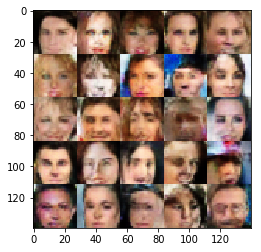

Epoch 10/10... Discriminator Loss: 1.2910... Generator Loss: 0.7493
Epoch 10/10... Discriminator Loss: 1.1393... Generator Loss: 0.8990
Epoch 10/10... Discriminator Loss: 1.1785... Generator Loss: 0.7534
Epoch 10/10... Discriminator Loss: 1.0994... Generator Loss: 1.0305
Epoch 10/10... Discriminator Loss: 1.2793... Generator Loss: 0.8355
Epoch 10/10... Discriminator Loss: 1.1754... Generator Loss: 0.8626
Epoch 10/10... Discriminator Loss: 1.0077... Generator Loss: 1.0647
Epoch 10/10... Discriminator Loss: 1.2477... Generator Loss: 0.8165
Epoch 10/10... Discriminator Loss: 1.1493... Generator Loss: 0.9076
Epoch 10/10... Discriminator Loss: 1.2833... Generator Loss: 0.7504


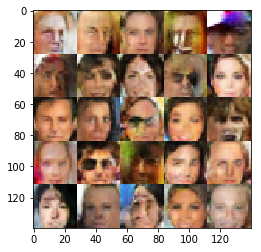

Epoch 10/10... Discriminator Loss: 1.2506... Generator Loss: 0.7479
Epoch 10/10... Discriminator Loss: 1.0927... Generator Loss: 0.8495
Epoch 10/10... Discriminator Loss: 1.1682... Generator Loss: 0.9602
Epoch 10/10... Discriminator Loss: 1.2019... Generator Loss: 0.8082
Epoch 10/10... Discriminator Loss: 1.1507... Generator Loss: 0.9226
Epoch 10/10... Discriminator Loss: 1.1210... Generator Loss: 0.9795
Epoch 10/10... Discriminator Loss: 1.1876... Generator Loss: 0.7468
Epoch 10/10... Discriminator Loss: 1.3325... Generator Loss: 0.7380
Epoch 10/10... Discriminator Loss: 1.1316... Generator Loss: 0.8230
Epoch 10/10... Discriminator Loss: 0.9834... Generator Loss: 1.1798


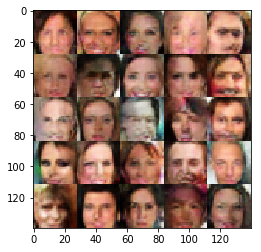

Epoch 10/10... Discriminator Loss: 1.1690... Generator Loss: 0.9541
Epoch 10/10... Discriminator Loss: 1.1751... Generator Loss: 0.8051
Epoch 10/10... Discriminator Loss: 1.1950... Generator Loss: 1.0375
Epoch 10/10... Discriminator Loss: 1.2256... Generator Loss: 0.7559
Epoch 10/10... Discriminator Loss: 1.1185... Generator Loss: 0.9286
Epoch 10/10... Discriminator Loss: 1.1146... Generator Loss: 0.8746
Epoch 10/10... Discriminator Loss: 1.3511... Generator Loss: 0.7795
Epoch 10/10... Discriminator Loss: 1.3199... Generator Loss: 0.7097
Epoch 10/10... Discriminator Loss: 1.2457... Generator Loss: 0.8081
Epoch 10/10... Discriminator Loss: 1.1689... Generator Loss: 0.9013


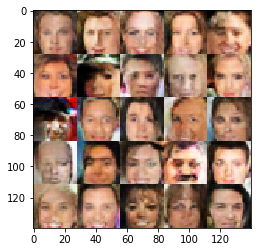

Epoch 10/10... Discriminator Loss: 1.2929... Generator Loss: 0.7101
Epoch 10/10... Discriminator Loss: 1.1551... Generator Loss: 0.8525
Epoch 10/10... Discriminator Loss: 1.3371... Generator Loss: 0.7138
Epoch 10/10... Discriminator Loss: 1.0875... Generator Loss: 0.9694
Epoch 10/10... Discriminator Loss: 1.2412... Generator Loss: 0.9545
Epoch 10/10... Discriminator Loss: 1.2237... Generator Loss: 0.7982
Epoch 10/10... Discriminator Loss: 1.3187... Generator Loss: 0.7311
Epoch 10/10... Discriminator Loss: 1.3336... Generator Loss: 0.7479
Epoch 10/10... Discriminator Loss: 1.2005... Generator Loss: 0.9543
Epoch 10/10... Discriminator Loss: 1.2768... Generator Loss: 0.7003


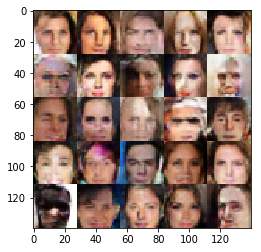

Epoch 10/10... Discriminator Loss: 1.3822... Generator Loss: 0.7614
Epoch 10/10... Discriminator Loss: 1.2549... Generator Loss: 0.7409
Epoch 10/10... Discriminator Loss: 1.3631... Generator Loss: 0.8328
Epoch 10/10... Discriminator Loss: 1.2145... Generator Loss: 0.8315
Epoch 10/10... Discriminator Loss: 1.1484... Generator Loss: 0.8254
Epoch 10/10... Discriminator Loss: 1.1425... Generator Loss: 0.8125
Epoch 10/10... Discriminator Loss: 1.2670... Generator Loss: 0.8277
Epoch 10/10... Discriminator Loss: 1.2137... Generator Loss: 0.8646
Epoch 10/10... Discriminator Loss: 1.2655... Generator Loss: 0.7314
Epoch 10/10... Discriminator Loss: 1.2437... Generator Loss: 0.7242


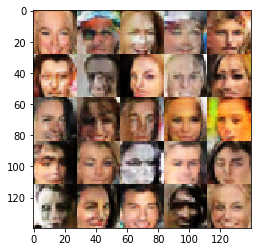

Epoch 10/10... Discriminator Loss: 1.1907... Generator Loss: 0.9169
Epoch 10/10... Discriminator Loss: 1.2465... Generator Loss: 0.7896
Epoch 10/10... Discriminator Loss: 1.2675... Generator Loss: 0.9993
Epoch 10/10... Discriminator Loss: 1.2609... Generator Loss: 0.7248
Epoch 10/10... Discriminator Loss: 1.2593... Generator Loss: 0.8353
Epoch 10/10... Discriminator Loss: 1.2883... Generator Loss: 0.7160
Epoch 10/10... Discriminator Loss: 1.2745... Generator Loss: 0.7119
Epoch 10/10... Discriminator Loss: 1.2893... Generator Loss: 0.8010
Epoch 10/10... Discriminator Loss: 1.1611... Generator Loss: 0.8645
Epoch 10/10... Discriminator Loss: 1.1016... Generator Loss: 0.9211


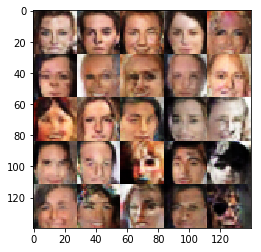

Epoch 10/10... Discriminator Loss: 1.4552... Generator Loss: 0.6914
Epoch 10/10... Discriminator Loss: 1.0903... Generator Loss: 0.9946
Epoch 10/10... Discriminator Loss: 1.3328... Generator Loss: 0.8401
Epoch 10/10... Discriminator Loss: 1.2554... Generator Loss: 0.9675
Epoch 10/10... Discriminator Loss: 1.2127... Generator Loss: 0.8341
Epoch 10/10... Discriminator Loss: 1.1641... Generator Loss: 0.9514
Epoch 10/10... Discriminator Loss: 1.2158... Generator Loss: 1.0222
Epoch 10/10... Discriminator Loss: 1.2941... Generator Loss: 0.7178
Epoch 10/10... Discriminator Loss: 1.2601... Generator Loss: 0.8176
Epoch 10/10... Discriminator Loss: 1.1320... Generator Loss: 0.8561


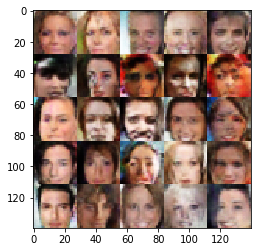

Epoch 10/10... Discriminator Loss: 1.1545... Generator Loss: 0.8905
Epoch 10/10... Discriminator Loss: 1.2966... Generator Loss: 0.7557
Epoch 10/10... Discriminator Loss: 1.4154... Generator Loss: 0.8579
Epoch 10/10... Discriminator Loss: 1.2966... Generator Loss: 0.9284
Epoch 10/10... Discriminator Loss: 1.2389... Generator Loss: 0.8227
Epoch 10/10... Discriminator Loss: 1.2659... Generator Loss: 0.9119
Epoch 10/10... Discriminator Loss: 1.1610... Generator Loss: 1.0002
Epoch 10/10... Discriminator Loss: 1.1476... Generator Loss: 1.0651
Epoch 10/10... Discriminator Loss: 1.2873... Generator Loss: 0.7395
Epoch 10/10... Discriminator Loss: 1.1925... Generator Loss: 0.8987


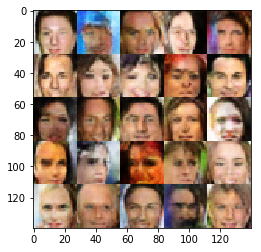

Epoch 10/10... Discriminator Loss: 1.2323... Generator Loss: 0.7332
Epoch 10/10... Discriminator Loss: 1.3400... Generator Loss: 0.6367
Epoch 10/10... Discriminator Loss: 1.4092... Generator Loss: 0.8696
Epoch 10/10... Discriminator Loss: 1.1701... Generator Loss: 0.9100
Epoch 10/10... Discriminator Loss: 1.2014... Generator Loss: 0.7690
Epoch 10/10... Discriminator Loss: 1.2273... Generator Loss: 0.7360
Epoch 10/10... Discriminator Loss: 1.1933... Generator Loss: 0.8096
Epoch 10/10... Discriminator Loss: 1.1641... Generator Loss: 0.7840
Epoch 10/10... Discriminator Loss: 1.2777... Generator Loss: 0.6835
Epoch 10/10... Discriminator Loss: 1.2478... Generator Loss: 0.7799


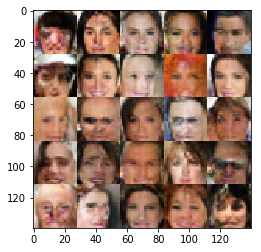

Epoch 10/10... Discriminator Loss: 1.2616... Generator Loss: 1.0424
Epoch 10/10... Discriminator Loss: 1.2487... Generator Loss: 0.8068
Epoch 10/10... Discriminator Loss: 1.3071... Generator Loss: 0.8045
Epoch 10/10... Discriminator Loss: 1.3137... Generator Loss: 0.7451
Epoch 10/10... Discriminator Loss: 1.1784... Generator Loss: 0.9014
Epoch 10/10... Discriminator Loss: 1.4767... Generator Loss: 0.6992
Epoch 10/10... Discriminator Loss: 1.1492... Generator Loss: 0.9702
Epoch 10/10... Discriminator Loss: 1.2513... Generator Loss: 0.8254
Epoch 10/10... Discriminator Loss: 1.2862... Generator Loss: 0.7312
Epoch 10/10... Discriminator Loss: 1.1570... Generator Loss: 0.9599


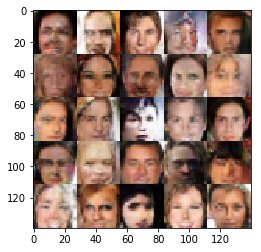

Epoch 10/10... Discriminator Loss: 1.2623... Generator Loss: 0.7989
Epoch 10/10... Discriminator Loss: 1.3123... Generator Loss: 0.7920
Epoch 10/10... Discriminator Loss: 1.1399... Generator Loss: 1.0026
Epoch 10/10... Discriminator Loss: 1.3109... Generator Loss: 0.8272
Epoch 10/10... Discriminator Loss: 1.3110... Generator Loss: 0.7778
Epoch 10/10... Discriminator Loss: 1.1904... Generator Loss: 0.8042
Epoch 10/10... Discriminator Loss: 1.2093... Generator Loss: 0.9424
Epoch 10/10... Discriminator Loss: 1.2996... Generator Loss: 0.7965
Epoch 10/10... Discriminator Loss: 1.2148... Generator Loss: 0.9444
Epoch 10/10... Discriminator Loss: 1.2191... Generator Loss: 0.7693


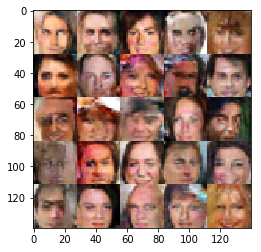

Epoch 10/10... Discriminator Loss: 1.1359... Generator Loss: 0.8774
Epoch 10/10... Discriminator Loss: 1.2697... Generator Loss: 0.7695
Epoch 10/10... Discriminator Loss: 1.4152... Generator Loss: 0.7040
Epoch 10/10... Discriminator Loss: 1.2058... Generator Loss: 0.8656
Epoch 10/10... Discriminator Loss: 1.2466... Generator Loss: 0.7984
Epoch 10/10... Discriminator Loss: 1.2135... Generator Loss: 0.9134
Epoch 10/10... Discriminator Loss: 1.2003... Generator Loss: 0.8198
Epoch 10/10... Discriminator Loss: 1.3446... Generator Loss: 0.9016
Epoch 10/10... Discriminator Loss: 1.2413... Generator Loss: 0.9080
Epoch 10/10... Discriminator Loss: 1.2635... Generator Loss: 0.8202


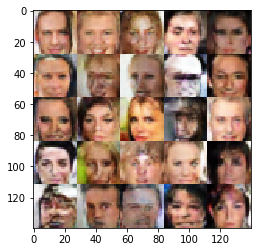

Epoch 10/10... Discriminator Loss: 1.0936... Generator Loss: 0.9253
Epoch 10/10... Discriminator Loss: 1.2691... Generator Loss: 0.8255
Epoch 10/10... Discriminator Loss: 1.2278... Generator Loss: 0.8419
Epoch 10/10... Discriminator Loss: 1.2062... Generator Loss: 0.8343
Epoch 10/10... Discriminator Loss: 1.2980... Generator Loss: 0.7010
Epoch 10/10... Discriminator Loss: 1.2206... Generator Loss: 0.7382
Epoch 10/10... Discriminator Loss: 1.2264... Generator Loss: 0.7935
Epoch 10/10... Discriminator Loss: 1.2278... Generator Loss: 0.7903
Epoch 10/10... Discriminator Loss: 1.3362... Generator Loss: 0.7096
Epoch 10/10... Discriminator Loss: 1.3132... Generator Loss: 0.7077


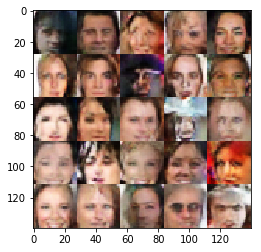

Epoch 10/10... Discriminator Loss: 1.2748... Generator Loss: 0.7436
Epoch 10/10... Discriminator Loss: 1.2444... Generator Loss: 0.9257
Epoch 10/10... Discriminator Loss: 1.0729... Generator Loss: 1.0608
Epoch 10/10... Discriminator Loss: 1.1568... Generator Loss: 0.8460
Epoch 10/10... Discriminator Loss: 1.3665... Generator Loss: 0.7639
Epoch 10/10... Discriminator Loss: 1.2461... Generator Loss: 0.8738
Epoch 10/10... Discriminator Loss: 1.3032... Generator Loss: 0.9251
Epoch 10/10... Discriminator Loss: 1.5115... Generator Loss: 0.4946
Epoch 10/10... Discriminator Loss: 1.1011... Generator Loss: 0.9537
Epoch 10/10... Discriminator Loss: 1.2064... Generator Loss: 0.8294


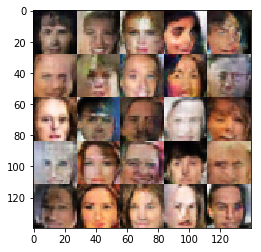

Epoch 10/10... Discriminator Loss: 1.0240... Generator Loss: 1.1691
Epoch 10/10... Discriminator Loss: 1.2096... Generator Loss: 0.8394
Epoch 10/10... Discriminator Loss: 1.2867... Generator Loss: 0.7852
Epoch 10/10... Discriminator Loss: 1.2312... Generator Loss: 0.7774
Epoch 10/10... Discriminator Loss: 1.3159... Generator Loss: 0.7138
Epoch 10/10... Discriminator Loss: 1.1751... Generator Loss: 0.8624
Epoch 10/10... Discriminator Loss: 1.1574... Generator Loss: 0.9463
Epoch 10/10... Discriminator Loss: 1.5197... Generator Loss: 0.7763
Epoch 10/10... Discriminator Loss: 1.3509... Generator Loss: 0.6863
Epoch 10/10... Discriminator Loss: 1.0334... Generator Loss: 0.9112


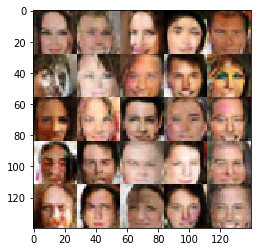

Epoch 10/10... Discriminator Loss: 1.3353... Generator Loss: 0.7311
Epoch 10/10... Discriminator Loss: 1.2328... Generator Loss: 0.9769
Epoch 10/10... Discriminator Loss: 1.1937... Generator Loss: 0.8182
Epoch 10/10... Discriminator Loss: 1.3273... Generator Loss: 0.6371
Epoch 10/10... Discriminator Loss: 1.1517... Generator Loss: 0.7849
Epoch 10/10... Discriminator Loss: 1.1649... Generator Loss: 0.8438
Epoch 10/10... Discriminator Loss: 1.3678... Generator Loss: 0.7023
Epoch 10/10... Discriminator Loss: 1.2374... Generator Loss: 0.7073
Epoch 10/10... Discriminator Loss: 1.3349... Generator Loss: 0.6926
Epoch 10/10... Discriminator Loss: 1.3891... Generator Loss: 0.6516


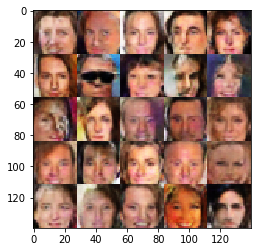

Epoch 10/10... Discriminator Loss: 1.2067... Generator Loss: 0.8409
Epoch 10/10... Discriminator Loss: 1.3157... Generator Loss: 0.8082
Epoch 10/10... Discriminator Loss: 1.0440... Generator Loss: 1.0359
Epoch 10/10... Discriminator Loss: 1.1310... Generator Loss: 0.8716
Epoch 10/10... Discriminator Loss: 1.1126... Generator Loss: 1.0257
Epoch 10/10... Discriminator Loss: 1.3678... Generator Loss: 0.6511
Epoch 10/10... Discriminator Loss: 1.3288... Generator Loss: 0.7369
Epoch 10/10... Discriminator Loss: 1.2562... Generator Loss: 0.9308
Epoch 10/10... Discriminator Loss: 1.0700... Generator Loss: 1.0157
Epoch 10/10... Discriminator Loss: 1.2442... Generator Loss: 0.7982


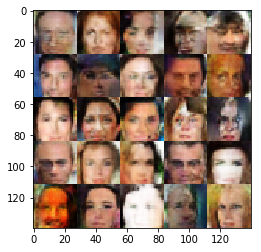

Epoch 10/10... Discriminator Loss: 1.0234... Generator Loss: 1.0284
Epoch 10/10... Discriminator Loss: 1.2377... Generator Loss: 0.8371
Epoch 10/10... Discriminator Loss: 1.2229... Generator Loss: 0.7763
Epoch 10/10... Discriminator Loss: 1.1975... Generator Loss: 0.8990
Epoch 10/10... Discriminator Loss: 1.1039... Generator Loss: 0.8447
Epoch 10/10... Discriminator Loss: 1.2778... Generator Loss: 0.7895
Epoch 10/10... Discriminator Loss: 1.1130... Generator Loss: 0.9860
Epoch 10/10... Discriminator Loss: 1.2867... Generator Loss: 0.7527
Epoch 10/10... Discriminator Loss: 1.3099... Generator Loss: 0.7367
Epoch 10/10... Discriminator Loss: 1.2630... Generator Loss: 0.7758


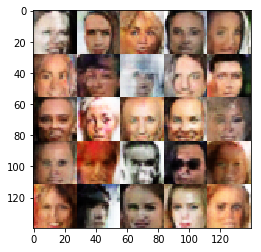

Epoch 10/10... Discriminator Loss: 1.1948... Generator Loss: 0.9074
Epoch 10/10... Discriminator Loss: 1.0264... Generator Loss: 1.0186
Epoch 10/10... Discriminator Loss: 1.1712... Generator Loss: 1.0994
Epoch 10/10... Discriminator Loss: 1.1929... Generator Loss: 0.8546
Epoch 10/10... Discriminator Loss: 1.2731... Generator Loss: 0.8551
Epoch 10/10... Discriminator Loss: 1.2064... Generator Loss: 0.8755
Epoch 10/10... Discriminator Loss: 1.1019... Generator Loss: 0.9612
Epoch 10/10... Discriminator Loss: 1.2700... Generator Loss: 0.8084
Epoch 10/10... Discriminator Loss: 1.1240... Generator Loss: 0.9372
Epoch 10/10... Discriminator Loss: 1.1443... Generator Loss: 0.8119


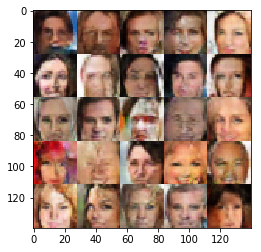

Epoch 10/10... Discriminator Loss: 1.1986... Generator Loss: 1.1520
Epoch 10/10... Discriminator Loss: 1.1202... Generator Loss: 0.8718
Epoch 10/10... Discriminator Loss: 1.2874... Generator Loss: 0.8406
Epoch 10/10... Discriminator Loss: 1.2713... Generator Loss: 0.6990
Epoch 10/10... Discriminator Loss: 1.1554... Generator Loss: 0.9593
Epoch 10/10... Discriminator Loss: 1.2377... Generator Loss: 0.6847
Epoch 10/10... Discriminator Loss: 1.1062... Generator Loss: 1.0104
Epoch 10/10... Discriminator Loss: 1.0709... Generator Loss: 0.9462
Epoch 10/10... Discriminator Loss: 1.2591... Generator Loss: 0.6863
Epoch 10/10... Discriminator Loss: 1.1354... Generator Loss: 0.9402


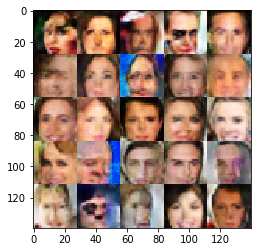

Epoch 10/10... Discriminator Loss: 1.2786... Generator Loss: 0.7834
Epoch 10/10... Discriminator Loss: 1.1903... Generator Loss: 1.0013
Epoch 10/10... Discriminator Loss: 1.2539... Generator Loss: 0.8048
Epoch 10/10... Discriminator Loss: 1.2436... Generator Loss: 0.7693
Epoch 10/10... Discriminator Loss: 1.2869... Generator Loss: 0.7661
Epoch 10/10... Discriminator Loss: 1.2492... Generator Loss: 0.7932
Epoch 10/10... Discriminator Loss: 1.1445... Generator Loss: 0.8897
Epoch 10/10... Discriminator Loss: 1.1549... Generator Loss: 0.8627
Epoch 10/10... Discriminator Loss: 1.1700... Generator Loss: 0.7923
Epoch 10/10... Discriminator Loss: 1.1708... Generator Loss: 0.8545


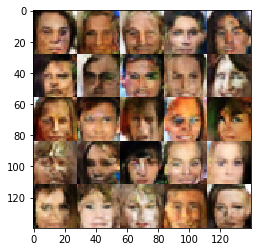

Epoch 10/10... Discriminator Loss: 1.1420... Generator Loss: 0.9485
Epoch 10/10... Discriminator Loss: 1.0931... Generator Loss: 0.8852
Epoch 10/10... Discriminator Loss: 1.2993... Generator Loss: 0.7965
Epoch 10/10... Discriminator Loss: 1.1808... Generator Loss: 0.7940
Epoch 10/10... Discriminator Loss: 1.2948... Generator Loss: 0.8602
Epoch 10/10... Discriminator Loss: 1.0727... Generator Loss: 1.0863
Epoch 10/10... Discriminator Loss: 1.2113... Generator Loss: 0.8322
Epoch 10/10... Discriminator Loss: 1.1262... Generator Loss: 0.8957
Epoch 10/10... Discriminator Loss: 1.1256... Generator Loss: 0.9401
Epoch 10/10... Discriminator Loss: 1.1162... Generator Loss: 1.0560


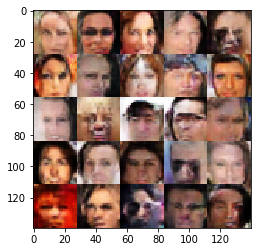

Epoch 10/10... Discriminator Loss: 1.0801... Generator Loss: 0.9580
Epoch 10/10... Discriminator Loss: 1.1960... Generator Loss: 0.8832
Epoch 10/10... Discriminator Loss: 1.3812... Generator Loss: 0.6454
Epoch 10/10... Discriminator Loss: 1.0637... Generator Loss: 0.9199
Epoch 10/10... Discriminator Loss: 1.3521... Generator Loss: 0.6940
Epoch 10/10... Discriminator Loss: 1.1736... Generator Loss: 0.8225
Epoch 10/10... Discriminator Loss: 1.2830... Generator Loss: 0.7830
Epoch 10/10... Discriminator Loss: 1.2055... Generator Loss: 0.8039
Epoch 10/10... Discriminator Loss: 1.2164... Generator Loss: 0.8679
Epoch 10/10... Discriminator Loss: 1.0169... Generator Loss: 0.9767


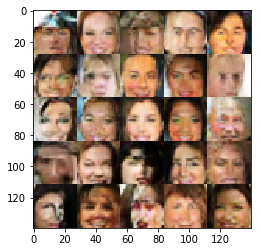

Epoch 10/10... Discriminator Loss: 1.3632... Generator Loss: 0.8193
Epoch 10/10... Discriminator Loss: 0.9824... Generator Loss: 1.1346
Epoch 10/10... Discriminator Loss: 1.2483... Generator Loss: 0.8046
Epoch 10/10... Discriminator Loss: 1.1675... Generator Loss: 0.7747
Epoch 10/10... Discriminator Loss: 1.3071... Generator Loss: 0.7045
Epoch 10/10... Discriminator Loss: 1.1542... Generator Loss: 0.8372
Epoch 10/10... Discriminator Loss: 1.1742... Generator Loss: 1.0133
Epoch 10/10... Discriminator Loss: 1.1161... Generator Loss: 1.0113
Epoch 10/10... Discriminator Loss: 1.1673... Generator Loss: 0.7500
Epoch 10/10... Discriminator Loss: 1.3799... Generator Loss: 0.6311


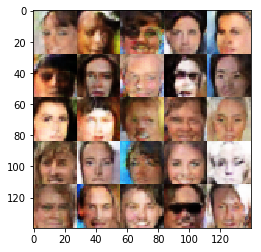

Epoch 10/10... Discriminator Loss: 1.3239... Generator Loss: 0.8516
Epoch 10/10... Discriminator Loss: 1.0339... Generator Loss: 0.9609
Epoch 10/10... Discriminator Loss: 1.1794... Generator Loss: 0.7782
Epoch 10/10... Discriminator Loss: 1.2666... Generator Loss: 0.8298
Epoch 10/10... Discriminator Loss: 1.2079... Generator Loss: 1.0703


In [16]:
batch_size = 64
z_dim = 256
learning_rate = 0.001
beta1 = 0.4


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
epochs = 10

celeba_dataset = helper.Dataset('celeba', glob(os.path.join(data_dir, 'img_align_celeba/*.jpg')))
with tf.Graph().as_default():
    losses = train(epochs, batch_size, z_dim, learning_rate, beta1, celeba_dataset.get_batches, celeba_dataset.shape, celeba_dataset.image_mode)

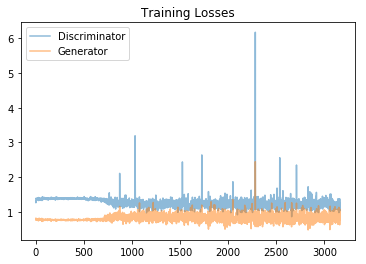

In [17]:
fig, ax = plt.subplots()
losses = np.array(losses)
plt.plot(losses.T[0], label='Discriminator', alpha=0.5)
plt.plot(losses.T[1], label='Generator', alpha=0.5)
plt.title("Training Losses")
plt.legend()

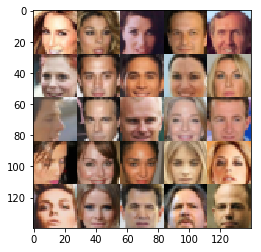

In [18]:
mnist_images = helper.get_batch(glob(os.path.join(data_dir, 'img_align_celeba/*.jpg'))[:show_n_images], 28, 28, 'RGB')
helper.images_square_grid(mnist_images, 'RGB')
pyplot.imshow(helper.images_square_grid(mnist_images, 'RGB'))

### Submitting This Project
When submitting this project, make sure to run all the cells before saving the notebook. Save the notebook file as "dlnd_face_generation.ipynb" and save it as a HTML file under "File" -> "Download as". Include the "helper.py" and "problem_unittests.py" files in your submission.